##Deteccion de Fraudes

Este conjunto de datos ofrece una visión detallada del comportamiento transaccional y los patrones de actividad financiera, ideal para explorar la detección de fraudes y la identificación de anomalías. Contiene 2512 muestras de datos de transacciones, que abarcan diversos atributos de transacciones, datos demográficos de clientes y patrones de uso. Cada entrada ofrece información completa sobre el comportamiento de las transacciones, lo que permite el análisis para aplicaciones de seguridad financiera y detección de fraudes.

Características principales:

1. TransactionID: Identificador alfanumérico único para cada transacción.
2. AccountID: Identificador único para cada cuenta, con múltiples transacciones por cuenta.
3. TransactionAmount: valor monetario de cada transacción, desde pequeños gastos cotidianos hasta compras más grandes.
4. TransactionDate: Marca de tiempo de cada transacción, capturando fecha y hora.
5. TransactionType: Campo categórico que indica transacciones de 'Crédito' o 'Débito'.
6. Location: Ubicación geográfica de la transacción, representada por nombres de ciudades de EE. UU.
7. DeviceID: Identificador alfanumérico de los dispositivos utilizados para realizar la transacción.
8. IPAdress: Dirección IPv4 asociada a la transacción, con cambios ocasionales para algunas cuentas.
9. MerchantID: Identificador único para comerciantes, que muestra los comerciantes preferidos y atípicos para cada cuenta.
10. AccountBalance: Saldo en la cuenta post-transacción, con correlaciones lógicas basadas en el tipo de transacción y monto.
11. PreviousTransactionDate: Marca de tiempo de la última transacción de la cuenta, que ayuda a calcular la frecuencia de las transacciones.
12. Channel: Canal a través del cual se realizó la transacción (ej. Online, Cajero Automático, Sucursal).
13. CustomerAge: Edad del titular de la cuenta, con agrupaciones lógicas basadas en la ocupación.
14. CustomerOccupation: Ocupación del titular de la cuenta (por ejemplo, médico, ingeniero, estudiante, jubilado), que refleja patrones de ingresos.
15. TransactionDuration: Duración de la transacción en segundos, que varía según el tipo de transacción.
16. LoginAttempts: Número de intentos de inicio de sesión antes de la transacción, los valores más altos indican posibles anomalías.
Este conjunto de datos es ideal para científicos de datos, analistas financieros e investigadores que buscan analizar patrones transaccionales, detectar fraudes y crear modelos predictivos para aplicaciones de seguridad financiera. El conjunto de datos fue diseñado para tareas de aprendizaje automático y análisis de patrones y no está pensado como fuente de datos principal para publicaciones académicas.

https://www.kaggle.com/datasets/valakhorasani/bank-transaction-dataset-for-fraud-detection

OBJETIVO:
Detección de fraudes

1. Detectar comportamientos anómalos o inusuales en las transacciones del dataset que puedan ser potenciales fraudes.

MOTIVACION

En un entorno financiero cada vez más complejo, la detección de fraudes es un pilar clave para garantizar la estabilidad de las instituciones bancarias. Los fraudes no solo representan pérdidas económicas, sino que también afectan la confianza de nuestros clientes y la reputación del banco.

La tecnología y el análisis de datos avanzados nos brindan las herramientas necesarias para identificar patrones sospechosos y tomar decisiones informadas. El uso de modelos predictivos y machine learning permite adelantarnos a los fraudes, bloqueándolos antes de que afecten nuestras operaciones. Esto no solo mejora la seguridad, sino que optimiza los recursos y asegura la conformidad con las regulaciones vigentes.

AUDIENCIA

Esta sesión está dirigida a:

- 🔹 Analistas de Riesgo y Fraude
- 🔹 Expertos en Ciberseguridad Financiera
- 🔹 Equipos de Auditoría Interna
- 🔹 Especialistas en Inteligencia de Datos y Machine Learning
- 🔹 Gerentes y Directivos de Gestión de Riesgos
- 🔹 Profesionales de Cumplimiento Regulatorio (Compliance)

PREGUNTAS A RESPONDER
- ¿Los canales online con montos altos y múltiples intentos fallidos de inicio de sesión presentan un mayor riesgo de fraude en comparación con otros canales?

- ¿Un alto número de intentos fallidos de inicio de sesión seguido de transacciones grandes y saldo casi vacío indica un posible acceso no autorizado?

- ¿Las transacciones de crédito/débito con montos extremadamente altos en comparación con la media pueden ser indicios de fraude?

- ¿Las transacciones de alto monto realizadas por personas muy jóvenes o ancianas presentan un mayor riesgo de fraude?

- ¿Las compras de montos muy altos realizadas por estudiantes o jubilados pueden ser consideradas sospechosas?

-  ¿Podría indicar fraude una IP con un monto total de transacciones significativamente mayor que el resto, sugiriendo múltiples compras de alto valor?

- Podria un Device que tenga montos altos de transacciones significar un fraude, si se realizan multiples compras de un mismo dispositivo?

- Podrian las transacciones de grandes montos en ubicaciones inusuales ser un indicio de fraude?

🔍 Variables relevantes para análisis no supervisado de fraude:
- TransactionAmount 💰: clave para detectar anomalías en montos.

- TransactionDuration ⏱️: podría revelar patrones inusuales en duración.

- LoginAttempts 🔐: más de un intento podría ser sospechoso.

- AccountBalance 🏦: balances muy bajos o inconsistentes pueden ser indicativos.

- CustomerAge y CustomerOccupation 👤: pueden ayudar a detectar transacciones atípicas para ciertos perfiles.

##Carga de Datos

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
import matplotlib.cm as cm
import matplotlib.colors as mcolors
import scipy

In [2]:
df = pd.read_csv('https://raw.githubusercontent.com/gabrielagonzalezliliana/Deteccion_de_Fraudes/refs/heads/main/bank_transactions_data_2%204.csv')
df

,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,CustomerAge,CustomerOccupation,TransactionDuration,LoginAttempts,AccountBalance,PreviousTransactionDate
0,TX000001,AC00128,14.09,2023-04-11 16:29:14,Debit,San Diego,D000380,162.198.218.92,M015,ATM,70,Doctor,81,1,5112.21,2024-11-04 08:08:08
1,TX000002,AC00455,376.24,2023-06-27 16:44:19,Debit,Houston,D000051,13.149.61.4,M052,ATM,68,Doctor,141,1,13758.91,2024-11-04 08:09:35
2,TX000003,AC00019,126.29,2023-07-10 18:16:08,Debit,Mesa,D000235,215.97.143.157,M009,Online,19,Student,56,1,1122.35,2024-11-04 08:07:04
3,TX000004,AC00070,184.50,2023-05-05 16:32:11,Debit,Raleigh,D000187,200.13.225.150,M002,Online,26,Student,25,1,8569.06,2024-11-04 08:09:06
4,TX000005,AC00411,13.45,2023-10-16 17:51:24,Credit,Atlanta,D000308,65.164.3.100,M091,Online,26,Student,198,1,7429.40,2024-11-04 08:06:39
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2507,TX002508,AC00297,856.21,2023-04-26 17:09:36,Credit,Colorado Springs,D000625,21.157.41.17,M072,Branch,33,Doctor,109,1,12690.79,2024-11-04 08:11:29
2508,TX002509,AC00322,251.54,2023-03-22 17:36:48,Debit,Tucson,D000410,49.174.157.140,M029,Branch,48,Doctor,177,1,254.75,2024-11-04 08:11:42
2509,TX002510,AC00095,28.63,2023-08-21 17:08:50,Debit,San Diego,D000095,58.1.27.124,M087,Branch,56,Retired,146,1,3382.91,2024-11-04 08:08:39
2510,TX002511,AC00118,185.97,2023-02-24 16:24:46,Debit,Denver,D000634,21.190.11.223,M041,Online,23,Student,19,1,1776.91,2024-11-04 08:12:22


In [3]:
df1 = df.copy()
df1

,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,CustomerAge,CustomerOccupation,TransactionDuration,LoginAttempts,AccountBalance,PreviousTransactionDate
0,TX000001,AC00128,14.09,2023-04-11 16:29:14,Debit,San Diego,D000380,162.198.218.92,M015,ATM,70,Doctor,81,1,5112.21,2024-11-04 08:08:08
1,TX000002,AC00455,376.24,2023-06-27 16:44:19,Debit,Houston,D000051,13.149.61.4,M052,ATM,68,Doctor,141,1,13758.91,2024-11-04 08:09:35
2,TX000003,AC00019,126.29,2023-07-10 18:16:08,Debit,Mesa,D000235,215.97.143.157,M009,Online,19,Student,56,1,1122.35,2024-11-04 08:07:04
3,TX000004,AC00070,184.50,2023-05-05 16:32:11,Debit,Raleigh,D000187,200.13.225.150,M002,Online,26,Student,25,1,8569.06,2024-11-04 08:09:06
4,TX000005,AC00411,13.45,2023-10-16 17:51:24,Credit,Atlanta,D000308,65.164.3.100,M091,Online,26,Student,198,1,7429.40,2024-11-04 08:06:39
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2507,TX002508,AC00297,856.21,2023-04-26 17:09:36,Credit,Colorado Springs,D000625,21.157.41.17,M072,Branch,33,Doctor,109,1,12690.79,2024-11-04 08:11:29
2508,TX002509,AC00322,251.54,2023-03-22 17:36:48,Debit,Tucson,D000410,49.174.157.140,M029,Branch,48,Doctor,177,1,254.75,2024-11-04 08:11:42
2509,TX002510,AC00095,28.63,2023-08-21 17:08:50,Debit,San Diego,D000095,58.1.27.124,M087,Branch,56,Retired,146,1,3382.91,2024-11-04 08:08:39
2510,TX002511,AC00118,185.97,2023-02-24 16:24:46,Debit,Denver,D000634,21.190.11.223,M041,Online,23,Student,19,1,1776.91,2024-11-04 08:12:22


##Exploracion de Datos

In [4]:
df1.shape

(2512, 16)

In [5]:
df1.describe().round(2)

,TransactionAmount,CustomerAge,TransactionDuration,LoginAttempts,AccountBalance
count,2512.00,2512.00,2512.00,2512.00,2512.00
mean,297.59,44.67,119.64,1.12,5114.30
std,291.95,17.79,69.96,0.60,3900.94
min,0.26,18.00,10.00,1.00,101.25
25%,81.89,27.00,63.00,1.00,1504.37
50%,211.14,45.00,112.50,1.00,4735.51
75%,414.53,59.00,161.00,1.00,7678.82
max,1919.11,80.00,300.00,5.00,14977.99


In [6]:
df1.describe(include='object').T

,count,unique,top,freq
TransactionID,2512,2512,TX002496,1
AccountID,2512,495,AC00460,12
TransactionDate,2512,2512,2023-04-03 16:07:53,1
TransactionType,2512,2,Debit,1944
Location,2512,43,Fort Worth,70
DeviceID,2512,681,D000548,9
IP Address,2512,592,200.136.146.93,13
MerchantID,2512,100,M026,45
Channel,2512,3,Branch,868
CustomerOccupation,2512,4,Student,657


In [7]:
df1.columns

Index(['TransactionID', 'AccountID', 'TransactionAmount', 'TransactionDate',
       'TransactionType', 'Location', 'DeviceID', 'IP Address', 'MerchantID',
       'Channel', 'CustomerAge', 'CustomerOccupation', 'TransactionDuration',
       'LoginAttempts', 'AccountBalance', 'PreviousTransactionDate'],
      dtype='object')

In [8]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2512 entries, 0 to 2511
Data columns (total 16 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   TransactionID            2512 non-null   object 
 1   AccountID                2512 non-null   object 
 2   TransactionAmount        2512 non-null   float64
 3   TransactionDate          2512 non-null   object 
 4   TransactionType          2512 non-null   object 
 5   Location                 2512 non-null   object 
 6   DeviceID                 2512 non-null   object 
 7   IP Address               2512 non-null   object 
 8   MerchantID               2512 non-null   object 
 9   Channel                  2512 non-null   object 
 10  CustomerAge              2512 non-null   int64  
 11  CustomerOccupation       2512 non-null   object 
 12  TransactionDuration      2512 non-null   int64  
 13  LoginAttempts            2512 non-null   int64  
 14  AccountBalance          

In [9]:
df1.isnull().sum()

,0
TransactionID,0
AccountID,0
TransactionAmount,0
TransactionDate,0
TransactionType,0
Location,0
DeviceID,0
IP Address,0
MerchantID,0
Channel,0


In [10]:
df1.duplicated().sum()

np.int64(0)

In [11]:
df1.nunique()

,0
TransactionID,2512
AccountID,495
TransactionAmount,2455
TransactionDate,2512
TransactionType,2
Location,43
DeviceID,681
IP Address,592
MerchantID,100
Channel,3


In [12]:
df1.dtypes

,0
TransactionID,object
AccountID,object
TransactionAmount,float64
TransactionDate,object
TransactionType,object
Location,object
DeviceID,object
IP Address,object
MerchantID,object
Channel,object


#Limpieza de datos

In [13]:
#convierto fechas a time
df1['TransactionDate'] = pd.to_datetime(df['TransactionDate'], format='%Y-%m-%d %H:%M:%S')
df1['PreviousTransactionDate'] = pd.to_datetime(df['PreviousTransactionDate'], format='%Y-%m-%d %H:%M:%S')

In [14]:
print(df1['TransactionDate'].dtype)
print(df1['PreviousTransactionDate'].dtype)

datetime64[ns]
datetime64[ns]


#EDA

In [15]:
!pip install summarytools

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 24.8 MB/s eta 0:00:00


In [16]:
from summarytools import dfSummary

In [17]:
dfSummary(df1)

No,Variable,Stats / Values,Freqs / (% of Valid),Graph,Missing
1,TransactionID[object],1. TX0024962. TX0024953. TX0024944. TX0024935. TX0024926. TX0024917. TX0024908. TX0024899. TX00248810. TX00248711. other,"1 (0.0%)1 (0.0%)1 (0.0%)1 (0.0%)1 (0.0%)1 (0.0%)1 (0.0%)1 (0.0%)1 (0.0%)1 (0.0%)2,502 (99.6%)","<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAJsAAAD+CAYAAAAtWHdlAAAAOnRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjEwLjAsIGh0dHBzOi8vbWF0cGxvdGxpYi5vcmcvlHJYcgAAAAlwSFlzAAAPYQAAD2EBqD+naQAAA0JJREFUeJzt3MFpG2EURtE3QiT2RkIIVELSg4rINh2riDRhpEXieOMsgkvIHZicU8G/uPAQzKfl/f19oLBb+wH8P8RGRmxkxEZGbGTERkZsZMRGRmxkxEZmtyzL12VZntZ+CNu3m5kvM/N57Yewfc4oGbGRERsZsZERGxmxkREbGbGRERsZsZERGxmxkREbGbGRERsZsZHZzcyPmfm99kPYvsW/GFFxRsmIjYx1FRnrKjLOKBmxkREbGbGRERsZsZERGxmxkREbGbGRERsZsZERGxmxkREbGYMXMgYvZJxRMmIjY/BCxuCFjDNKRmxkxEZGbGTERkZsZMRGRmxkxEZGbGTERkZsZMRGRmxkxEbG4IWMwQsZZ5SM2MiIjYx1FRnrKjLOKBmxkREbGbGRERsZsZERGxmxkREbGbGRERsZsZERGxmxkREbGesqMtZVZJxRMmIjY/BCxuCFjDNKRmxkxEZGbGTERkZsZMRGRmxkxEZGbGTERkZsZMRGRmxkxEbG4IWMwQsZZ5SM2MgYvJAxeCHjjJIRGxmxkREbGbGRERsZsZERGxmxkREbGbGRERsZsZERGxmxkREbGesqMtZVZJxRMmIjY11FxrqKjDNKRmxkxEZGbGTERkZsZMRGRmxkxEZGbGTERkZsZMRGRmxkxEbG4IWMwQsZZ5SM2MgYvJAxeCHjjJIRGxmxkREbGbGRERsZsZERGxmxkREbGbGRERsZsZERGxmxkTF4IWPwQsYZJSM2MmIjY11FxrqKjDNKRmxkxEZGbGTERkZsZMRGRmxkxEZGbGTERkZsZMRGRmxkxEbGuoqMdRUZZ5SM2MgYvJAxeCHjjJIRGxmxkREbGbGRERsZsZERGxmxkREbGbGRERsZsZERGxmxkTF4IWPwQsYZJbPMzPPMfFr7IWze2/58Pn87HA6ntV/Ctj0ej5f94XA4Xa/XX8fj8XXtB7FN9/v96Xa7nfYzM8fj8fVyufxc+1Fs2rMfCGTERkZsZMRGRmxkxEZGbGTERkZsZMRGRmxkxEZGbGT2M38/AVn7IWzXR1/L+Xz+7uNJ/rXH4/His3Aqb9ZVZPxAICM2MmIjIzYyYiMjNjJiIyM2MmIj8wdFqVdsnnPGyQAAAABJRU5ErkJggg=="">",0(0.0%)
2,AccountID[object],1. AC004602. AC002023. AC003624. AC003635. AC004806. AC004567. AC002578. AC002259. AC0030410. AC0021911. other,"12 (0.5%)12 (0.5%)12 (0.5%)12 (0.5%)11 (0.4%)11 (0.4%)11 (0.4%)11 (0.4%)11 (0.4%)10 (0.4%)2,399 (95.5%)","<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAJsAAAD+CAYAAAAtWHdlAAAAOnRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjEwLjAsIGh0dHBzOi8vbWF0cGxvdGxpYi5vcmcvlHJYcgAAAAlwSFlzAAAPYQAAD2EBqD+naQAAA31JREFUeJzt3MFqE1EAhtGbEordTAiBPEweog/rQ+RtQsgsbOkmLowrTRWsXzCesxLczOJjMl7u7+J8Pg8oPNz6Afh/iI2M2MiIjYzYyIiNjNjIiI2M2MgsxhhPY4xxPp9fbvws3LnlZrN5HmOMxWLxWXD8TQ/TNK2naVqPMR5v/TDcN99sZMRGRmxkxEZGbGTERkZsZMRGRmxkxEZGbGTERkZsZMRGRmxkxEZmOc/z8fLnt5s+CXfPBoHMwn+ZRcWbjYx1FRnrKjKOPsiIjYzYyIiNjNjIiI2M2MiIjYzYyIiNjNjIiI2M2MiIjYzYyBi8kHEtnIzBCxlvNjIGL2QMXsg4+iAjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiI2PwQsa1cDIGL2R8s5HxM0rGuoqMdRUZ32xkxEZGbGTERkZsZMRGRmxkxEZGbGTERkZsZMRGRmxkxEZGbGSsq8i4Fk7GuoqMNxsZgxcyBi9kHH2QERsZsZERGxmxkREbGbGRERsZsZERGxmxkREbGbGRERsZsZExeCHjWjgZgxcy3mxkDF7IGLyQcfRBRmxkxEZGbGTERkZsZMRGRmxkxEZGbGTERkZsZMRGRmxkxEZGbGSsq8jYIJCxriLjzUbGuoqMdRUZRx9kxEZGbGTERkZsZMRGRmxkxEZGbGTERkZsZMRGRmxkxEZGbGQMXsi4Fk7G4IWMNxsZgxcyBi9kHH2QERsZsZERGxmxkREbGbGRERsZsZERGxmxkREbGbGRERsZsZExeCHjWjgZgxcyvtnI+BklY11FxrqKjG82MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYy1lVkXAsnY11FxpuNjMELGYMXMo4+yIiNjNjIiI2M2MiIjYzYyIiNjNjIiI2M2MiIjYzYyIiNjNjIGLyQcS2cjMELme9vNlfC+Shv134ll5vN5vmyQYA/Ns/z8dp4ajlN03q3272sVqvXWzwc9+N0On3a7/frw+HwOMb4MbYxxlitVq/b7fZL/nTco6drf+GcjYzYyIiNjNjIiI2M2MiIjYzYyIiNjNjIiI2M2MiIjcxyjG9XQ279IPz7ftXRcp7n436/X493robA77oMqH46nnItnI929Vq4wQsZ/0AgIzYyYiMjNjJiIyM2MmIjIzYyYiPzFZR1ECdHXRmlAAAAAElFTkSuQmCC"">",0(0.0%)
3,TransactionAmount[float64],Mean (sd) : 297.6 (291.9)min < med < max:0.3 < 211.1 < 1919.1IQR (CV) : 332.6 (1.0),"2,455 distinct values","<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAKoAAABGCAYAAABc8A97AAAAOnRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjEwLjAsIGh0dHBzOi8vbWF0cGxvdGxpYi5vcmcvlHJYcgAAAAlwSFlzAAAPYQAAD2EBqD+naQAAAmRJREFUeJzt3DFv2kAYh/H3CkEGWgMigs0rWwdGln6DftiuHSPBzLdASFYA4YaAkLuUqlLSAHeh9f/0/GZ8ZnhkdMj3urIsDai6D//7CwCXqJ/7gHOuaWYNz/X3ZVk+eV4L/PZmqM65Zr/f/5qmac9n8c1m8+ic+0asCHXuidpI07Q3mUyeOp3O7pqF1+t1Mp1Oe3meN8yMUBHk7E+/mVmn09kNBoMfHus3Pa4BXmAzBQmECgmECgmECgmECgmECgmECgmECgmECgmECgmECgmECgmECgmECgmECgmECgmECgmECgmECgmECgmECg

In [18]:
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

     \ 17.9 MB 28.7 MB/s 0:00:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 687.8/687.8 kB 39.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.3/43.3 kB 3.8 MB/s eta 0:00:00
  Created wheel for ydata-profiling: filename=ydata_profiling-0.0.dev0-py2.py3-none-any.whl size=400139 sha256=730249448306e31bad069a03911062cfaad59b60f90a1e6ab4ff6fe2df8f39e1
  Stored in directory: /tmp/pip-ephem-wheel-cache-2b69w_xf/wheels/85/5d/45/8a23c7b77d2023fbc37490b8902f7fdeff5614f65d6e08b6c4
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=53ee04a024a3c31b286d6037345873da22019643576cd17349221ad82f4fc755
  Stored in direc

In [19]:
from ydata_profiling import ProfileReport

In [20]:
#Install ydata-profiling
!pip install ydata-profiling
#Import ProfileReport
from ydata_profiling import ProfileReport

#Lectura del dataframe
url = 'https://raw.githubusercontent.com/gabrielagonzalezliliana/Deteccion_de_Fraudes/refs/heads/main/bank_transactions_data_2%204.csv'
data = pd.read_csv(url, sep = ",")
data.head()

# ... (rest of your code) ...

#Data Profiling
profile = ProfileReport(data,correlations={
            "auto": {"calculate": True},
            "pearson": {"calculate": True},
            "spearman": {"calculate": True},
            "kendall": {"calculate": True},
            "phi_k": {"calculate": True},
            "cramers": {"calculate": True},
        })
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 16/16 [00:00<00:00, 20.75it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#Analisis Univariado

##Distribucion de las Variables Cualitativas

###Tipo de Transacciones

In [21]:
df1['TransactionType'].value_counts()

,count
TransactionType,
Debit,1944
Credit,568


In [22]:
tipo_transaccion_cantidades = df1['TransactionType'].value_counts()

# Lista de colores personalizados que combinan bien entre sí
colores_combinados = ["#1976D2", "#26C6DA", "#7E57C2", "#FFA726", "#66BB6A", "#D81B60", "#8D6E63"]

fig = px.pie(values=tipo_transaccion_cantidades.values,
             names=tipo_transaccion_cantidades.index,
             title="Tipo de Transacciones",
             hole=0.3,
             color_discrete_sequence=colores_combinados)  # Colores combinados

# Configurar fondo negro
fig.update_layout(
    paper_bgcolor="black",   # Fondo de toda la figura
    plot_bgcolor="black",    # Fondo del área del gráfico
    font=dict(color="white") # Color del texto en blanco para mejor visibilidad
)

fig.show()

El gráfico muestra que las transacciones de débito son significativamente más frecuentes que las de crédito. El recuento de transacciones de débito es de aproximadamente 1944,(77.4%) mientras que las de crédito son aproximadamente 568(22.6%)

###Ocupacion de los clientes

In [23]:
ocupacion_clientes = df1['CustomerOccupation'].value_counts()
ocupacion_clientes

,count
CustomerOccupation,
Student,657
Doctor,631
Engineer,625
Retired,599


In [24]:
fig = px.pie(values=ocupacion_clientes.values,
             names=ocupacion_clientes.index,
             title="Ocupacion de los Clientes",
             hole= 0.3,
             color_discrete_sequence=colores_combinados)
# Configurar fondo negro
fig.update_layout(
    paper_bgcolor="black",   # Fondo de toda la figura
    plot_bgcolor="black",    # Fondo del área del gráfico
    font=dict(color="white") # Color del texto en blanco para mejor visibilidad
)
fig.show()


El grafico muestra una distribución  uniforme entre las cuatro ocupaciones de los clientes: médico, estudiante, jubilado e ingeniero. "Estudiante" y "Médico" parecen tener el mayor número de transacciones, con "Estudiante" ligeramente por delante.

###Canal de Transaccion

In [25]:
df1['Channel'].value_counts()

,count
Channel,
Branch,868
ATM,833
Online,811


In [26]:
canal_transacciones = df1['Channel'].value_counts()
fig = px.pie(values=canal_transacciones.values,
             names=canal_transacciones.index,
             title="Canal de Transacciones",
             hole=0.3,
             color_discrete_sequence=colores_combinados)
# Configurar fondo negro
fig.update_layout(
    paper_bgcolor="black",   # Fondo de toda la figura
    plot_bgcolor="black",    # Fondo del área del gráfico
    font=dict(color="white") # Color del texto en blanco para mejor visibilidad
)
fig.show()

El grafico muestran una distribución uniforme de las transacciones en los tres canales: cajero automático, en línea y sucursal.
Las transacciones en sucursal(Branch) parecen ser las más frecuentes, seguidas de las transacciones en cajero automático (ATM) y en línea(online). Sin embargo, la diferencia en el número de transacciones entre los canales no es muy significativa.

###Locacion de las transacciones

In [27]:
df1['Location'].value_counts()

,count
Location,
Fort Worth,70
Los Angeles,69
Oklahoma City,68
Charlotte,68
Philadelphia,67
Tucson,67
Omaha,65
Miami,64
Memphis,63


In [28]:
localidades_transacciones = df1['Location'].value_counts().head(10)
fig = px.bar(x=localidades_transacciones.index,
             y=localidades_transacciones.values,
             title="Cantidad de Transacciones por Top 10 Localidad",
             labels={'x': 'Localidad', 'y': 'Número de Transacciones'},
             text=localidades_transacciones.values,
             height=600,
             color_discrete_sequence=colores_combinados)  # Colores combinados

fig.update_traces(textposition='outside')
fig.update_layout(
    xaxis_tickangle=-45,
    paper_bgcolor="black",   # Fondo de toda la figura
    plot_bgcolor="black",    # Fondo del área del gráfico
    font=dict(color="white") # Color del texto en blanco para mejor visibilidad
)
fig.update_traces(textposition='outside')
fig.update_layout(xaxis_tickangle=-45)
fig.show()


In [29]:
localidades_monto_transaccion = df1.groupby('Location')['TransactionAmount'].agg(['count', 'mean', 'median'])
print(localidades_monto_transaccion.nlargest(10, 'count'))

               count        mean  median
Location                                
Fort Worth        70  296.810571  240.41
Los Angeles       69  285.155797  170.19
Charlotte         68  260.039118  185.15
Oklahoma City     68  319.353529  226.50
Philadelphia      67  290.586866  177.05
Tucson            67  305.369552  214.83
Omaha             65  283.143846  178.91
Miami             64  265.144219  168.07
Detroit           63  327.139048  235.40
Houston           63  308.200794  224.19


La distribución de las transacciones entre las 10 principales localidades es uniforme. Fort Worth registra el mayor número de transacciones entre las 10 ubicaciones principales, con 70 transacciones.

###Transacciones por id de comerciante

In [30]:
df1['MerchantID'].value_counts().head(10)

,count
MerchantID,
M026,45
M066,34
M028,33
M014,33
M065,33
M013,33
M070,32
M068,32
M001,32


In [31]:
top_comerciantes = df1['MerchantID'].value_counts().head(10)
fig = px.bar(x=top_comerciantes.index,
             y=top_comerciantes.values,
             title="Cantidad de Transacciones por Top 10 Comerciantes",
             labels={'x': 'Comerciante ID', 'y': 'Número de Transacciones'},
             text=top_comerciantes.values,
             height=600,
             color_discrete_sequence=colores_combinados)  # Colores combinados

fig.update_traces(textposition='outside')
fig.update_layout(
    xaxis_tickangle=-45,
    paper_bgcolor="black",   # Fondo de toda la figura
    plot_bgcolor="black",    # Fondo del área del gráfico
    font=dict(color="white") # Color del texto en blanco para mejor visibilidad
)
fig.update_traces(textposition='outside')
fig.update_layout(xaxis_tickangle=-45)
fig.show()

In [32]:
comerciante_monto_transaccion = df1.groupby('MerchantID')['TransactionAmount'].agg(['count', 'mean', 'median'])
print(comerciante_monto_transaccion.nlargest(10, 'count'))

            count        mean   median
MerchantID                            
M026           45  308.114444  185.990
M066           34  351.433824  244.210
M013           33  315.646970  236.810
M014           33  286.909091  256.800
M028           33  312.615758  180.940
M065           33  240.501818  166.550
M001           32  260.002500  145.850
M005           32  346.872813  275.325
M015           32  298.023438  171.250
M068           32  302.502187  269.905


El comercio con id M026, representa alrededor del 13,3 % de las transacciones,  registrando el mayor número de transacciones entre los 10 principales, con 45 transacciones.

##Distribucion de las Variables Cuantitativas

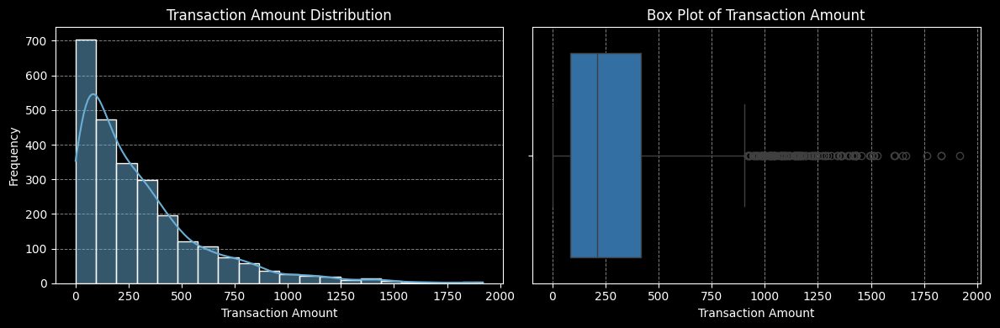


Resumen estadístico de Transaction Amount:
 count    2512.000000
mean      297.593778
std       291.946243
min         0.260000
25%        81.885000
50%       211.140000
75%       414.527500
max      1919.110000
Name: TransactionAmount, dtype: float64


In [33]:
colores = sns.color_palette("Blues", 3)

# Configuración del fondo negro
plt.style.use('dark_background')

# Crear los subgráficos
fig, axes = plt.subplots(1, 2, figsize=(12, 4))

# Histograma con KDE
sns.histplot(df1['TransactionAmount'], bins=20, kde=True, color=colores[1], ax=axes[0])
axes[0].set_title('Transaction Amount Distribution', color='white')
axes[0].set_xlabel('Transaction Amount', color='white')
axes[0].set_ylabel('Frequency', color='white')
axes[0].set_axisbelow(True)
axes[0].grid(axis='y', color='gray', linestyle='--', linewidth=0.7)

# Boxplot
sns.boxplot(x=df1['TransactionAmount'], color=colores[2], ax=axes[1])
axes[1].set_title('Box Plot of Transaction Amount', color='white')
axes[1].set_xlabel('Transaction Amount', color='white')
axes[1].set_axisbelow(True)
axes[1].grid(axis='x', color='gray', linestyle='--', linewidth=0.7)

# Asegurar que el texto y los gráficos tengan colores apropiados
for ax in axes:
    ax.tick_params(axis='both', colors='white')  # Colorear las etiquetas de los ejes
    ax.set_facecolor('black')  # Fondo negro para los ejes

# Ajustar el diseño y mostrar
plt.tight_layout()
plt.show()

# Resumen estadístico de 'TransactionAmount'
print(f'\nResumen estadístico de Transaction Amount:\n', df1['TransactionAmount'].describe())

In [34]:
scipy.stats.describe(df1['TransactionAmount'])

DescribeResult(nobs=2512, minmax=(np.float64(0.26), np.float64(1919.11)), mean=np.float64(297.5937778662421), variance=np.float64(85232.60902510876), skewness=np.float64(1.7390674727944568), kurtosis=np.float64(3.6333862764401044))

El histograma muestra  una distribución sesgada a la derecha. Esto significa que hay muchas transacciones pequeñas y algunas muy grandes. Este patrón es común en datos financieros, donde la mayoría de las transacciones son relativamente pequeñas, mientras que una minoría involucra montos significativamente mayores.

El boxplot confirma la presencia de valores atípicos. Los valores del lado derecho indican valores significativamente más altos que la mayoría de los datos. Estos valores atípicos podrían representar transacciones inusuales o potencialmente fraudulentas

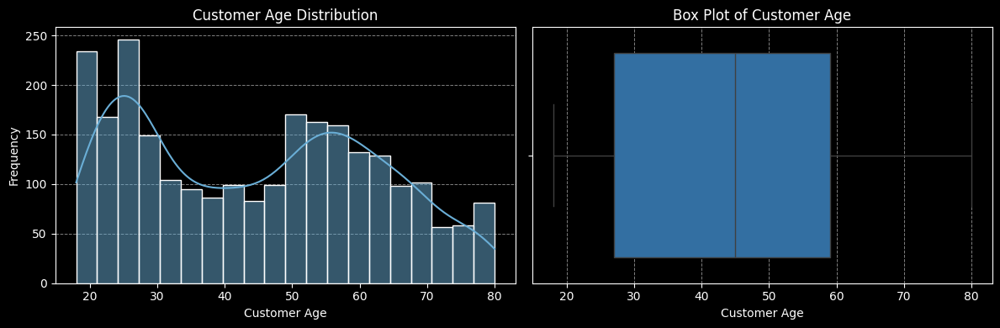


Resumen estadistico de Customer Age:
 count    2512.000000
mean       44.673965
std        17.792198
min        18.000000
25%        27.000000
50%        45.000000
75%        59.000000
max        80.000000
Name: CustomerAge, dtype: float64


In [35]:
fig, axes = plt.subplots(1, 2, figsize=(12, 4))

sns.histplot(df1['CustomerAge'], bins=20, kde=True, color=colores[1], ax=axes[0])
axes[0].set_title('Customer Age Distribution')
axes[0].set_xlabel('Customer Age')
axes[0].set_ylabel('Frequency')
axes[0].set_axisbelow(True)
axes[0].grid(axis='y', color='gray', linestyle='--', linewidth=0.7)

sns.boxplot(x=df1['CustomerAge'], color=colores[2], ax=axes[1])
axes[1].set_title('Box Plot of Customer Age')
axes[1].set_xlabel('Customer Age')
axes[1].set_axisbelow(True)
axes[1].grid(axis='x', color='gray', linestyle='--', linewidth=0.7)

plt.tight_layout()
plt.show()

# Print summary statistics
print(f'\nResumen estadistico de Customer Age:\n', df['CustomerAge'].describe())

In [36]:
scipy.stats.describe(df1['CustomerAge'])

DescribeResult(nobs=2512, minmax=(np.int64(18), np.int64(80)), mean=np.float64(44.673964968152866), variance=np.float64(316.56231672995506), skewness=np.float64(0.1477760713709111), kurtosis=np.float64(-1.2241467771251038))

El histograma sugiere una distribución aproximadamente simétrica de las edades de los clientes, con un ligero pico alrededor de la mediana edad. Esto indica que la base de clientes está distribuida de forma relativamente uniforme entre los diferentes grupos de edad. El diagrama de caja no muestra valores atípicos extremos. Los bigotes se extienden hasta los valores mínimo y máximo dentro de un rango razonable, lo que sugiere que la distribución por edades está relativamente equilibrada.

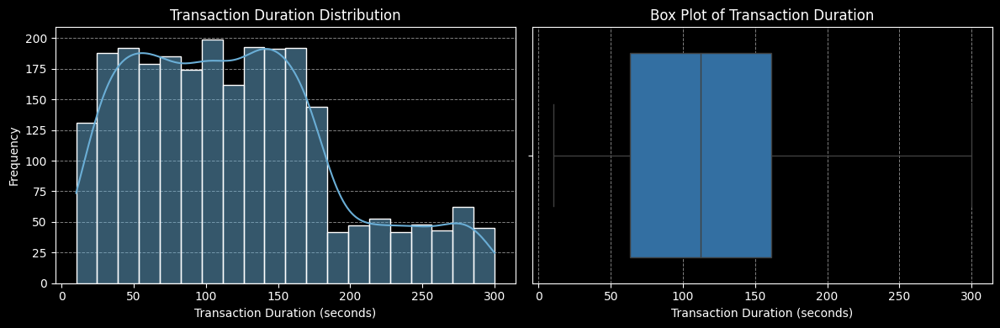


Resumen Estadistico de Transaction Duration:
 count    2512.000000
mean      119.643312
std        69.963757
min        10.000000
25%        63.000000
50%       112.500000
75%       161.000000
max       300.000000
Name: TransactionDuration, dtype: float64


In [37]:
fig, axes = plt.subplots(1, 2, figsize=(12, 4))

sns.histplot(df1['TransactionDuration'], bins=20, kde=True, color=colores[1], ax=axes[0])
axes[0].set_title('Transaction Duration Distribution')
axes[0].set_xlabel('Transaction Duration (seconds)')
axes[0].set_ylabel('Frequency')
axes[0].set_axisbelow(True)
axes[0].grid(axis='y', color='gray', linestyle='--', linewidth=0.7)

sns.boxplot(x=df1['TransactionDuration'], color=colores[2], ax=axes[1])
axes[1].set_title('Box Plot of Transaction Duration')
axes[1].set_xlabel('Transaction Duration (seconds)')
axes[1].set_axisbelow(True)
axes[1].grid(axis='x', color='gray', linestyle='--', linewidth=0.7)

plt.tight_layout()
plt.show()

# Print summary statistics
print(f'\nResumen Estadistico de Transaction Duration:\n', df['TransactionDuration'].describe())


In [38]:
scipy.stats.describe(df1['TransactionDuration'])

DescribeResult(nobs=2512, minmax=(np.int64(10), np.int64(300)), mean=np.float64(119.64331210191082), variance=np.float64(4894.927283012073), skewness=np.float64(0.5990738033681696), kurtosis=np.float64(-0.2605526495023578))

El histograma sugiere una distribución aproximadamente simétrica de la duración de las transacciones, con un ligero pico en el rango medio. Esto indica que la mayoría de las transacciones tienen una duración moderada. El diagrama de caja no muestra valores atípicos extremos. Los bigotes se extienden hasta los valores mínimo y máximo dentro de un rango razonable, lo que sugiere que la distribución está relativamente equilibrada.

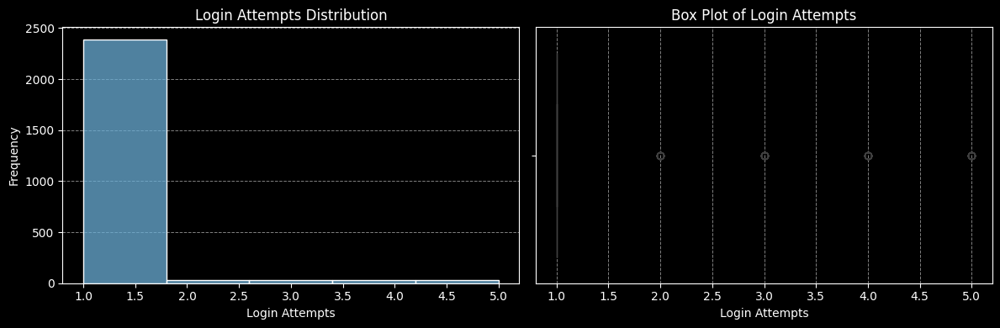


Resumen Estadistico de Login Attempts:
 count    2512.000000
mean        1.124602
std         0.602662
min         1.000000
25%         1.000000
50%         1.000000
75%         1.000000
max         5.000000
Name: LoginAttempts, dtype: float64


In [39]:
fig, axes = plt.subplots(1, 2, figsize=(12, 4))

sns.histplot(df1['LoginAttempts'], bins=5, kde=False, color=colores[1], ax=axes[0]) # bins adjusted to 5
axes[0].set_title('Login Attempts Distribution')
axes[0].set_xlabel('Login Attempts')
axes[0].set_ylabel('Frequency')
axes[0].set_axisbelow(True)
axes[0].grid(axis='y', color='gray', linestyle='--', linewidth=0.7)

sns.boxplot(x=df1['LoginAttempts'], color=colores[2], ax=axes[1])
axes[1].set_title('Box Plot of Login Attempts')
axes[1].set_xlabel('Login Attempts')
axes[1].set_axisbelow(True)
axes[1].grid(axis='x', color='gray', linestyle='--', linewidth=0.7)

plt.tight_layout()
plt.show()

# Print summary statistics
print(f'\nResumen Estadistico de Login Attempts:\n', df['LoginAttempts'].describe())

In [40]:
scipy.stats.describe(df1['LoginAttempts'])

DescribeResult(nobs=2512, minmax=(np.int64(1), np.int64(5)), mean=np.float64(1.1246019108280254), variance=np.float64(0.36320175305090713), skewness=np.float64(5.170400738779344), kurtosis=np.float64(26.613744951947748))

El histograma y el diagrama de cajas muestran claramente que la distribución de intentos de inicio de sesión está fuertemente sesgada hacia 1. Esto significa que la gran mayoría de las transacciones son precedidas por un solo intento de inicio de sesión. El diagrama de cajas indica la presencia de algunos valores atípicos con un mayor número de intentos de inicio de sesión. Estos valores atípicos podrían representar casos de múltiples intentos de inicio de sesión fallidos antes de una transacción exitosa, lo que podría justificar una investigación más profunda.

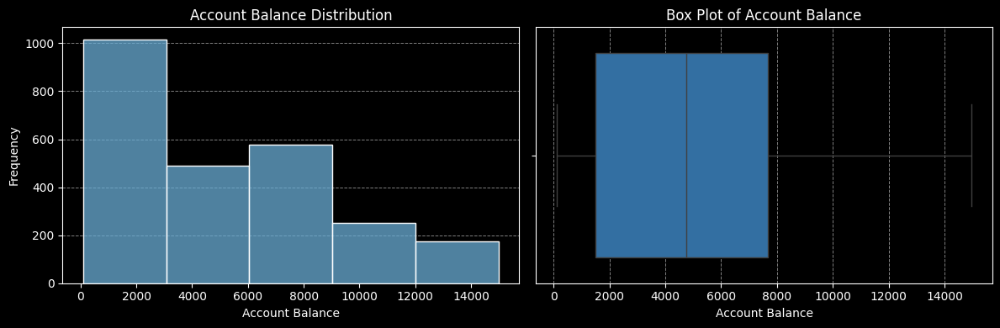


Summary Statistics for Account Balance:
 count     2512.000000
mean      5114.302966
std       3900.942499
min        101.250000
25%       1504.370000
50%       4735.510000
75%       7678.820000
max      14977.990000
Name: AccountBalance, dtype: float64


In [41]:
fig, axes = plt.subplots(1, 2, figsize=(12, 4))

sns.histplot(df1['AccountBalance'], bins=5, kde=False, color=colores[1], ax=axes[0]) # bins adjusted to 5
axes[0].set_title('Account Balance Distribution')
axes[0].set_xlabel('Account Balance')
axes[0].set_ylabel('Frequency')
axes[0].set_axisbelow(True)
axes[0].grid(axis='y', color='gray', linestyle='--', linewidth=0.7)

sns.boxplot(x=df1['AccountBalance'], color=colores[2], ax=axes[1])
axes[1].set_title('Box Plot of Account Balance')
axes[1].set_xlabel('Account Balance')
axes[1].set_axisbelow(True)
axes[1].grid(axis='x', color='gray', linestyle='--', linewidth=0.7)

plt.tight_layout()
plt.show()

# Print summary statistics
print(f'\nSummary Statistics for Account Balance:\n', df['AccountBalance'].describe())

In [42]:
scipy.stats.describe(df1['AccountBalance'])

DescribeResult(nobs=2512, minmax=(np.float64(101.25), np.float64(14977.99)), mean=np.float64(5114.302965764331), variance=np.float64(15217352.378406454), skewness=np.float64(0.6008421741892332), kurtosis=np.float64(-0.5660303626567988))

El histograma muestra una distribución sesgada a la derecha, lo que indica que la mayoría de las cuentas tienen saldos bajos, mientras que una proporción menor tiene saldos significativamente altos. El diagrama de caja confirma la presencia de valores atípicos. La cola larga a la derecha del diagrama de caja indica la presencia de valores significativamente superiores a la mayoría de los puntos de datos. Estos valores atípicos podrían representar cuentas con saldos inusualmente altos.

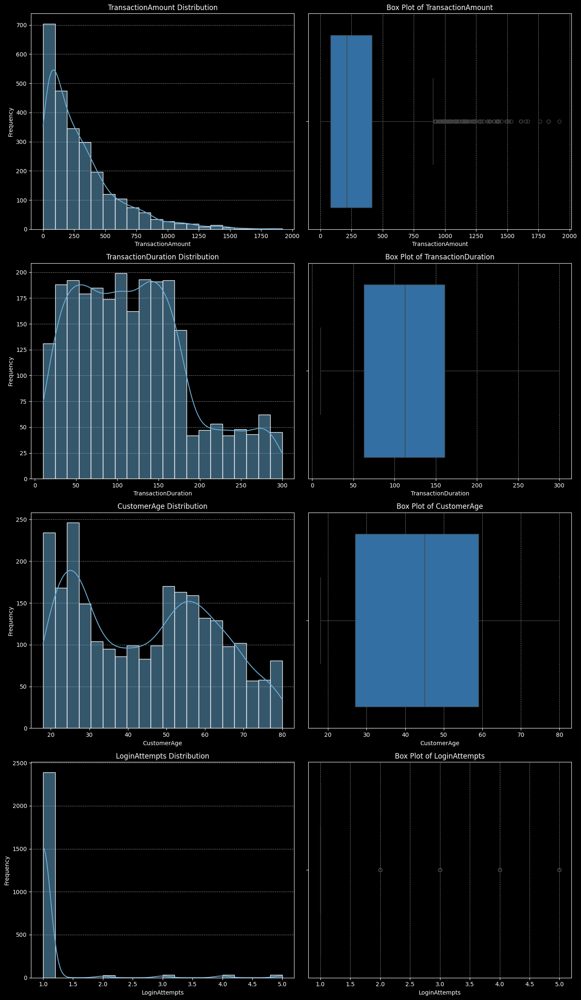


Resumen estadístico de TransactionAmount:
 count    2512.000000
mean      297.593778
std       291.946243
min         0.260000
25%        81.885000
50%       211.140000
75%       414.527500
max      1919.110000
Name: TransactionAmount, dtype: float64

Resumen estadístico de TransactionDuration:
 count    2512.000000
mean      119.643312
std        69.963757
min        10.000000
25%        63.000000
50%       112.500000
75%       161.000000
max       300.000000
Name: TransactionDuration, dtype: float64

Resumen estadístico de CustomerAge:
 count    2512.000000
mean       44.673965
std        17.792198
min        18.000000
25%        27.000000
50%        45.000000
75%        59.000000
max        80.000000
Name: CustomerAge, dtype: float64

Resumen estadístico de LoginAttempts:
 count    2512.000000
mean        1.124602
std         0.602662
min         1.000000
25%         1.000000
50%         1.000000
75%         1.000000
max         5.000000
Name: LoginAttempts, dtype: float64


In [43]:
numerical_columns = ['TransactionAmount', 'TransactionDuration', 'CustomerAge', 'LoginAttempts']

# Colores de la paleta de seaborn "Blues"
colores = sns.color_palette("Blues", 3)

# Crear una figura con subgráficos
fig, axes = plt.subplots(len(numerical_columns), 2, figsize=(14, 6 * len(numerical_columns)))

# Iterar sobre las columnas numéricas y crear el histograma y el boxplot
for i, col in enumerate(numerical_columns):
    # Histograma con KDE
    sns.histplot(df1[col], bins=20, kde=True, color=colores[1], ax=axes[i][0])
    axes[i][0].set_title(f'{col} Distribution')
    axes[i][0].set_xlabel(col)
    axes[i][0].set_ylabel('Frequency')
    axes[i][0].set_axisbelow(True)
    axes[i][0].grid(axis='y', color='gray', linestyle='--', linewidth=0.7)

    # Boxplot
    sns.boxplot(x=df1[col], color=colores[2], ax=axes[i][1])
    axes[i][1].set_title(f'Box Plot of {col}')
    axes[i][1].set_xlabel(col)
    axes[i][1].set_axisbelow(True)
    axes[i][1].grid(axis='x', color='gray', linestyle='--', linewidth=0.7)

# Ajustar el diseño para que no se solapen los gráficos
plt.tight_layout()

# Mostrar la figura
plt.show()

# Mostrar resumen estadístico para cada columna numérica
for col in numerical_columns:
    print(f'\nResumen estadístico de {col}:\n', df1[col].describe())

#Mapa

In [44]:
import time
import folium
from geopy.geocoders import Nominatim

# Obtener ubicaciones únicas
unique_locations = df['Location'].unique()
location_coords = {}

# Crear un geolocalizador
geolocator = Nominatim(user_agent="location_mapper")

# Obtener coordenadas
for location in unique_locations:
    try:
        loc = geolocator.geocode(location)
        if loc:
            location_coords[location] = (loc.latitude, loc.longitude)
        else:
            print(f"Coordinates not found for {location}")

        # Agregar un retraso para evitar el bloqueo de la API por solicitudes excesivas
        time.sleep(1)  # Ajusta el tiempo de espera si es necesario

    except Exception as e:
        print(f"Error fetching coordinates for {location}: {e}")


In [45]:
# Crear un mapa base centrado en el primer lugar o en una ubicación general
map_center = list(location_coords.values())[0] if location_coords else [0, 0]  # Por defecto, el mapa estará centrado en [0, 0]
mymap = folium.Map(location=map_center, zoom_start=10)

# Agregar marcadores para cada ubicación
for location, coords in location_coords.items():
    folium.Marker(location=coords, popup=location).add_to(mymap)
mymap.save("mapa_ubicaciones.html")
mymap


#Analisis Bivariado

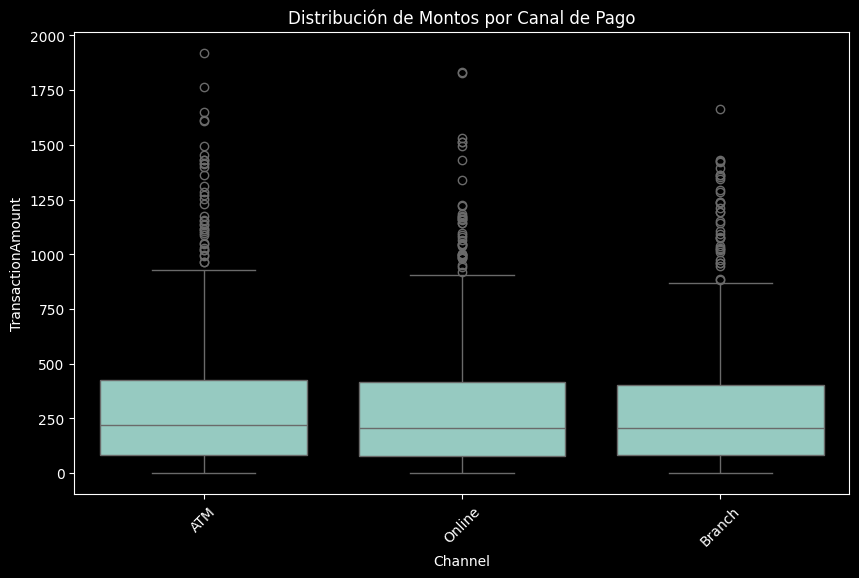

In [46]:
plt.figure(figsize=(10,6))
sns.boxplot(data=df1, x="Channel", y="TransactionAmount")
plt.xticks(rotation=45)
plt.title("Distribución de Montos por Canal de Pago")
plt.show()

🔍 Posibles fraudes: Canales online con montos altos pueden ser más riesgosos.

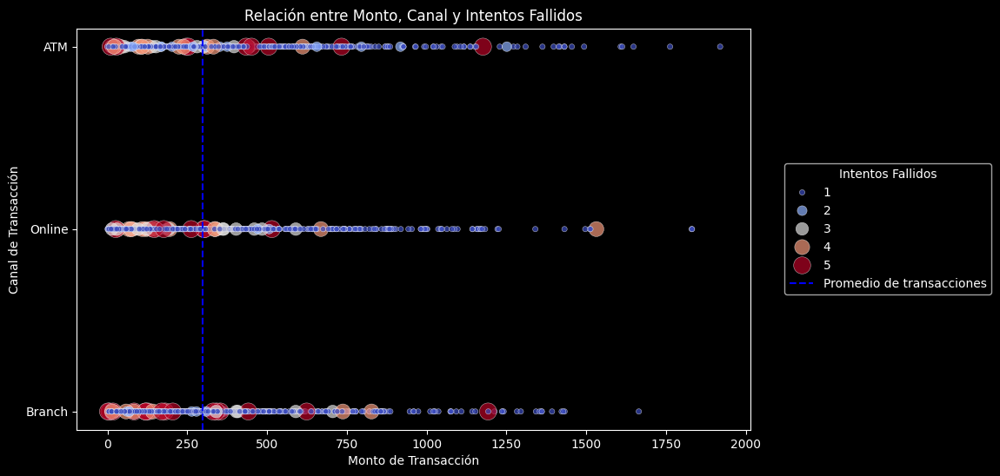

In [47]:
mean_amount = df1['TransactionAmount'].mean()

plt.figure(figsize=(10, 6))
sns.scatterplot(data=df1, x='TransactionAmount', y='Channel', hue='LoginAttempts', size='LoginAttempts', palette='coolwarm', sizes=(20, 200), alpha=0.7)
plt.axvline(x=mean_amount, color='blue', linestyle='--', label='Promedio de transacciones')
plt.xlabel('Monto de Transacción')
plt.ylabel('Canal de Transacción')
plt.title('Relación entre Monto, Canal y Intentos Fallidos')

# Leyenda a la derecha
plt.legend(title='Intentos Fallidos', loc='center left', bbox_to_anchor=(1.05, 0.5), borderaxespad=0.)

plt.show()

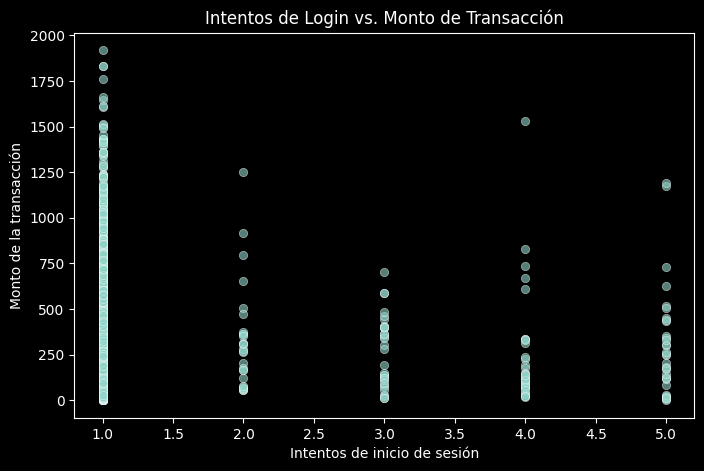

In [48]:
plt.figure(figsize=(8,5))
sns.scatterplot(data=df1, x="LoginAttempts", y="TransactionAmount", alpha=0.6)
plt.xlabel("Intentos de inicio de sesión")
plt.ylabel("Monto de la transacción")
plt.title("Intentos de Login vs. Monto de Transacción")
plt.show()


🔍 Posibles fraudes: Si hay muchas fallas de login antes de transacciones grandes, puede ser un intento de acceso no autorizado.

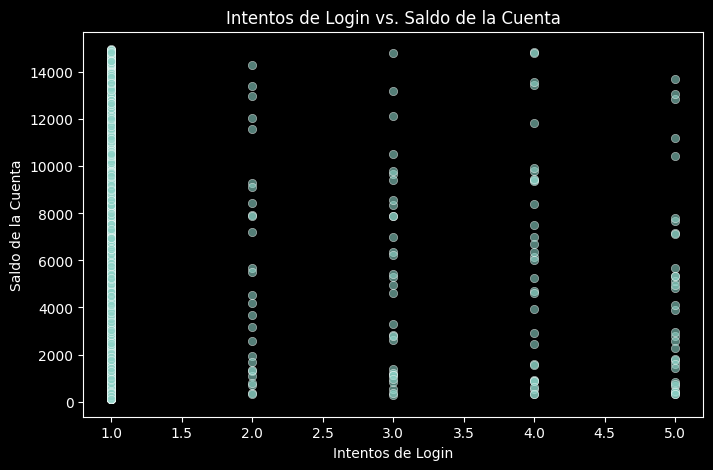

In [49]:
plt.figure(figsize=(8,5))
sns.scatterplot(data=df1, x="LoginAttempts", y="AccountBalance", alpha=0.6)
plt.xlabel("Intentos de Login")
plt.ylabel("Saldo de la Cuenta")
plt.title("Intentos de Login vs. Saldo de la Cuenta")
plt.show()

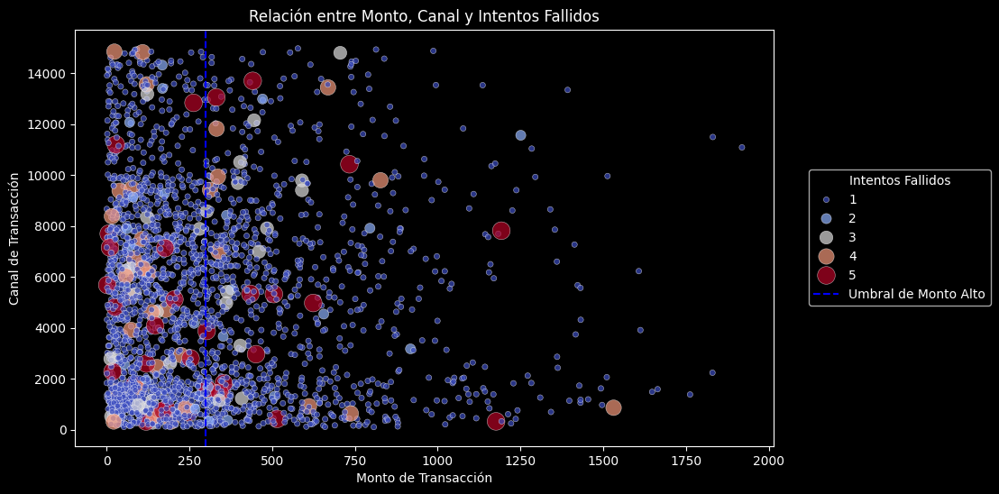

In [50]:
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df1, x='TransactionAmount', y='AccountBalance', hue='LoginAttempts', size='LoginAttempts', palette='coolwarm', sizes=(20, 200), alpha=0.7)
plt.axvline(x=mean_amount, color='blue', linestyle='--', label='Umbral de Monto Alto')
plt.xlabel('Monto de Transacción')
plt.ylabel('Canal de Transacción')
plt.title('Relación entre Monto, Canal y Intentos Fallidos')

# Leyenda a la derecha
plt.legend(title='Intentos Fallidos', loc='center left', bbox_to_anchor=(1.05, 0.5), borderaxespad=0.)

plt.show()

🔍 Posibles fraudes: Si hay muchos inicios de sesion y el saldo de la cuenta queda en 0

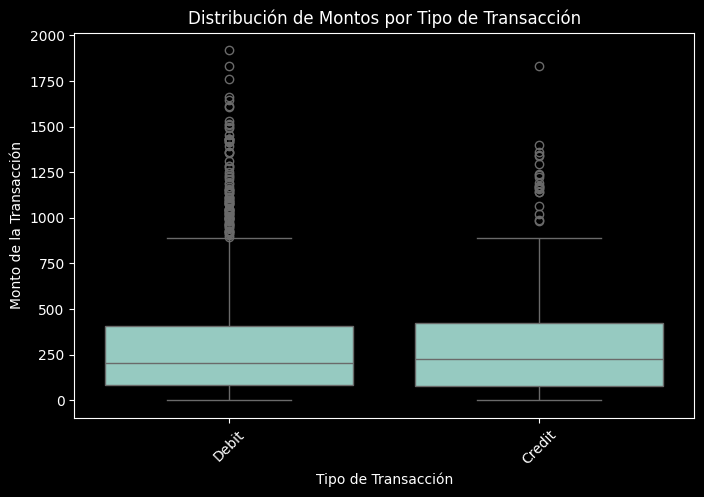

In [51]:
plt.figure(figsize=(8,5))
sns.boxplot(data=df1, x="TransactionType", y="TransactionAmount")
plt.xticks(rotation=45)
plt.xlabel("Tipo de Transacción")
plt.ylabel("Monto de la Transacción")
plt.title("Distribución de Montos por Tipo de Transacción")
plt.show()

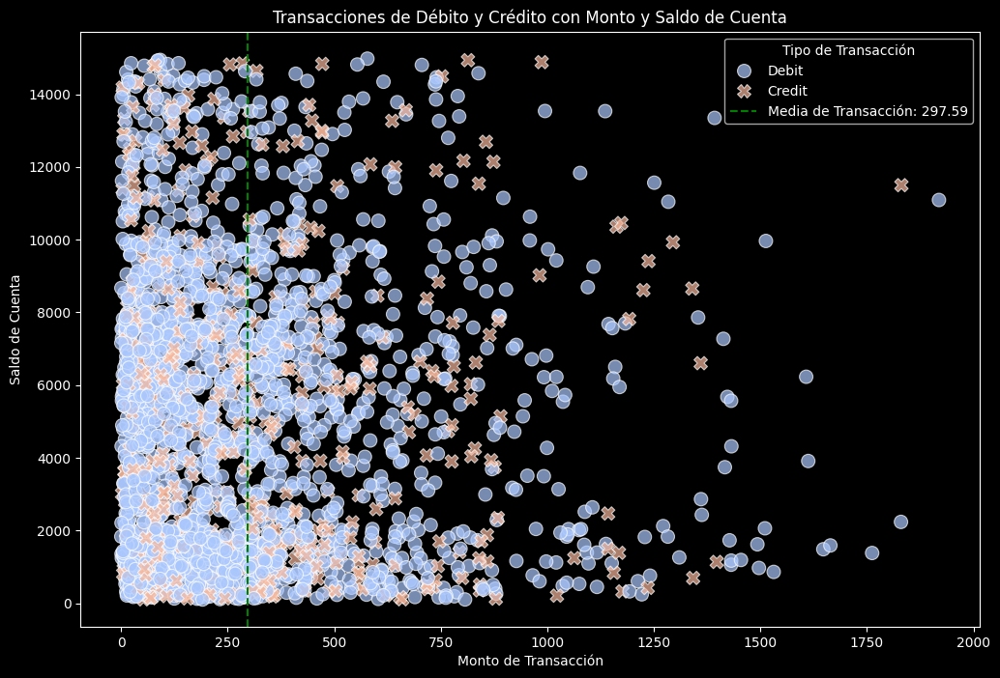

In [52]:
mean_amount = df1['TransactionAmount'].mean()

# Crear el gráfico de dispersión
plt.figure(figsize=(12, 8))
sns.scatterplot(data=df1,
                x='TransactionAmount',
                y='AccountBalance',
                hue='TransactionType',  # Diferencia entre Crédito y Débito
                style='TransactionType',  # Estilo para diferenciar
                palette='coolwarm',
                s=100,
                alpha=0.7)

# Añadir línea de la media de las transacciones
plt.axvline(x=mean_amount, color='green', linestyle='--', label=f'Media de Transacción: {mean_amount:.2f}')

# Etiquetas y título
plt.xlabel('Monto de Transacción')
plt.ylabel('Saldo de Cuenta')
plt.title('Transacciones de Débito y Crédito con Monto y Saldo de Cuenta')

# Mostrar la leyenda
plt.legend(title='Tipo de Transacción')

# Mostrar el gráfico
plt.show()

🔍 Posibles fraudes: Transacciones de crédito/débito con montos extremadamente altos en comparación con la media.

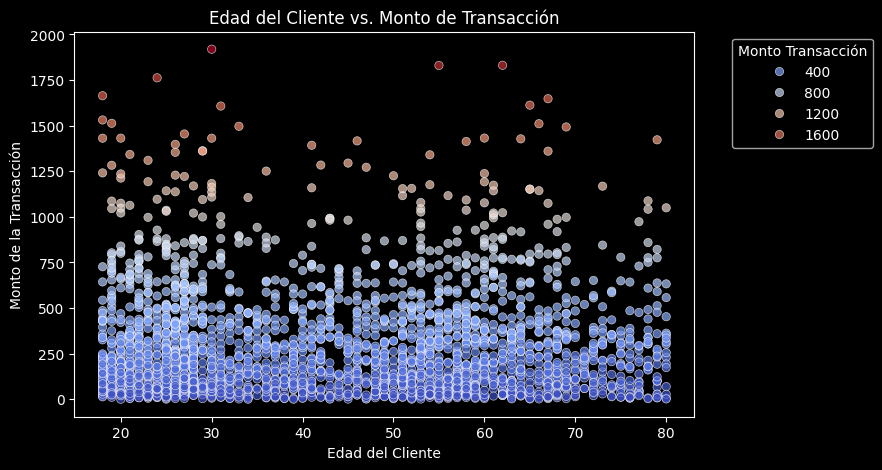

In [53]:
plt.figure(figsize=(8, 5))
sns.scatterplot(data=df1, x="CustomerAge", y="TransactionAmount", hue="TransactionAmount", palette="coolwarm", alpha=0.7)
plt.xlabel("Edad del Cliente")
plt.ylabel("Monto de la Transacción")
plt.title("Edad del Cliente vs. Monto de Transacción")
plt.legend(title="Monto Transacción", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

 🔍Posibles fraudes: Transacciones de alto monto realizadas por personas muy jóvenes o ancianos pueden ser sospechosas.

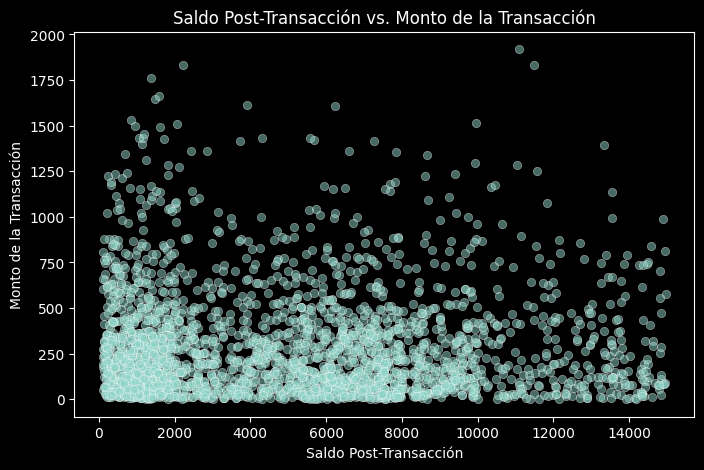

In [54]:
plt.figure(figsize=(8,5))
sns.scatterplot(data=df1, x="AccountBalance", y="TransactionAmount", alpha=0.5)
plt.xlabel("Saldo Post-Transacción")
plt.ylabel("Monto de la Transacción")
plt.title("Saldo Post-Transacción vs. Monto de la Transacción")
plt.show()

Posibles fraudes: Personas que gastan casi todo su saldo en una sola transacción.

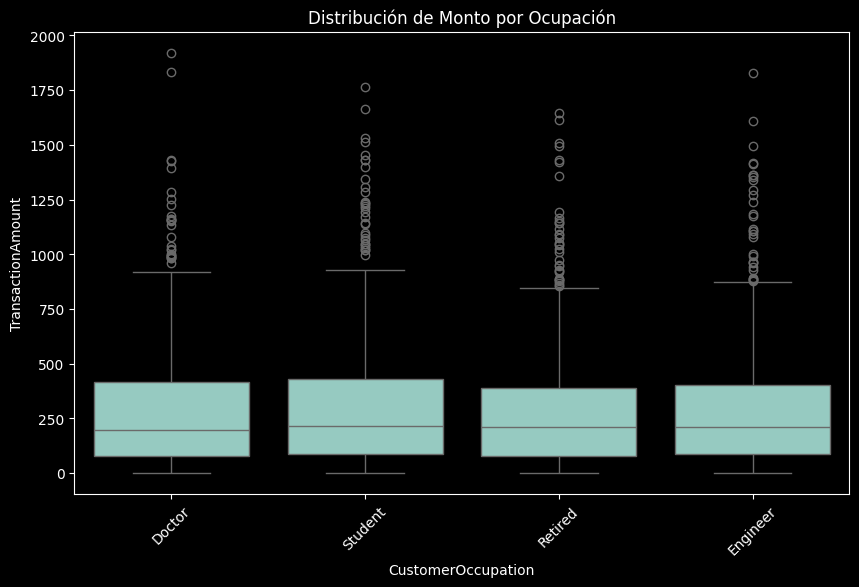

In [55]:
plt.figure(figsize=(10,6))
sns.boxplot(data=df1, x="CustomerOccupation", y="TransactionAmount")

plt.xticks(rotation=45)
plt.title("Distribución de Monto por Ocupación")
plt.show()


🔍 Posibles fraudes: Si estudiantes o jubilados hacen compras con montos muy altos, puede ser sospechoso.

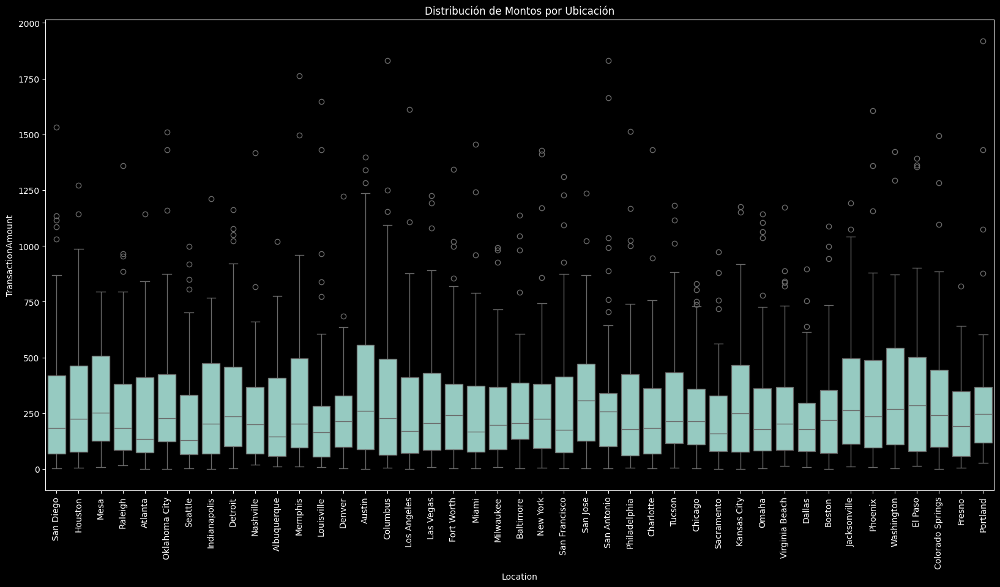

In [56]:
plt.figure(figsize=(20,10))
sns.boxplot(data=df1, x="Location", y="TransactionAmount")
plt.xticks(rotation=90)
plt.title("Distribución de Montos por Ubicación")
plt.show()

🔍Posible Fraude: transacciones de grandes montos realizadas en lugares donde normalmente no se realizan, lo cual podría ser un indicio de fraude.

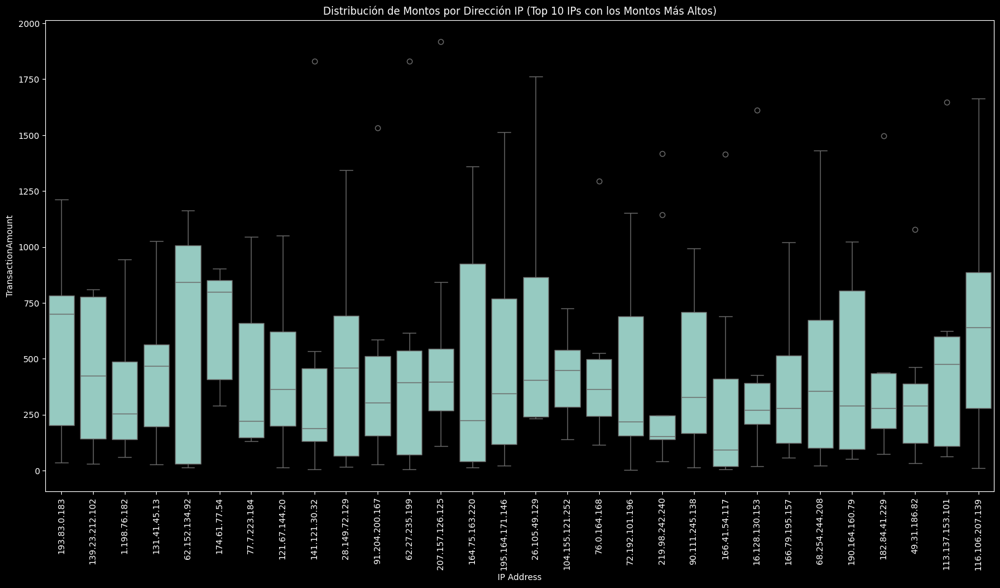

In [57]:
# Agrupar por IP Address y calcular el monto total de las transacciones
ip_total = df1.groupby('IP Address')['TransactionAmount'].sum().reset_index()

# Ordenar las IPs por monto total de transacciones en orden descendente
ip_total_sorted = ip_total.sort_values(by='TransactionAmount', ascending=False)

# Seleccionar las IPs con los montos más altos (por ejemplo, las 10 más altas)
top_ips = ip_total_sorted.head(30)

# Filtrar el dataframe original para mostrar solo las transacciones de estas IPs
df_top_ips = df1[df1['IP Address'].isin(top_ips['IP Address'])]

# Visualizar el boxplot con las IPs que tienen los montos más altos de transacciones
plt.figure(figsize=(20,10))
sns.boxplot(data=df_top_ips, x="IP Address", y="TransactionAmount")
plt.xticks(rotation=90)
plt.title("Distribución de Montos por Dirección IP (Top 10 IPs con los Montos Más Altos)")
plt.show()


🔍Posible Fraude: Si una IP tiene un monto total de transacciones significativamente mayor que el resto, podría indicar un comportamiento sospechoso, como intentos de fraude con múltiples compras de alto valor.

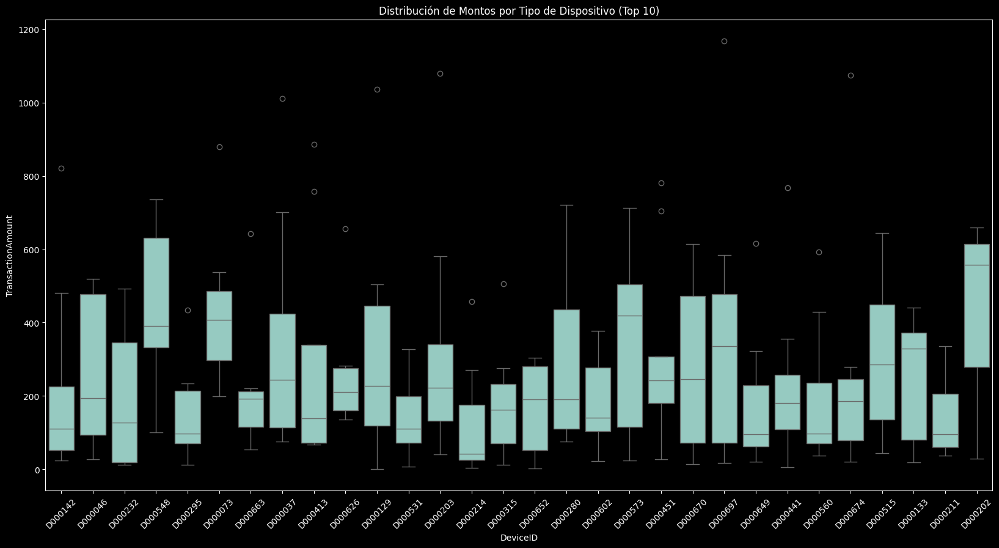

In [58]:
# Contar las frecuencias de cada dispositivo
top_devices = df1['DeviceID'].value_counts().nlargest(30).index

# Filtrar solo los dispositivos más frecuentes
df_filtered = df1[df1['DeviceID'].isin(top_devices)]

plt.figure(figsize=(20,10))
sns.boxplot(data=df_filtered, x="DeviceID", y="TransactionAmount")
plt.xticks(rotation=45)
plt.title("Distribución de Montos por Tipo de Dispositivo (Top 10)")
plt.show()


🔍Posible Fraude: Si un DeviceID aparece con outliers, de montos altos de transacciones, podría ser un bot o un fraude organizado utilizando el mismo dispositivo para múltiples compras.

#Analisis Multivariado

##Correlacion

In [59]:
columnas_numericas = df1.select_dtypes(include=np.number)

# Calculate correlation on numeric data
correlacion = columnas_numericas.corr(method="pearson")

correlacion

,TransactionAmount,CustomerAge,TransactionDuration,LoginAttempts,AccountBalance
TransactionAmount,1.000000,-0.025616,0.004359,-0.008445,-0.025165
CustomerAge,-0.025616,1.000000,-0.017936,0.007653,0.319942
TransactionDuration,0.004359,-0.017936,1.000000,0.032639,0.005577
LoginAttempts,-0.008445,0.007653,0.032639,1.000000,0.014999
AccountBalance,-0.025165,0.319942,0.005577,0.014999,1.000000


In [60]:
columnas_numericas

,TransactionAmount,CustomerAge,TransactionDuration,LoginAttempts,AccountBalance
0,14.09,70,81,1,5112.21
1,376.24,68,141,1,13758.91
2,126.29,19,56,1,1122.35
3,184.50,26,25,1,8569.06
4,13.45,26,198,1,7429.40
...,...,...,...,...,...
2507,856.21,33,109,1,12690.79
2508,251.54,48,177,1,254.75
2509,28.63,56,146,1,3382.91
2510,185.97,23,19,1,1776.91


In [61]:
columnas_numericas = df1.select_dtypes(include=['int64', 'float64']).columns.tolist()
columnas_numericas

['TransactionAmount',
 'CustomerAge',
 'TransactionDuration',
 'LoginAttempts',
 'AccountBalance']

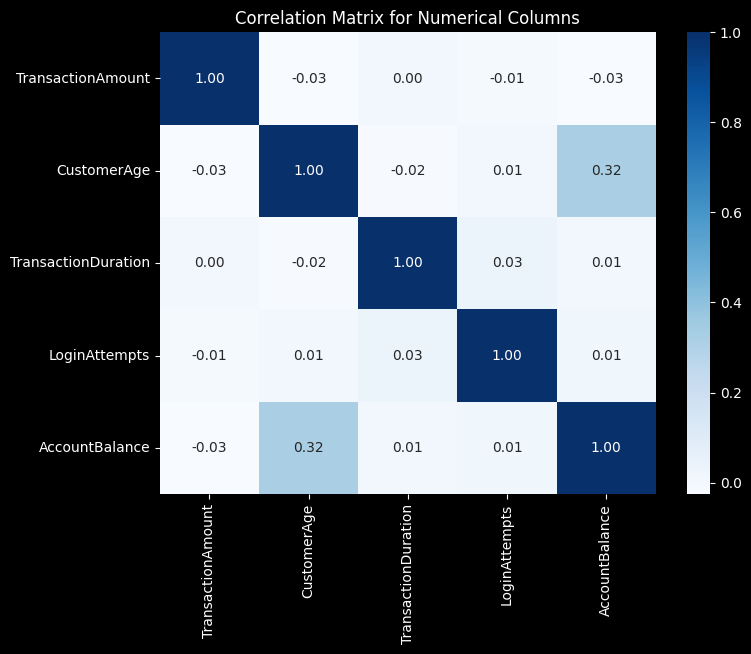

In [62]:
cmap= "Blues"
correlacion_matriz = correlacion
plt.figure(figsize=(8, 6))
sns.heatmap(correlacion_matriz, annot=True, cmap=cmap, fmt=".2f")
plt.title('Correlation Matrix for Numerical Columns')
plt.show()

 la única relación  significativa es entre CustomerAge y AccountBalance, que muestra que la edad del cliente podría influir en el saldo de la cuenta. Las demás relaciones son muy débiles

## Relación entre Canal de Pago, Monto de Transacción y Intentos de Login

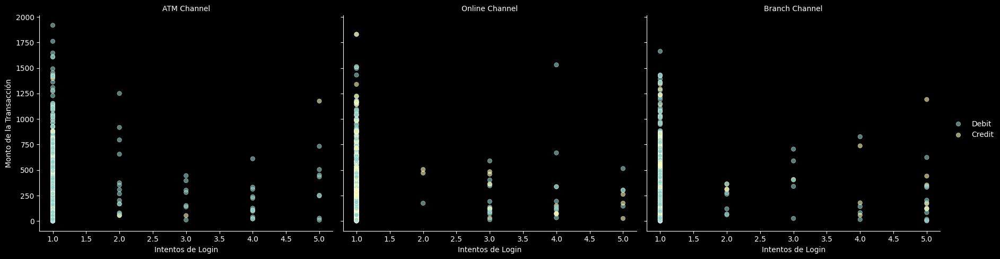

In [63]:
g = sns.FacetGrid(df1, col="Channel", height=5, aspect=1.2)
# Pass data explicitly to scatterplot
g.map(sns.scatterplot, "LoginAttempts", "TransactionAmount", alpha=0.6, hue='TransactionType', data=df1)

# Ajustar etiquetas y títulos
g.set_axis_labels("Intentos de Login", "Monto de la Transacción")
g.set_titles("{col_name} Channel")
g.add_legend()

# Mostrar el gráfico
plt.show()

🔍 Posibles Fraudes: Si los canales online muestran altos montos con intentos de login fallidos, esto puede ser un indicio de acceso no autorizado antes de realizar grandes transacciones.

 ## Relación entre Intentos de Login, Saldo de Cuenta y Monto de Transacción

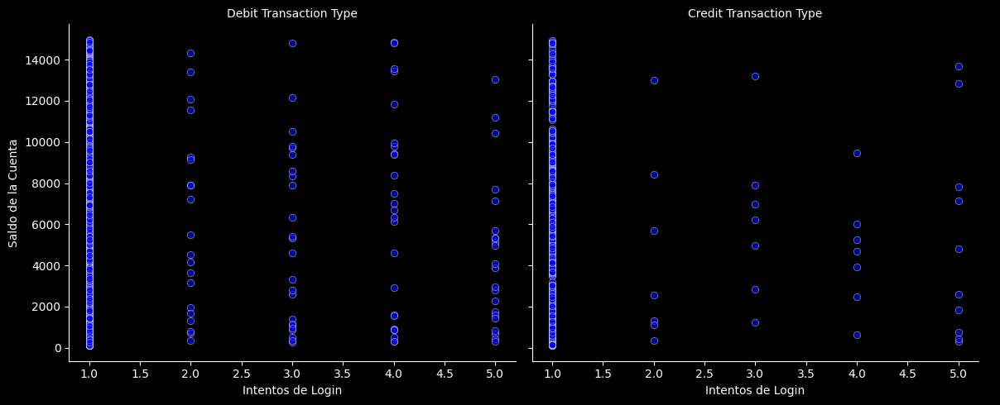

In [64]:
g = sns.FacetGrid(df1, col="TransactionType", height=5, aspect=1.2)
g.map(sns.scatterplot, "LoginAttempts", "AccountBalance", alpha=0.6, color='blue')
g.set_axis_labels("Intentos de Login", "Saldo de la Cuenta")
g.set_titles("{col_name} Transaction Type")
g.add_legend()
plt.show()


🔍 Posibles Fraudes: Si hay muchos intentos de login seguidos de transacciones de alto monto y un saldo casi vacío, esto podría indicar que un atacante está intentando acceder y gastar el dinero de la cuenta.

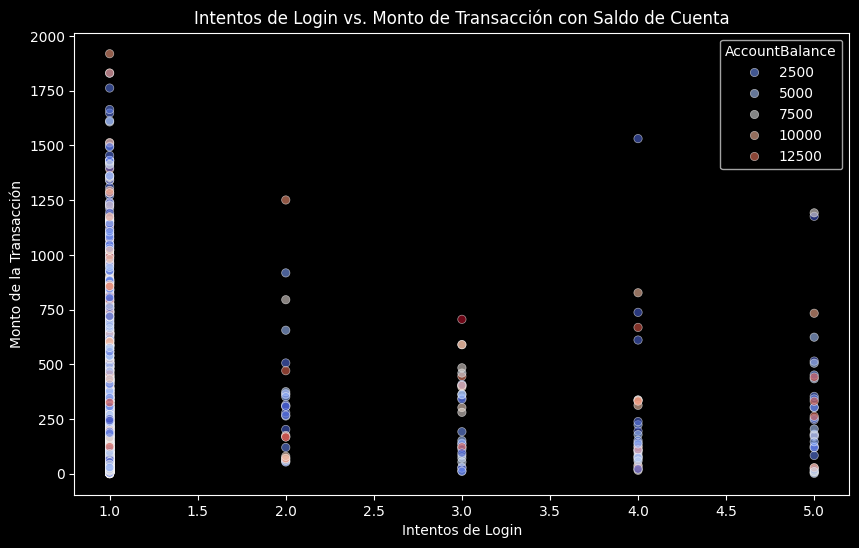

In [65]:
plt.figure(figsize=(10,6))
sns.scatterplot(data=df1, x="LoginAttempts", y="TransactionAmount", hue="AccountBalance", palette="coolwarm", alpha=0.6)
plt.xlabel("Intentos de Login")
plt.ylabel("Monto de la Transacción")
plt.title("Intentos de Login vs. Monto de Transacción con Saldo de Cuenta")
plt.show()

Posible Fraude: Las transacciones de alto monto con un saldo bajo y muchos intentos de inicio de sesión pueden ser indicios de un comportamiento sospechoso.

## Distribución de Montos de Transacción por Edad del Cliente y Saldo de Cuenta

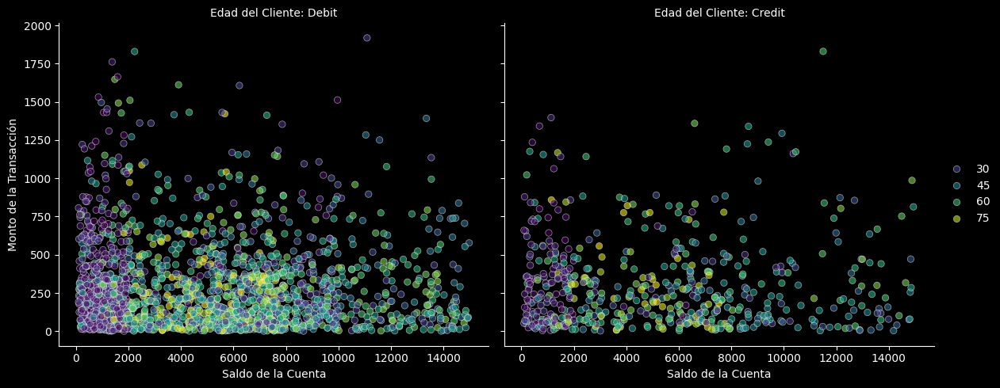

In [66]:
g = sns.FacetGrid(df1, col="TransactionType", height=5, aspect=1.2)
g.map(sns.scatterplot, "AccountBalance", "TransactionAmount", alpha=0.6,hue='CustomerAge', data=df1, palette='viridis')
g.set_axis_labels("Saldo de la Cuenta", "Monto de la Transacción")
g.set_titles("Edad del Cliente: {col_name}")
g.add_legend()
plt.show()

🔍 Posibles Fraudes: Transacciones grandes realizadas por personas muy jóvenes o muy mayores podrían ser sospechosas, especialmente si el saldo de la cuenta está muy bajo.

## Analisis multivariado teniendo en cuenta el tipo de transaccion: debito o credito

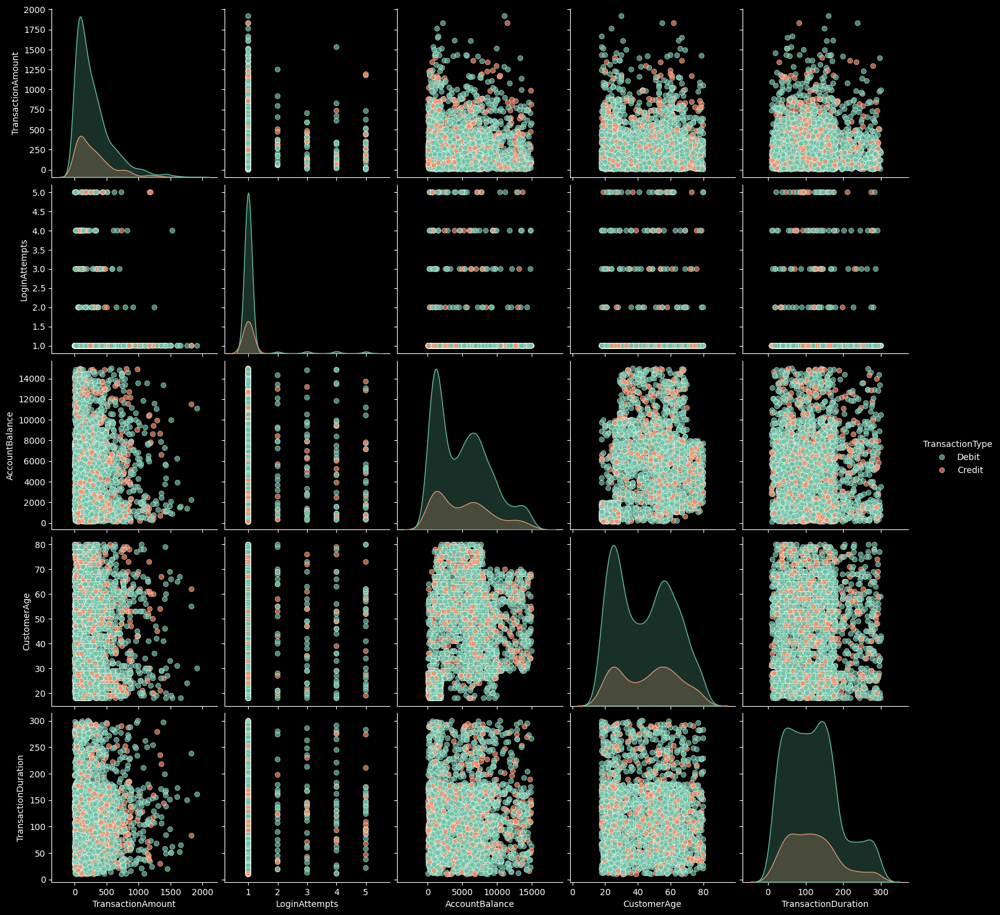

In [67]:
sns.pairplot(df1[['TransactionAmount', 'LoginAttempts', 'AccountBalance', 'CustomerAge', 'TransactionDuration', 'TransactionType']],
             hue='TransactionType',
             height=3,
             palette='Set2',
             diag_kind='kde',
             plot_kws={'alpha': 0.7})
plt.show()

1. Distribuciones Univariadas (las que se encuentran en Diagonal)
- TransactionAmount:
Distribución sesgada a la derecha (asimetría positiva). La mayoría de las transacciones tienen montos bajos (<500), pero hay valores altos (>1500).
Los valores extremos podrían ser anomalías (posibles fraudes). seria necesario normalizar esta variable para modelos como K-Means.
- LogAttempts:
Distribución  con un pico alrededor de 3.5. Los valores están más concentrados, con pocos puntos alejados.
Intentos de transacción inusualmente altos o bajos podrían indicar comportamiento sospechoso, pero esta variable parece menos discriminatoria para anomalías.
- AccountBalance:
Distribución sesgada a la derecha, con muchos saldos bajos (<2000) y algunos saldos altos (>8000).
Saldos extremadamente altos o bajos pueden estar correlacionados con fraudes deberia etandarizar para modelos sensibles a escala.
- CustomerAge:
Distribución aproximadamente uniforme entre 20 y 80 años, con un ligero pico alrededor de 40-50.
La edad por sí sola no parece indicar anomalías, pero combinada con otras variables (e.g., monto alto en clientes jóvenes) podría ser relevante.
- TransactionDuration:
Distribución sesgada a la derecha con un pico en duraciones cortas (<50) y una cola hacia duraciones más largas (hasta 300).
Implicación: Transacciones con duraciones largas podrían ser sospechosas (intentos de fraude prolongados). Esta variable podría ser útil para detectar outliers.

2. Relaciones Bivariadas (Scatter Plots)
- TransactionAmount vs. AccountBalance:
No hay una correlación clara, pero hay algunos puntos con montos altos (>1500) y saldos bajos (<2000), lo que podría indicar transacciones inusuales.
Implicación: Crear una característica derivada como TransactionAmount / AccountBalance podría resaltar transacciones desproporcionadas al saldo, potencialmente fraudulentas.
- TransactionAmount vs. TransactionDuration:
Se observan algunos puntos con montos altos y duraciones largas, formando una nube dispersa.
Transacciones con combinaciones extremas (alto monto + duración larga) son candidatas a anomalías.
- LogAttempts vs. otras variables:
Poca variabilidad en LogAttempts, con puntos concentrados alrededor de 3-4 intentos, independientemente de otras variables.
 Esta variable podría no ser muy informativa para clustering, pero valores extremos ( >5 intentos) podrían ser señales de fraude.
- CustomerAge vs. otras variables:
No hay patrones claros de correlación. Los clientes de todas las edades realizan transacciones de diversos montos y duraciones.
- La edad sola no es suficiente, pero podría usarse en interacciones (clientes muy jóvenes con montos altos).
- TransactionType (Debit vs. Credit):
Los puntos están coloreados por tipo de transacción (verde para Debit, naranja para Credit). No parece haber una separación clara entre tipos en los scatter plots.
Ambos tipos de transacciones tienen distribuciones similares, pero las anomalías podrían estar más asociadas con un tipo específico (Credit para fraudes con tarjetas). Considerar codificación One-Hot para esta variable

#INGENIERIA DE VARIABLES

- ANALISIS DE NULOS

In [68]:
df1.isnull().sum()

,0
TransactionID,0
AccountID,0
TransactionAmount,0
TransactionDate,0
TransactionType,0
Location,0
DeviceID,0
IP Address,0
MerchantID,0
Channel,0


- ANALISIS DE DUPLICADOS

In [69]:
df1.duplicated().sum()

np.int64(0)

no tengo duplicados

ANALISIS DE OUTLIERS CON IQR

In [70]:
# Seleccionar las columnas numéricas relevantes
columnas_numericas = ['TransactionAmount', 'CustomerAge', 'TransactionDuration', 'LoginAttempts', 'AccountBalance']

# Función para detectar outliers por IQR
def detectar_outliers(col):
    Q1 = col.quantile(0.25)
    Q3 = col.quantile(0.75)
    IQR = Q3 - Q1
    limite_inferior = Q1 - 1.5 * IQR
    limite_superior = Q3 + 1.5 * IQR
    return col[(col < limite_inferior) | (col > limite_superior)]

# Ver outliers por columna
for col in columnas_numericas:
    outliers = detectar_outliers(df[col])
    print(f"\n Outliers en '{col}': {len(outliers)} encontrados")
    print(outliers)


 Outliers en 'TransactionAmount': 113 encontrados
74      1212.51
82       922.55
85      1340.19
110     1045.22
129     1036.66
         ...   
2401     953.17
2403    1493.00
2414    1664.33
2428     981.90
2436     942.70
Name: TransactionAmount, Length: 113, dtype: float64

 Outliers en 'CustomerAge': 0 encontrados
Series([], Name: CustomerAge, dtype: int64)

 Outliers en 'TransactionDuration': 0 encontrados
Series([], Name: TransactionDuration, dtype: int64)

 Outliers en 'LoginAttempts': 122 encontrados
23      3
26      5
32      3
38      2
61      2
       ..
2423    4
2445    3
2455    2
2457    2
2492    2
Name: LoginAttempts, Length: 122, dtype: int64

 Outliers en 'AccountBalance': 0 encontrados
Series([], Name: AccountBalance, dtype: float64)


#SELECCION DE VARIABLES PARA KMEANS

In [71]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import pandas as pd

# 1. Seleccionar solo variables numéricas
variables_numericas = df.select_dtypes(include='number')

# 2. Escalado de variables
scaler = StandardScaler()
X_scaled = scaler.fit_transform(variables_numericas)

# 3. Aplicar K-Means Para analizar varianza estre clusteres, modelo para seleccion.
kmeans = KMeans(n_clusters=3, random_state=0)
kmeans.fit(X_scaled)

# 4. Añadir los clústeres al DataFrame original
df1['cluster'] = kmeans.labels_

# 5. Calcular la media de cada variable por clúster
grouped = df1.groupby('cluster')[variables_numericas.columns].mean()

# 6. Calcular la varianza entre clústeres de cada variable
variabilidad = grouped.var().sort_values(ascending=False)

# 7. Mostrar ranking de importancia
print(" Ranking de importancia de variables según varianza entre clústeres:")
print(variabilidad)


 Ranking de importancia de variables según varianza entre clústeres:
AccountBalance         6.495114e+06
TransactionAmount      6.697154e+02
CustomerAge            1.926619e+02
TransactionDuration    5.323341e+01
LoginAttempts          2.999682e+00
dtype: float64


 Mide cuánto cambia cada variable en promedio entre clústeres. Cuanto mayor es la varianza, más "informativa" es la variable para diferenciar los clústeres. account balance, TransactionAmount y CustomerAge son las variables seleccionadas.

In [72]:
df1

,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,CustomerAge,CustomerOccupation,TransactionDuration,LoginAttempts,AccountBalance,PreviousTransactionDate,cluster
0,TX000001,AC00128,14.09,2023-04-11 16:29:14,Debit,San Diego,D000380,162.198.218.92,M015,ATM,70,Doctor,81,1,5112.21,2024-11-04 08:08:08,1
1,TX000002,AC00455,376.24,2023-06-27 16:44:19,Debit,Houston,D000051,13.149.61.4,M052,ATM,68,Doctor,141,1,13758.91,2024-11-04 08:09:35,1
2,TX000003,AC00019,126.29,2023-07-10 18:16:08,Debit,Mesa,D000235,215.97.143.157,M009,Online,19,Student,56,1,1122.35,2024-11-04 08:07:04,0
3,TX000004,AC00070,184.50,2023-05-05 16:32:11,Debit,Raleigh,D000187,200.13.225.150,M002,Online,26,Student,25,1,8569.06,2024-11-04 08:09:06,1
4,TX000005,AC00411,13.45,2023-10-16 17:51:24,Credit,Atlanta,D000308,65.164.3.100,M091,Online,26,Student,198,1,7429.40,2024-11-04 08:06:39,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2507,TX002508,AC00297,856.21,2023-04-26 17:09:36,Credit,Colorado Springs,D000625,21.157.41.17,M072,Branch,33,Doctor,109,1,12690.79,2024-11-04 08:11:29,1
2508,TX002509,AC00322,251.54,2023-03-22 17:36:48,Debit,Tucson,D000410,49.174.157.140,M029,Branch,48,Doctor,177,1,254.75,2024-11-04 08:11:42,0
2509,TX002510,AC00095,28.63,2023-08-21 17:08:50,Debit,San Diego,D000095,58.1.27.124,M087,Branch,56,Retired,146,1,3382.91,2024-11-04 08:08:39,1
2510,TX002511,AC00118,185.97,2023-02-24 16:24:46,Debit,Denver,D000634,21.190.11.223,M041,Online,23,Student,19,1,1776.91,2024-11-04 08:12:22,0


elimino la columna cluster generada, ya que use el modelo solo para ver la varianza entre clusteres y seleccion de variables mas importantes.

In [73]:
df1.drop(columns=['cluster'], inplace=True)
df1

,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,CustomerAge,CustomerOccupation,TransactionDuration,LoginAttempts,AccountBalance,PreviousTransactionDate
0,TX000001,AC00128,14.09,2023-04-11 16:29:14,Debit,San Diego,D000380,162.198.218.92,M015,ATM,70,Doctor,81,1,5112.21,2024-11-04 08:08:08
1,TX000002,AC00455,376.24,2023-06-27 16:44:19,Debit,Houston,D000051,13.149.61.4,M052,ATM,68,Doctor,141,1,13758.91,2024-11-04 08:09:35
2,TX000003,AC00019,126.29,2023-07-10 18:16:08,Debit,Mesa,D000235,215.97.143.157,M009,Online,19,Student,56,1,1122.35,2024-11-04 08:07:04
3,TX000004,AC00070,184.50,2023-05-05 16:32:11,Debit,Raleigh,D000187,200.13.225.150,M002,Online,26,Student,25,1,8569.06,2024-11-04 08:09:06
4,TX000005,AC00411,13.45,2023-10-16 17:51:24,Credit,Atlanta,D000308,65.164.3.100,M091,Online,26,Student,198,1,7429.40,2024-11-04 08:06:39
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2507,TX002508,AC00297,856.21,2023-04-26 17:09:36,Credit,Colorado Springs,D000625,21.157.41.17,M072,Branch,33,Doctor,109,1,12690.79,2024-11-04 08:11:29
2508,TX002509,AC00322,251.54,2023-03-22 17:36:48,Debit,Tucson,D000410,49.174.157.140,M029,Branch,48,Doctor,177,1,254.75,2024-11-04 08:11:42
2509,TX002510,AC00095,28.63,2023-08-21 17:08:50,Debit,San Diego,D000095,58.1.27.124,M087,Branch,56,Retired,146,1,3382.91,2024-11-04 08:08:39
2510,TX002511,AC00118,185.97,2023-02-24 16:24:46,Debit,Denver,D000634,21.190.11.223,M041,Online,23,Student,19,1,1776.91,2024-11-04 08:12:22


#ESCALADO DE VARIABLES PARA EL MODELO

In [74]:
from sklearn.preprocessing import StandardScaler

# Seleccionar las columnas numéricas relevantes
columnas_numericas_modelo = ['TransactionAmount', 'CustomerAge', 'AccountBalance']

# Escalar las variables numéricas
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df1[columnas_numericas_modelo])

# Convertir el resultado a un DataFrame
df_modelo = pd.DataFrame(X_scaled, columns=columnas_numericas_modelo)

# Verificación de la escala
print(df_modelo.describe())

       TransactionAmount   CustomerAge  AccountBalance
count       2.512000e+03  2.512000e+03    2.512000e+03
mean       -1.414297e-16  9.900078e-18    4.985396e-17
std         1.000199e+00  1.000199e+00    1.000199e+00
min        -1.018657e+00 -1.499493e+00   -1.285344e+00
25%        -7.390118e-01 -9.935526e-01   -9.255845e-01
50%        -2.961881e-01  1.832826e-02   -9.712227e-02
75%         4.006114e-01  8.053467e-01    6.575405e-01
max         5.555266e+00  1.985874e+00    2.529043e+00


In [75]:
df_modelo

,TransactionAmount,CustomerAge,AccountBalance
0,-0.971275,1.423718,-0.000537
1,0.269440,1.311287,2.216472
2,-0.586882,-1.443277,-1.023534
3,-0.387456,-1.049768,0.885797
4,-0.973468,-1.049768,0.593589
...,...,...,...
2507,1.913802,-0.656259,1.942606
2508,-0.157779,0.186975,-1.245986
2509,-0.921462,0.636700,-0.443928
2510,-0.382420,-1.218415,-0.855705


#DATOS SESGADOS

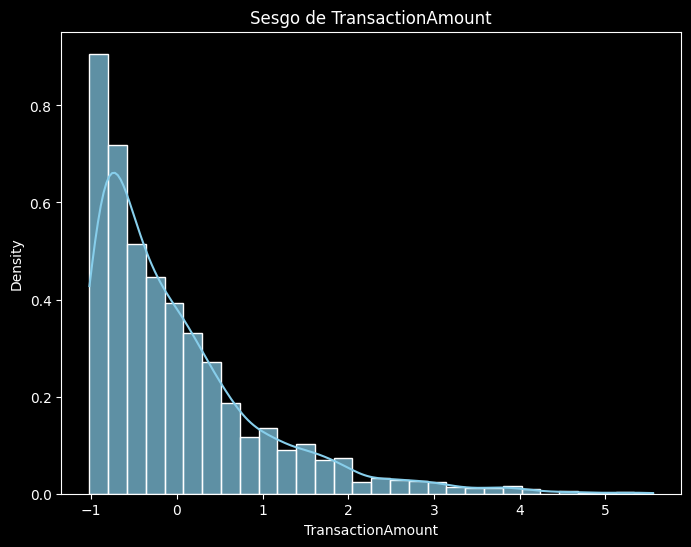

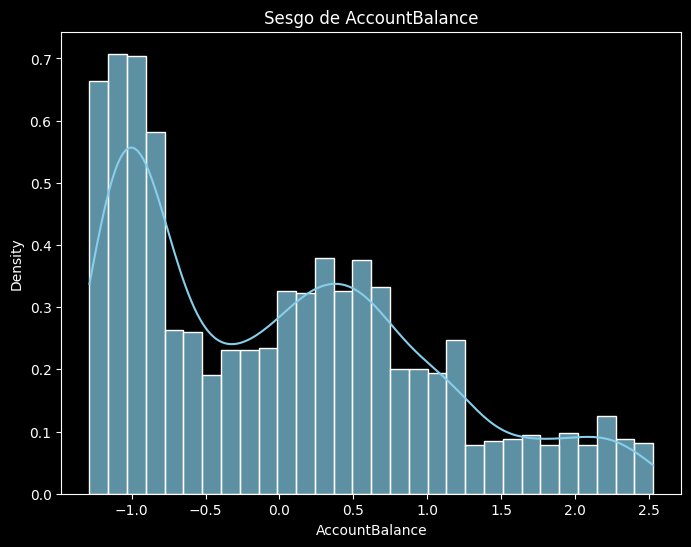

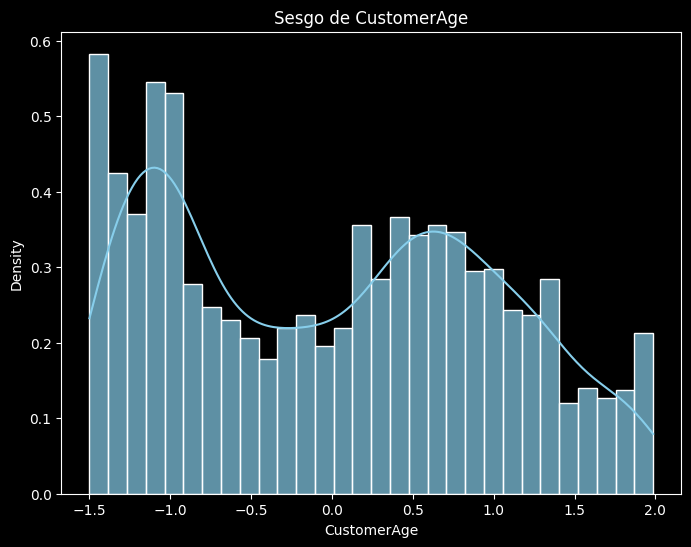

In [76]:
for var in ['TransactionAmount', 'AccountBalance', 'CustomerAge']:
    plt.figure(figsize=(8, 6))
    sns.histplot(df_modelo[var], kde=True, stat="density", bins=30, color='skyblue', alpha=0.7)
    plt.title(f'Sesgo de {var}')
    plt.show()

In [77]:
from scipy.stats import skew

# Calcular el sesgo de las variables
sesgos = df_modelo[['TransactionAmount', 'AccountBalance', 'CustomerAge']].apply(skew)
print(sesgos)

TransactionAmount    1.739067
AccountBalance       0.600842
CustomerAge          0.147776
dtype: float64


- Sesgo cercano a 0 (simetría):

[-0.5, 0.5]: Un sesgo en este rango generalmente indica que la distribución de los datos es aproximadamente simétrica.

- Sesgo moderadamente positivo o negativo:

(0.5, 1.0) o (-1.0, -0.5): En este rango, la distribución sigue siendo relativamente simétrica, pero ya muestra una ligera inclinación hacia un lado. En este caso, las colas de la distribución comienzan a ser más largas de un lado que del otro, aunque no es excesivo.

- Sesgo notable (asimetría):

(1.0, 2.0) o (-2.0, -1.0): Este rango sugiere una asimetría moderada. Para valores positivos, la cola de la distribución está a la derecha (asimetría positiva); para valores negativos, la cola está a la izquierda (asimetría negativa).

- Sesgo muy alto (fuertemente asimétrico):

> 2.0 o < -2.0: Un sesgo en este rango indica una fuerta asimetría. Las colas de la distribución son significativamente más largas de un lado, lo que puede ser indicativo de la presencia de valores atípicos (outliers) o de una distribución muy sesgada.



tengo datos sesgados, aplico transformacion logaritmica a Transaction Amount

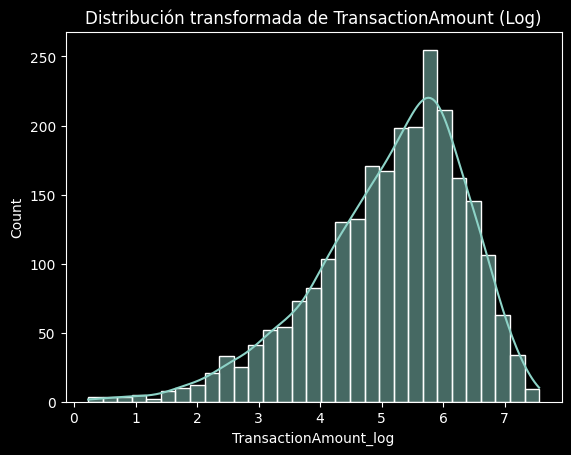

In [78]:
# Aplicar la transformación logarítmica
df_modelo['TransactionAmount_log'] = np.log1p(df['TransactionAmount'])  # log(1 + x) para evitar problemas con ceros


# Ver las distribuciones después de la transformación
sns.histplot(df_modelo['TransactionAmount_log'], kde=True)
plt.title('Distribución transformada de TransactionAmount (Log)')
plt.show()

In [79]:
skew_log = skew(df_modelo['TransactionAmount_log'])
print("Sesgo de TransactionAmount_log:", skew_log)

Sesgo de TransactionAmount_log: -0.803321903617277


la logaritmica, me pasa la distribucion a la izquierda aplico la transformaciones siguiente:

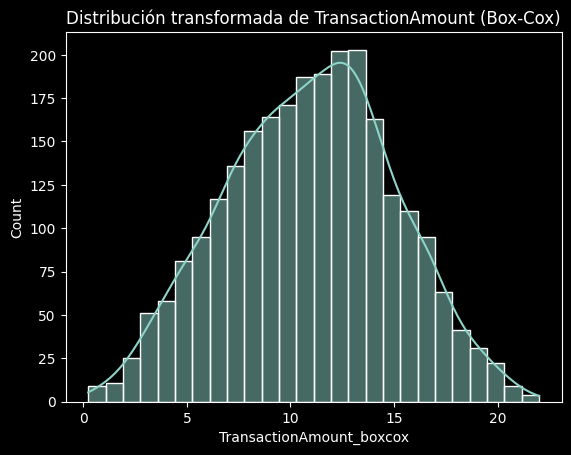

In [80]:
from scipy import stats

# Aplicar la transformación Box-Cox, que es más general
df_modelo['TransactionAmount_boxcox'], _ = stats.boxcox(df['TransactionAmount'] + 1)  # Asegúrate de que no haya ceros

# Ver las distribuciones después de la transformación
sns.histplot(df_modelo['TransactionAmount_boxcox'], kde=True)
plt.title('Distribución transformada de TransactionAmount (Box-Cox)')
plt.show()

In [81]:
df_modelo

,TransactionAmount,CustomerAge,AccountBalance,TransactionAmount_log,TransactionAmount_boxcox
0,-0.971275,1.423718,-0.000537,2.714032,3.858169
1,0.269440,1.311287,2.216472,5.932882,13.411204
2,-0.586882,-1.443277,-1.023534,4.846468,9.316658
3,-0.387456,-1.049768,0.885797,5.223055,10.614088
4,-0.973468,-1.049768,0.593589,2.670694,3.774210
...,...,...,...,...,...
2507,1.913802,-0.656259,1.942606,6.753683,17.316181
2508,-0.157779,0.186975,-1.245986,5.531570,11.770157
2509,-0.921462,0.636700,-0.443928,3.388787,5.287525
2510,-0.382420,-1.218415,-0.855705,5.230948,10.642587


In [82]:
from scipy.stats import skew

# Calcular el sesgo de las variables
sesgos = df_modelo[['TransactionAmount_boxcox', 'CustomerAge', 'AccountBalance']].apply(skew)
print(sesgos)

TransactionAmount_boxcox   -0.051524
CustomerAge                 0.147776
AccountBalance              0.600842
dtype: float64


no aplico boxcox a account balance porque hay valores menores a 0, y es asimetrica pero no tiene un valor tan alto.

In [83]:
df_modelo

,TransactionAmount,CustomerAge,AccountBalance,TransactionAmount_log,TransactionAmount_boxcox
0,-0.971275,1.423718,-0.000537,2.714032,3.858169
1,0.269440,1.311287,2.216472,5.932882,13.411204
2,-0.586882,-1.443277,-1.023534,4.846468,9.316658
3,-0.387456,-1.049768,0.885797,5.223055,10.614088
4,-0.973468,-1.049768,0.593589,2.670694,3.774210
...,...,...,...,...,...
2507,1.913802,-0.656259,1.942606,6.753683,17.316181
2508,-0.157779,0.186975,-1.245986,5.531570,11.770157
2509,-0.921462,0.636700,-0.443928,3.388787,5.287525
2510,-0.382420,-1.218415,-0.855705,5.230948,10.642587


In [84]:
df_modelo.drop(columns=['TransactionAmount_log'])

,TransactionAmount,CustomerAge,AccountBalance,TransactionAmount_boxcox
0,-0.971275,1.423718,-0.000537,3.858169
1,0.269440,1.311287,2.216472,13.411204
2,-0.586882,-1.443277,-1.023534,9.316658
3,-0.387456,-1.049768,0.885797,10.614088
4,-0.973468,-1.049768,0.593589,3.774210
...,...,...,...,...
2507,1.913802,-0.656259,1.942606,17.316181
2508,-0.157779,0.186975,-1.245986,11.770157
2509,-0.921462,0.636700,-0.443928,5.287525
2510,-0.382420,-1.218415,-0.855705,10.642587


escalo nuevamente luego de realizar esta ultima transformacion:

In [85]:
from sklearn.preprocessing import StandardScaler

# Selecciono las variables que voy a usar para el modelo y escalo
columnas_del_modelo = ['TransactionAmount_boxcox', 'CustomerAge', 'AccountBalance']

# Escalar las variables transformadas
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_modelo[columnas_del_modelo])

# Convertir el resultado a un DataFrame
df_modelo = pd.DataFrame(X_scaled, columns=columnas_del_modelo)

# Verificación de la escala
print(df_modelo.describe())  # Asegúrate de que la media sea 0 y la desviación estándar 1

       TransactionAmount_boxcox  CustomerAge  AccountBalance
count              2.512000e+03  2512.000000    2.512000e+03
mean               3.351884e-16     0.000000    3.323598e-17
std                1.000199e+00     1.000199    1.000199e+00
min               -2.629493e+00    -1.499493   -1.285344e+00
25%               -7.282569e-01    -0.993553   -9.255845e-01
50%                4.023157e-02     0.018328   -9.712227e-02
75%                7.096237e-01     0.805347    6.575405e-01
max                2.716535e+00     1.985874    2.529043e+00


In [86]:
df_modelo

,TransactionAmount_boxcox,CustomerAge,AccountBalance
0,-1.740181,1.423718,-0.000537
1,0.606439,1.311287,2.216472
2,-0.399350,-1.443277,-1.023534
3,-0.080648,-1.049768,0.885797
4,-1.760804,-1.049768,0.593589
...,...,...,...
2507,1.565663,-0.656259,1.942606
2508,0.203330,0.186975,-1.245986
2509,-1.389072,0.636700,-0.443928
2510,-0.073647,-1.218415,-0.855705


---
# Modelos
---



#KMEANS

###Kmeans- TransactionAmount_boxcox y AccountBalance_boxcox

In [87]:
# Seleccionar solo las variables transformadas
X = df_modelo[['TransactionAmount_boxcox',  'AccountBalance']]

In [88]:
df_modelo

,TransactionAmount_boxcox,CustomerAge,AccountBalance
0,-1.740181,1.423718,-0.000537
1,0.606439,1.311287,2.216472
2,-0.399350,-1.443277,-1.023534
3,-0.080648,-1.049768,0.885797
4,-1.760804,-1.049768,0.593589
...,...,...,...
2507,1.565663,-0.656259,1.942606
2508,0.203330,0.186975,-1.245986
2509,-1.389072,0.636700,-0.443928
2510,-0.073647,-1.218415,-0.855705


In [89]:
X = df_modelo.iloc[:, [0,2]].values
X

array([[-1.74018063e+00, -5.36635052e-04],
       [ 6.06439338e-01,  2.21647159e+00],
       [-3.99350226e-01, -1.02353413e+00],
       ...,
       [-1.38907170e+00, -4.43928023e-01],
       [-7.36474019e-02, -8.55705373e-01],
       [ 1.70899332e-01, -1.27765152e+00]])

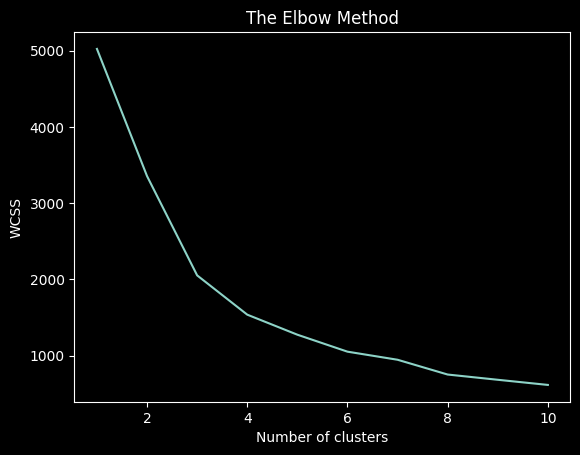

In [90]:
# Metodo del Codo para encontrar el numero optimo de clusters
from sklearn.cluster import KMeans
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 42)
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)
# Grafica de la suma de las distancias
plt.plot(range(1, 11), wcss)
plt.title('The Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

In [91]:
# Imprimir los valores de inercia
for i, inertia in enumerate(wcss, start=1):
    print(f'Clusters: {i}, Inercia (WCSS): {inertia:.2f}')

Clusters: 1, Inercia (WCSS): 5024.00
Clusters: 2, Inercia (WCSS): 3355.28
Clusters: 3, Inercia (WCSS): 2053.46
Clusters: 4, Inercia (WCSS): 1538.28
Clusters: 5, Inercia (WCSS): 1275.49
Clusters: 6, Inercia (WCSS): 1052.86
Clusters: 7, Inercia (WCSS): 946.81
Clusters: 8, Inercia (WCSS): 752.86
Clusters: 9, Inercia (WCSS): 684.12
Clusters: 10, Inercia (WCSS): 616.63


el punto de inflexión —el “codo”— donde la reducción de la inercia comienza a volverse menos pronunciada ES EN K=4

In [92]:
# Creando el k-Means para los 4 grupos encontrados
kmeans = KMeans(n_clusters = 4, init = 'k-means++', random_state = 42)
# k-means++ acelera la convergencia, respecto de random
y_kmeans = kmeans.fit_predict(X)

In [93]:
y_kmeans

array([3, 2, 3, ..., 3, 3, 1], dtype=int32)

In [94]:
df_modelo['prediccion_TA_vs_AB'] = y_kmeans
df_modelo

,TransactionAmount_boxcox,CustomerAge,AccountBalance,prediccion_TA_vs_AB
0,-1.740181,1.423718,-0.000537,3
1,0.606439,1.311287,2.216472,2
2,-0.399350,-1.443277,-1.023534,3
3,-0.080648,-1.049768,0.885797,2
4,-1.760804,-1.049768,0.593589,0
...,...,...,...,...
2507,1.565663,-0.656259,1.942606,2
2508,0.203330,0.186975,-1.245986,1
2509,-1.389072,0.636700,-0.443928,3
2510,-0.073647,-1.218415,-0.855705,3


In [95]:
grupo_0 = df_modelo[df_modelo['prediccion_TA_vs_AB'] == 0]
grupo_1 = df_modelo[df_modelo['prediccion_TA_vs_AB'] == 1]
grupo_2 = df_modelo[df_modelo['prediccion_TA_vs_AB'] == 2]
grupo_3 = df_modelo[df_modelo['prediccion_TA_vs_AB'] == 3]

In [96]:
grupo_0

,TransactionAmount_boxcox,CustomerAge,AccountBalance,prediccion_TA_vs_AB
4,-1.760804,-1.049768,0.593589,0
6,-2.017226,-0.431397,2.103092,0
8,-0.534997,0.355622,1.020684,0
10,-1.632658,0.411837,0.637208,0
18,-1.608891,0.805347,0.726653,0
...,...,...,...,...
2490,-0.192890,1.086425,1.144679,0
2491,-0.176118,0.243191,0.572375,0
2498,-1.153189,-1.105984,0.469364,0
2504,-0.417978,0.805347,2.160961,0


In [97]:
grupo_1

,TransactionAmount_boxcox,CustomerAge,AccountBalance,prediccion_TA_vs_AB
9,1.503969,0.580484,-1.049295,1
12,0.903964,-1.162199,-0.895932,1
13,1.449720,-1.049768,-1.262668,1
15,0.836280,-0.487612,-0.422742,1
16,1.037373,-1.443277,-1.021250,1
...,...,...,...,...
2499,1.041495,-1.049768,-0.980682,1
2501,0.142425,0.468053,-0.254746,1
2505,1.081187,-0.318965,0.038864,1
2508,0.203330,0.186975,-1.245986,1


In [98]:
grupo_2

,TransactionAmount_boxcox,CustomerAge,AccountBalance,prediccion_TA_vs_AB
1,0.606439,1.311287,2.216472,2
3,-0.080648,-1.049768,0.885797,2
32,0.661841,0.243191,1.173244,2
34,0.217332,0.018328,2.487475,2
38,1.471423,1.198856,0.718066,2
...,...,...,...,...
2495,0.275719,0.018328,0.448370,2
2500,0.457055,1.367503,2.221135,2
2502,1.133821,-0.037887,1.385368,2
2503,0.272245,-0.768690,0.077091,2


In [99]:
grupo_3

,TransactionAmount_boxcox,CustomerAge,AccountBalance,prediccion_TA_vs_AB
0,-1.740181,1.423718,-0.000537,3
2,-0.399350,-1.443277,-1.023534,3
5,-0.642147,-1.499493,-1.110882,3
7,-0.144858,1.255071,-0.594350,3
11,-0.054573,-1.330846,-0.919318,3
...,...,...,...,...
2480,-0.581163,1.592365,-0.532370,3
2485,-0.038978,-1.499493,-1.033934,3
2487,-1.010681,-0.937337,-1.070055,3
2509,-1.389072,0.636700,-0.443928,3


In [100]:
df_modelo.groupby(['prediccion_TA_vs_AB']).size()

,0
prediccion_TA_vs_AB,
0,518
1,707
2,615
3,672


In [101]:
X

array([[-1.74018063e+00, -5.36635052e-04],
       [ 6.06439338e-01,  2.21647159e+00],
       [-3.99350226e-01, -1.02353413e+00],
       ...,
       [-1.38907170e+00, -4.43928023e-01],
       [-7.36474019e-02, -8.55705373e-01],
       [ 1.70899332e-01, -1.27765152e+00]])

In [102]:
df_modelo

,TransactionAmount_boxcox,CustomerAge,AccountBalance,prediccion_TA_vs_AB
0,-1.740181,1.423718,-0.000537,3
1,0.606439,1.311287,2.216472,2
2,-0.399350,-1.443277,-1.023534,3
3,-0.080648,-1.049768,0.885797,2
4,-1.760804,-1.049768,0.593589,0
...,...,...,...,...
2507,1.565663,-0.656259,1.942606,2
2508,0.203330,0.186975,-1.245986,1
2509,-1.389072,0.636700,-0.443928,3
2510,-0.073647,-1.218415,-0.855705,3


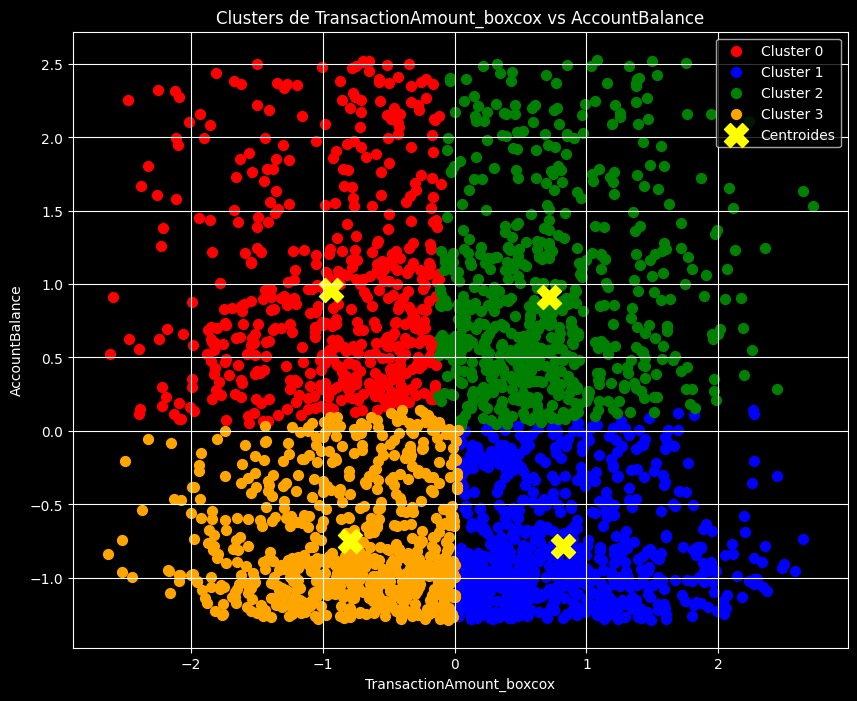

In [103]:
# Visualización de los clusters
plt.figure(figsize=(10, 8))

# Mapa de colores para los 4 clusters
colors = ['red', 'blue', 'green', 'orange']

for cluster in range(4):
    plt.scatter(
        df_modelo[df_modelo['prediccion_TA_vs_AB'] == cluster]['TransactionAmount_boxcox'],
        df_modelo[df_modelo['prediccion_TA_vs_AB'] == cluster]['AccountBalance'],
        s=50,
        c=colors[cluster],
        label=f'Cluster {cluster}'
    )

# Centroides
plt.scatter(
    kmeans.cluster_centers_[:, 0],
    kmeans.cluster_centers_[:, 1],
    s=300,
    c='yellow',
    label='Centroides',
    marker='X'
)

plt.title('Clusters de TransactionAmount_boxcox vs AccountBalance')
plt.xlabel('TransactionAmount_boxcox')
plt.ylabel('AccountBalance')
plt.legend()
plt.grid(True)
plt.show()

-  Cluster 0 - ROJO
Bajo monto de transacción, alto saldo de cuenta

- Cluster 1 -AZUL
Alto monto de Transaccion y Bajo saldo de cuenta

-  Cluster 2- VERDE
Alto monto de transacción y alto saldo de cuenta

- Cluster 3 -AMARILLO
Bajo monto de transaccion y bajo saldo de cuenta

El cluster bajo observacion es el AZUL con montos altos de la transaccion y bajo saldos de cuenta.
1. Lavado de dinero: Se usan cuentas para recibir fondos de origen sospechoso  y luego transferirlos o retirarlos.


2. Cuentas  intermediarias: Se depositan grandes montos y se retiran de inmediato o se envían a otras cuentas.
No conservan saldo porque la función principal es ser un puente.

3. Uso fraudulento de tarjetas
Transacciones grandes pueden corresponder a fraude con tarjetas robadas.
Hay solo consumo/extracción inmediata.

4. Simulación de actividad financiera (fraude contable o crediticio)
Algunos intentan simular volumen de operaciones para obtener líneas de crédito, préstamos o beneficios.
Luego desaparecen sin dejar fondos reales en la cuenta.

5. Clientes en situación de sobreendeudamiento: podría ser un cliente que gasta más de lo que tiene, usando constantemente el límite de la cuenta, anticipos o descubiertos.



In [104]:
df1

,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,CustomerAge,CustomerOccupation,TransactionDuration,LoginAttempts,AccountBalance,PreviousTransactionDate
0,TX000001,AC00128,14.09,2023-04-11 16:29:14,Debit,San Diego,D000380,162.198.218.92,M015,ATM,70,Doctor,81,1,5112.21,2024-11-04 08:08:08
1,TX000002,AC00455,376.24,2023-06-27 16:44:19,Debit,Houston,D000051,13.149.61.4,M052,ATM,68,Doctor,141,1,13758.91,2024-11-04 08:09:35
2,TX000003,AC00019,126.29,2023-07-10 18:16:08,Debit,Mesa,D000235,215.97.143.157,M009,Online,19,Student,56,1,1122.35,2024-11-04 08:07:04
3,TX000004,AC00070,184.50,2023-05-05 16:32:11,Debit,Raleigh,D000187,200.13.225.150,M002,Online,26,Student,25,1,8569.06,2024-11-04 08:09:06
4,TX000005,AC00411,13.45,2023-10-16 17:51:24,Credit,Atlanta,D000308,65.164.3.100,M091,Online,26,Student,198,1,7429.40,2024-11-04 08:06:39
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2507,TX002508,AC00297,856.21,2023-04-26 17:09:36,Credit,Colorado Springs,D000625,21.157.41.17,M072,Branch,33,Doctor,109,1,12690.79,2024-11-04 08:11:29
2508,TX002509,AC00322,251.54,2023-03-22 17:36:48,Debit,Tucson,D000410,49.174.157.140,M029,Branch,48,Doctor,177,1,254.75,2024-11-04 08:11:42
2509,TX002510,AC00095,28.63,2023-08-21 17:08:50,Debit,San Diego,D000095,58.1.27.124,M087,Branch,56,Retired,146,1,3382.91,2024-11-04 08:08:39
2510,TX002511,AC00118,185.97,2023-02-24 16:24:46,Debit,Denver,D000634,21.190.11.223,M041,Online,23,Student,19,1,1776.91,2024-11-04 08:12:22


In [105]:
df_modelo

,TransactionAmount_boxcox,CustomerAge,AccountBalance,prediccion_TA_vs_AB
0,-1.740181,1.423718,-0.000537,3
1,0.606439,1.311287,2.216472,2
2,-0.399350,-1.443277,-1.023534,3
3,-0.080648,-1.049768,0.885797,2
4,-1.760804,-1.049768,0.593589,0
...,...,...,...,...
2507,1.565663,-0.656259,1.942606,2
2508,0.203330,0.186975,-1.245986,1
2509,-1.389072,0.636700,-0.443928,3
2510,-0.073647,-1.218415,-0.855705,3


In [106]:
df_modelo.drop(columns=['AccountBalance', 'CustomerAge'], inplace=True)
df_modelo

,TransactionAmount_boxcox,prediccion_TA_vs_AB
0,-1.740181,3
1,0.606439,2
2,-0.399350,3
3,-0.080648,2
4,-1.760804,0
...,...,...
2507,1.565663,2
2508,0.203330,1
2509,-1.389072,3
2510,-0.073647,3


In [107]:
df_completo = pd.concat([df1, df_modelo], axis=1)
df_completo

,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,CustomerAge,CustomerOccupation,TransactionDuration,LoginAttempts,AccountBalance,PreviousTransactionDate,TransactionAmount_boxcox,prediccion_TA_vs_AB
0,TX000001,AC00128,14.09,2023-04-11 16:29:14,Debit,San Diego,D000380,162.198.218.92,M015,ATM,70,Doctor,81,1,5112.21,2024-11-04 08:08:08,-1.740181,3
1,TX000002,AC00455,376.24,2023-06-27 16:44:19,Debit,Houston,D000051,13.149.61.4,M052,ATM,68,Doctor,141,1,13758.91,2024-11-04 08:09:35,0.606439,2
2,TX000003,AC00019,126.29,2023-07-10 18:16:08,Debit,Mesa,D000235,215.97.143.157,M009,Online,19,Student,56,1,1122.35,2024-11-04 08:07:04,-0.399350,3
3,TX000004,AC00070,184.50,2023-05-05 16:32:11,Debit,Raleigh,D000187,200.13.225.150,M002,Online,26,Student,25,1,8569.06,2024-11-04 08:09:06,-0.080648,2
4,TX000005,AC00411,13.45,2023-10-16 17:51:24,Credit,Atlanta,D000308,65.164.3.100,M091,Online,26,Student,198,1,7429.40,2024-11-04 08:06:39,-1.760804,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2507,TX002508,AC00297,856.21,2023-04-26 17:09:36,Credit,Colorado Springs,D000625,21.157.41.17,M072,Branch,33,Doctor,109,1,12690.79,2024-11-04 08:11:29,1.565663,2
2508,TX002509,AC00322,251.54,2023-03-22 17:36:48,Debit,Tucson,D000410,49.174.157.140,M029,Branch,48,Doctor,177,1,254.75,2024-11-04 08:11:42,0.203330,1
2509,TX002510,AC00095,28.63,2023-08-21 17:08:50,Debit,San Diego,D000095,58.1.27.124,M087,Branch,56,Retired,146,1,3382.91,2024-11-04 08:08:39,-1.389072,3
2510,TX002511,AC00118,185.97,2023-02-24 16:24:46,Debit,Denver,D000634,21.190.11.223,M041,Online,23,Student,19,1,1776.91,2024-11-04 08:12:22,-0.073647,3


In [108]:
X

array([[-1.74018063e+00, -5.36635052e-04],
       [ 6.06439338e-01,  2.21647159e+00],
       [-3.99350226e-01, -1.02353413e+00],
       ...,
       [-1.38907170e+00, -4.43928023e-01],
       [-7.36474019e-02, -8.55705373e-01],
       [ 1.70899332e-01, -1.27765152e+00]])

In [109]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [110]:
df_completo['Distancia_Centroide'] = np.linalg.norm(X_scaled - kmeans.cluster_centers_[kmeans.labels_], axis=1)
df_completo

,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,CustomerAge,CustomerOccupation,TransactionDuration,LoginAttempts,AccountBalance,PreviousTransactionDate,TransactionAmount_boxcox,prediccion_TA_vs_AB,Distancia_Centroide
0,TX000001,AC00128,14.09,2023-04-11 16:29:14,Debit,San Diego,D000380,162.198.218.92,M015,ATM,70,Doctor,81,1,5112.21,2024-11-04 08:08:08,-1.740181,3,1.205408
1,TX000002,AC00455,376.24,2023-06-27 16:44:19,Debit,Houston,D000051,13.149.61.4,M052,ATM,68,Doctor,141,1,13758.91,2024-11-04 08:09:35,0.606439,2,1.307814
2,TX000003,AC00019,126.29,2023-07-10 18:16:08,Debit,Mesa,D000235,215.97.143.157,M009,Online,19,Student,56,1,1122.35,2024-11-04 08:07:04,-0.399350,3,0.482089
3,TX000004,AC00070,184.50,2023-05-05 16:32:11,Debit,Raleigh,D000187,200.13.225.150,M002,Online,26,Student,25,1,8569.06,2024-11-04 08:09:06,-0.080648,2,0.799479
4,TX000005,AC00411,13.45,2023-10-16 17:51:24,Credit,Atlanta,D000308,65.164.3.100,M091,Online,26,Student,198,1,7429.40,2024-11-04 08:06:39,-1.760804,0,0.899803
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2507,TX002508,AC00297,856.21,2023-04-26 17:09:36,Credit,Colorado Springs,D000625,21.157.41.17,M072,Branch,33,Doctor,109,1,12690.79,2024-11-04 08:11:29,1.565663,2,1.333075
2508,TX002509,AC00322,251.54,2023-03-22 17:36:48,Debit,Tucson,D000410,49.174.157.140,M029,Branch,48,Doctor,177,1,254.75,2024-11-04 08:11:42,0.203330,1,0.770924
2509,TX002510,AC00095,28.63,2023-08-21 17:08:50,Debit,San Diego,D000095,58.1.27.124,M087,Branch,56,Retired,146,1,3382.91,2024-11-04 08:08:39,-1.389072,3,0.666786
2510,TX002511,AC00118,185.97,2023-02-24 16:24:46,Debit,Denver,D000634,21.190.11.223,M041,Online,23,Student,19,1,1776.91,2024-11-04 08:12:22,-0.073647,3,0.731523


In [111]:
umbral = df_completo['Distancia_Centroide'].quantile(0.98)
fraudes_potenciales = df_completo[df_completo['Distancia_Centroide'] > umbral]

print(f"Número de posibles fraudes detectados: {len(fraudes_potenciales)}")
fraudes_potenciales


Número de posibles fraudes detectados: 51


,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,CustomerAge,CustomerOccupation,TransactionDuration,LoginAttempts,AccountBalance,PreviousTransactionDate,TransactionAmount_boxcox,prediccion_TA_vs_AB,Distancia_Centroide
34,TX000035,AC00365,255.26,2023-10-27 16:42:49,Credit,San Francisco,D000357,92.214.76.157,M002,Branch,45,Doctor,50,1,14815.87,2024-11-04 08:10:51,0.217332,2,1.651837
64,TX000065,AC00434,5.77,2023-11-02 16:01:40,Debit,Charlotte,D000461,155.164.18.235,M071,Online,50,Doctor,124,1,13988.12,2024-11-04 08:11:32,-2.088263,0,1.746706
115,TX000116,AC00468,2.50,2023-07-21 16:43:11,Debit,San Diego,D000673,44.73.3.217,M042,Online,47,Doctor,107,1,12145.27,2024-11-04 08:09:53,-2.327577,0,1.624383
135,TX000136,AC00177,16.16,2023-10-16 16:59:36,Debit,Milwaukee,D000465,161.177.41.214,M065,ATM,50,Doctor,124,1,14401.17,2024-11-04 08:11:59,-1.677699,0,1.601758
180,TX000181,AC00036,740.25,2023-07-19 17:03:58,Debit,Philadelphia,D000030,1.198.76.182,M010,Online,41,Doctor,123,1,14464.30,2024-11-04 08:08:27,1.381418,2,1.625285
190,TX000191,AC00396,1422.55,2023-07-10 17:49:18,Debit,Washington,D000569,188.124.181.12,M072,Branch,79,Retired,165,1,5674.32,2024-11-04 08:06:50,2.262707,1,1.714638
231,TX000232,AC00430,705.60,2023-02-20 18:41:43,Debit,Phoenix,D000103,205.45.234.42,M071,Branch,40,Doctor,124,3,14804.70,2024-11-04 08:09:04,1.322158,2,1.683186
234,TX000235,AC00430,5.25,2023-11-13 18:26:24,Debit,San Jose,D000571,93.170.203.44,M010,ATM,39,Doctor,49,1,14143.32,2024-11-04 08:12:22,-2.119359,0,1.797135
284,TX000285,AC00451,11.92,2023-10-09 17:48:55,Debit,San Diego,D000678,192.95.36.246,M063,Branch,53,Doctor,52,1,14611.90,2024-11-04 08:11:22,-1.813060,0,1.714773
340,TX000341,AC00107,1830.00,2023-03-01 16:31:58,Debit,San Antonio,D000436,62.27.235.199,M082,Online,55,Engineer,238,1,2235.70,2024-11-04 08:11:59,2.642217,1,1.821307


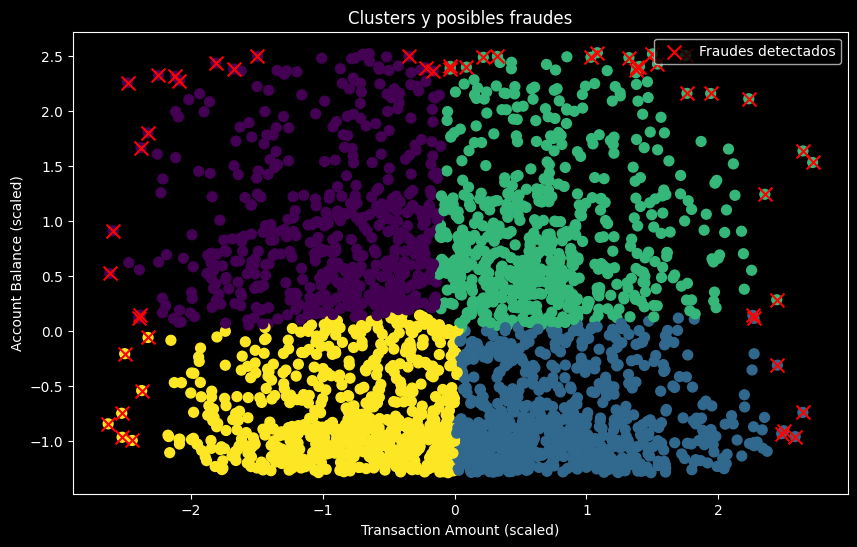

In [112]:
# Visualizar fraudes sobre los clusters
plt.figure(figsize=(10, 6))
plt.scatter(X_scaled[:, 0], X_scaled[:, 1], c=y_kmeans, cmap='viridis', s=50)
plt.scatter(fraudes_potenciales.index.map(lambda i: X_scaled[i, 0]),
            fraudes_potenciales.index.map(lambda i: X_scaled[i, 1]),
            c='red', s=100, label='Fraudes detectados', marker='x')
plt.title('Clusters y posibles fraudes')
plt.xlabel('Transaction Amount (scaled)')
plt.ylabel('Account Balance (scaled)')
plt.legend()
plt.show()


In [113]:
fraudes_potenciales.groupby(['prediccion_TA_vs_AB']).size()

,0
prediccion_TA_vs_AB,
0,16
1,7
2,21
3,7


In [114]:
import pandas as pd

# Agregamos una columna al DataFrame de fraudes con su cluster correspondiente
fraudes_potenciales = fraudes_potenciales.copy()
fraudes_potenciales['cluster'] = fraudes_potenciales.index.map(lambda i: y_kmeans[i])

# Filtrar solo los fraudes que pertenecen al cluster 1
fraudes_cluster_1 = fraudes_potenciales[fraudes_potenciales['cluster'] == 1]

# Mostrar la tabla
print("Fraudes detectados en el cluster 1:")
print(fraudes_cluster_1)

# También podés mostrar cuántos son:
print(f"\nCantidad total: {len(fraudes_cluster_1)}")


Fraudes detectados en el cluster 1:
     TransactionID AccountID  TransactionAmount     TransactionDate  \
190       TX000191   AC00396            1422.55 2023-07-10 17:49:18   
340       TX000341   AC00107            1830.00 2023-03-01 16:31:58   
1247      TX001248   AC00071            1647.74 2023-12-25 17:41:30   
1609      TX001610   AC00273            1431.33 2023-01-17 17:50:51   
1634      TX001635   AC00358            1762.28 2023-10-06 16:05:34   
1788      TX001789   AC00338            1612.37 2023-07-24 17:46:13   
2414      TX002415   AC00028            1664.33 2023-09-25 17:11:19   

     TransactionType     Location DeviceID       IP Address MerchantID  \
190            Debit   Washington  D000569   188.124.181.12       M072   
340            Debit  San Antonio  D000436    62.27.235.199       M082   
1247           Debit   Louisville  D000593  113.137.153.101       M049   
1609           Debit    Charlotte  D000434     13.88.251.53       M075   
1634           Debit     

Para n_clusters = 2, el promedio del score de silhouette es: 0.3529


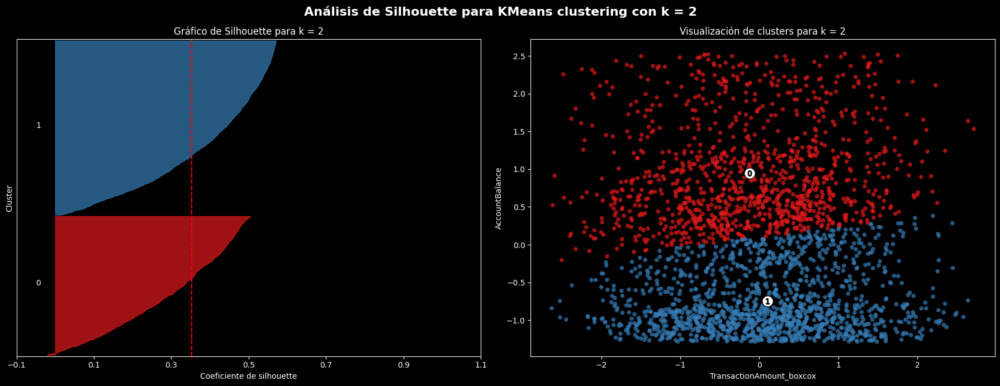

Para n_clusters = 3, el promedio del score de silhouette es: 0.3679


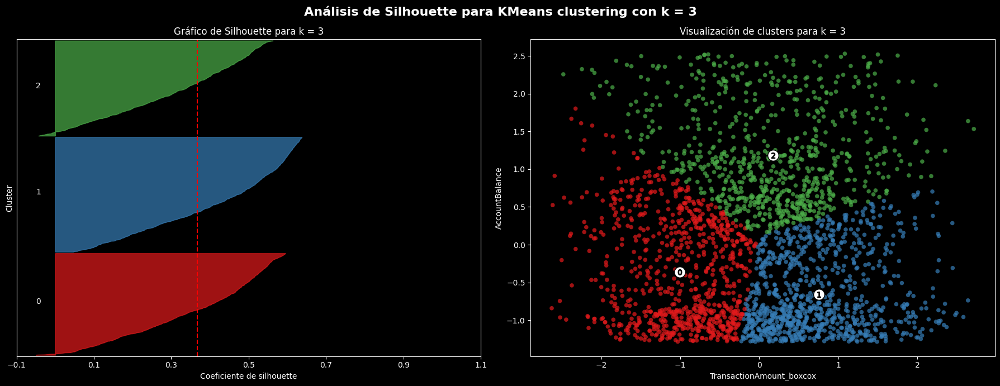

Para n_clusters = 4, el promedio del score de silhouette es: 0.3638


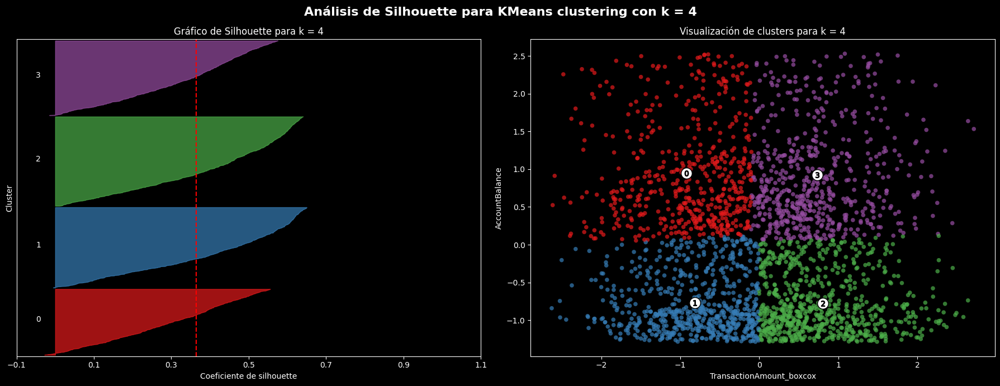

Para n_clusters = 5, el promedio del score de silhouette es: 0.3698


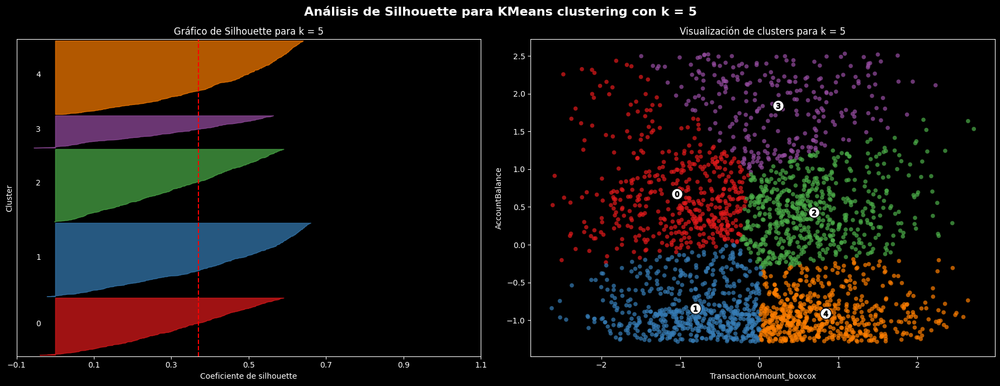

Para n_clusters = 6, el promedio del score de silhouette es: 0.3697


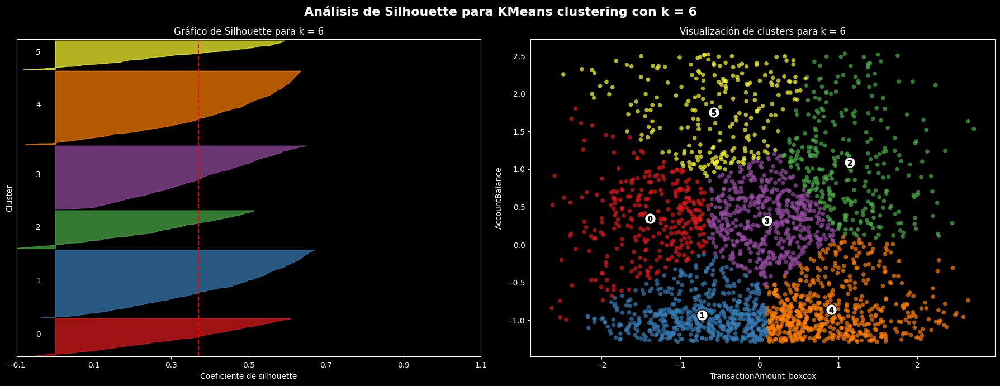

In [115]:
from sklearn.metrics import silhouette_score, silhouette_samples

my_colors = ["#e41a1c", "#377eb8", "#4daf4a", "#984ea3", "#ff7f00", "#ffff33", "#a65628"]

for n_clusters in range(2, 7):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 7))

    # --- Primer subplot: Silhouette plot ---
    ax1.set_xlim([-0.1, 1])
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    clusterer = KMeans(n_clusters=n_clusters, max_iter=1000, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    silhouette_avg = silhouette_score(X, cluster_labels)
    print(f"Para n_clusters = {n_clusters}, el promedio del score de silhouette es: {silhouette_avg:.4f}")

    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = my_colors[i % len(my_colors)]  # Rota colores si hay más clusters que colores

        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
        y_lower = y_upper + 10

    ax1.set_title(f"Gráfico de Silhouette para k = {n_clusters}")
    ax1.set_xlabel("Coeficiente de silhouette")
    ax1.set_ylabel("Cluster")
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")
    ax1.set_yticks([])
    ax1.set_xticks(np.arange(-0.1, 1.1, 0.2))

    # --- Segundo subplot: Gráfico de clusters ---
    colors = [my_colors[label % len(my_colors)] for label in cluster_labels]

    ax2.scatter(X[:, 0], X[:, 1], marker='o', s=30, lw=0, alpha=0.7,
                c=colors, edgecolors='k')  # edgecolors en plural para matplotlib reciente

    centers = clusterer.cluster_centers_
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolors='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker=f'${i}$', alpha=1,
                    s=50, edgecolors='k')

    ax2.set_title(f"Visualización de clusters para k = {n_clusters}")
    ax2.set_xlabel("TransactionAmount_boxcox")
    ax2.set_ylabel("AccountBalance")

    plt.suptitle(f"Análisis de Silhouette para KMeans clustering con k = {n_clusters}",
                 fontsize=16, fontweight='bold')

    plt.tight_layout()
    plt.show()

In [116]:
# Índice de Davies-Bouldin (DBI)
from sklearn.metrics import davies_bouldin_score
db_score = davies_bouldin_score(X, y_kmeans)
print(f"DBI: {db_score}")



DBI: 0.8886789763778862


- Valor cercano a 0: Un valor de 0 indica que los clusters son perfectamente compactos y perfectamente separados entre sí. Esto es ideal y muy difícil de lograr, pero en términos prácticos, los valores cercanos a 0 son los más deseables.

- Valor cercano a 1: Un valor cercano a 1 sugiere que los clusters son razonablemente bien separados, pero podrían haber algunas áreas de superposición o dispersión.

- Valor alto (>1): Un valor mayor a 1 indica que los clusters no están bien separados y podrían estar demasiado dispersos o solapados. A medida que el DBI aumenta, la calidad del clustering disminuye.



In [117]:
#coeficiente de variacion intercluster
k = 4  # Si tienes 4 clusters

cluster_variability = []

for i in range(k):  # Ahora 'k' está definido
    cluster_points = X[y_kmeans == i]
    distances = np.linalg.norm(cluster_points - kmeans.cluster_centers_[i], axis=1)
    cluster_variability.append(np.std(distances))

print("Variabilidad intra-cluster:", cluster_variability)


Variabilidad intra-cluster: [np.float64(0.3837768696790006), np.float64(0.30870556130033033), np.float64(0.3797482635689666), np.float64(0.2979834642237396)]


- Los valores más bajos indican que los puntos dentro de ese cluster están más cerca de su centroide, es decir, el cluster es más compacto.

- Los valores más altos indican que los puntos dentro de ese cluster están más dispersos alrededor del centroide.



Ajuste de hiperparametros

In [118]:
#GRID SEARCH


# Definimos los rangos de hiperparámetros para probar
param_grid = {
    'n_clusters': [2, 3, 4, 5, 6],  # Número de clusters a testear
    'init': ['k-means++', 'random'], # Métodos de inicialización
    'max_iter': [300, 500, 1000]     # Número de iteraciones
}

# Guardar resultados
resultados = []

# Bucle sobre todas las combinaciones posibles
for n_clusters in param_grid['n_clusters']:
    for init in param_grid['init']:
        for max_iter in param_grid['max_iter']:
            kmeans = KMeans(n_clusters=n_clusters, init=init, max_iter=max_iter, random_state=42)
            labels = kmeans.fit_predict(X)
            silhouette_avg = silhouette_score(X, labels)
            resultados.append({
                'n_clusters': n_clusters,
                'init': init,
                'max_iter': max_iter,
                'silhouette_score': silhouette_avg
            })

# Convertir resultados a DataFrame
resultados_df = pd.DataFrame(resultados)

# Ver los mejores resultados ordenados
resultados_df = resultados_df.sort_values(by='silhouette_score', ascending=False)
print(resultados_df)


    n_clusters       init  max_iter  silhouette_score
22           5     random       500          0.369962
21           5     random       300          0.369962
23           5     random      1000          0.369962
20           5  k-means++      1000          0.369747
19           5  k-means++       500          0.369747
18           5  k-means++       300          0.369747
8            3  k-means++      1000          0.367884
6            3  k-means++       300          0.367884
7            3  k-means++       500          0.367884
9            3     random       300          0.367786
11           3     random      1000          0.367786
10           3     random       500          0.367786
12           4  k-means++       300          0.363976
13           4  k-means++       500          0.363976
14           4  k-means++      1000          0.363976
15           4     random       300          0.363869
16           4     random       500          0.363869
17           4     random   

prediccion_TA_vs_AB
0    215
1    956
2    572
3    440
4    329
dtype: int64


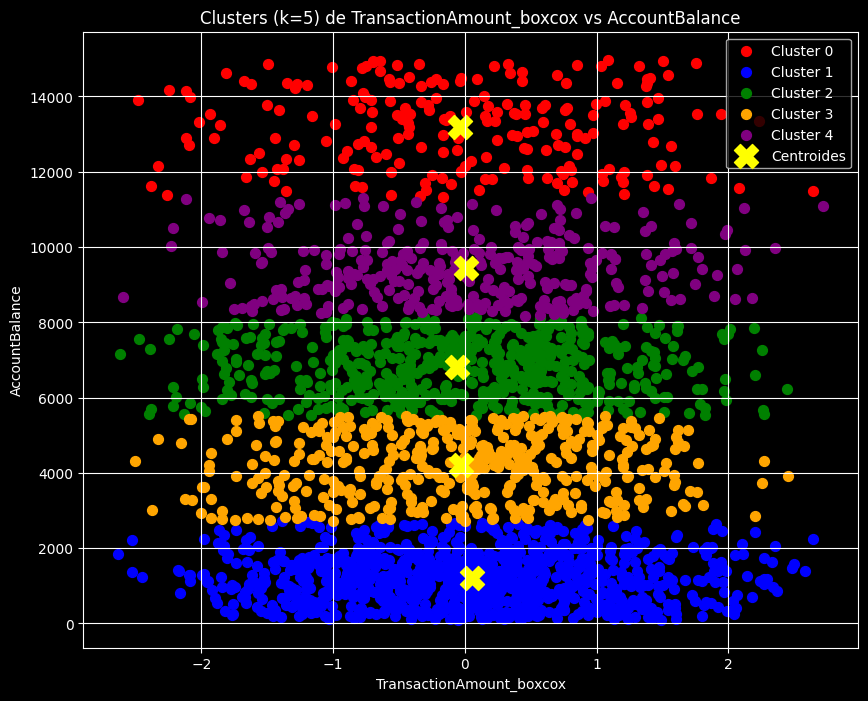


Número de posibles fraudes detectados: 51
     TransactionID AccountID  TransactionAmount     TransactionDate  \
34        TX000035   AC00365             255.26 2023-10-27 16:42:49   
52        TX000053   AC00115              85.43 2023-06-07 16:45:34   
121       TX000122   AC00358              63.34 2023-11-17 16:02:02   
125       TX000126   AC00284             214.54 2023-08-04 17:46:44   
195       TX000196   AC00363               3.30 2023-03-27 16:42:16   
211       TX000212   AC00479             432.08 2023-07-31 16:04:55   
231       TX000232   AC00430             705.60 2023-02-20 18:41:43   
233       TX000234   AC00345              91.48 2023-01-23 16:50:31   
377       TX000378   AC00232              94.30 2023-12-25 17:53:56   
518       TX000519   AC00067             167.20 2023-01-18 17:53:37   
587       TX000588   AC00429              54.25 2023-07-31 16:51:50   
633       TX000634   AC00215             135.57 2023-06-14 17:17:34   
653       TX000654   AC00423      

In [119]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import numpy as np

# --- 1. Variables transformadas (no escaladas)
X = df_completo[['TransactionAmount_boxcox', 'AccountBalance']].values

# --- 2. Entrenar K-Means con 5 clusters
kmeans = KMeans(
    n_clusters=5,
    init='random',
    max_iter=500,
    random_state=42
)

y_kmeans = kmeans.fit_predict(X)

# --- 3. Agregar predicción al DataFrame
df_completo['prediccion_TA_vs_AB'] = y_kmeans
df_modelo['prediccion_TA_vs_AB'] = y_kmeans  # si también usás df_modelo

# --- 4. Ver tamaño de cada cluster
print(df_completo.groupby('prediccion_TA_vs_AB').size())

# --- 5. Visualizar clusters
plt.figure(figsize=(10, 8))
colors = ['red', 'blue', 'green', 'orange', 'purple']

for cluster in range(5):
    plt.scatter(
        df_completo[df_completo['prediccion_TA_vs_AB'] == cluster]['TransactionAmount_boxcox'],
        df_completo[df_completo['prediccion_TA_vs_AB'] == cluster]['AccountBalance'],
        s=50,
        c=colors[cluster],
        label=f'Cluster {cluster}'
    )

# --- Centroides en el espacio original
plt.scatter(
    kmeans.cluster_centers_[:, 0],
    kmeans.cluster_centers_[:, 1],
    s=300,
    c='yellow',
    label='Centroides',
    marker='X'
)

plt.title('Clusters (k=5) de TransactionAmount_boxcox vs AccountBalance')
plt.xlabel('TransactionAmount_boxcox')
plt.ylabel('AccountBalance')
plt.legend()
plt.grid(True)
plt.show()

# --- 6. Distancia al centroide en espacio original
df_completo['Distancia_Centroide'] = np.linalg.norm(
    X - kmeans.cluster_centers_[kmeans.labels_], axis=1
)

# --- 7. Detectar fraudes (outliers del 2% más alejado)
umbral = df_completo['Distancia_Centroide'].quantile(0.98)
fraudes_potenciales = df_completo[df_completo['Distancia_Centroide'] > umbral]

print(f"\nNúmero de posibles fraudes detectados: {len(fraudes_potenciales)}")
print(fraudes_potenciales)

# --- 8. Fraudes por cluster
print(fraudes_potenciales.groupby('prediccion_TA_vs_AB').size())


In [120]:
silhouette_avg = silhouette_score(X, y_kmeans)

print(f"El Silhouette Score para k=5 es: {silhouette_avg:.4f}")

El Silhouette Score para k=5 es: 0.6103


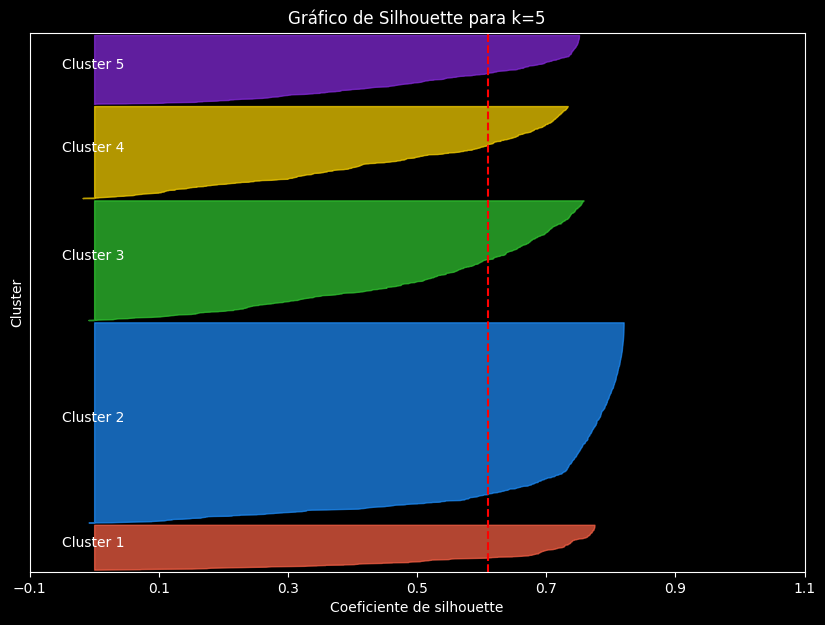

In [121]:
n_clusters = 5

# Colores personalizados para cada cluster (evitando colores oscuros como negro)
my_colors = ["#FF6347", "#1E90FF", "#32CD32", "#FFD700", "#8A2BE2"]  # Rojo, Azul, Verde, Amarillo, Púrpura

# Calculamos los valores individuales de silhouette para cada punto
sample_silhouette_values = silhouette_samples(X, y_kmeans)

fig, ax1 = plt.subplots(1, 1)
fig.set_size_inches(10, 7)

# Rango del eje X: silhouette score de -0.1 a 1
ax1.set_xlim([-0.1, 1])

# Rango del eje Y: el tamaño de los datos + espacio entre clusters
ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

y_lower = 10
for i in range(n_clusters):
    # Agarrar los silhouette scores de cada cluster
    ith_cluster_silhouette_values = sample_silhouette_values[y_kmeans == i]
    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    # Asignar un color específico de la lista
    color = my_colors[i]

    ax1.fill_betweenx(np.arange(y_lower, y_upper),
                      0, ith_cluster_silhouette_values,
                      facecolor=color, edgecolor=color, alpha=0.7)

    # Etiqueta de cluster
    ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, f'Cluster {i+1}')

    y_lower = y_upper + 10  # Dejar espacio entre clusters

# Línea vertical del silhouette promedio
silhouette_avg = silhouette_score(X, y_kmeans)
ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

# Títulos y ejes
ax1.set_title(f"Gráfico de Silhouette para k={n_clusters}")
ax1.set_xlabel("Coeficiente de silhouette")
ax1.set_ylabel("Cluster")
ax1.set_yticks([])  # Sin etiquetas en Y
ax1.set_xticks(np.arange(-0.1, 1.1, 0.2))

plt.show()

In [122]:
fraudes_potenciales.shape[0]

51

In [123]:
# Guardar los fraudes detectados en una nueva variable
resultados_kmeans_optimizado_TA_VS_AB = fraudes_potenciales.copy()

# Mostrar para confirmar
print(f"Número de fraudes detectados: {len(resultados_kmeans_optimizado_TA_VS_AB)}")
resultados_kmeans_optimizado_TA_VS_AB


Número de fraudes detectados: 51


,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,CustomerAge,CustomerOccupation,TransactionDuration,LoginAttempts,AccountBalance,PreviousTransactionDate,TransactionAmount_boxcox,prediccion_TA_vs_AB,Distancia_Centroide
34,TX000035,AC00365,255.26,2023-10-27 16:42:49,Credit,San Francisco,D000357,92.214.76.157,M002,Branch,45,Doctor,50,1,14815.87,2024-11-04 08:10:51,0.217332,0,1639.176950
52,TX000053,AC00115,85.43,2023-06-07 16:45:34,Debit,Virginia Beach,D000235,194.174.252.1,M078,Branch,67,Doctor,145,1,14904.90,2024-11-04 08:06:45,-0.697652,0,1728.207057
121,TX000122,AC00358,63.34,2023-11-17 16:02:02,Credit,Detroit,D000434,69.82.61.135,M028,Online,46,Doctor,165,1,11174.94,2024-11-04 08:10:13,-0.906766,4,1725.885776
125,TX000126,AC00284,214.54,2023-08-04 17:46:44,Credit,Detroit,D000112,195.226.203.234,M026,Online,70,Doctor,247,1,11151.53,2024-11-04 08:11:56,0.054820,4,1702.475532
195,TX000196,AC00363,3.30,2023-03-27 16:42:16,Credit,Los Angeles,D000215,116.44.12.250,M085,Branch,50,Doctor,131,1,11385.37,2024-11-04 08:10:11,-2.257024,0,1791.324446
211,TX000212,AC00479,432.08,2023-07-31 16:04:55,Debit,El Paso,D000073,40.192.99.27,M044,ATM,40,Doctor,145,1,11500.62,2024-11-04 08:11:46,0.754541,0,1676.073257
231,TX000232,AC00430,705.60,2023-02-20 18:41:43,Debit,Phoenix,D000103,205.45.234.42,M071,Branch,40,Doctor,124,3,14804.70,2024-11-04 08:09:04,1.322158,0,1628.007497
233,TX000234,AC00345,91.48,2023-01-23 16:50:31,Debit,Fort Worth,D000295,160.74.183.38,M081,ATM,51,Doctor,141,1,14942.78,2024-11-04 08:09:17,-0.647543,0,1766.087036
377,TX000378,AC00232,94.30,2023-12-25 17:53:56,Debit,Phoenix,D000446,198.39.35.23,M042,Branch,57,Doctor,57,1,11088.95,2024-11-04 08:08:14,-0.625028,4,1639.895655
518,TX000519,AC00067,167.20,2023-01-18 17:53:37,Debit,San Antonio,D000002,56.67.227.142,M036,Branch,30,Doctor,84,1,11320.83,2024-11-04 08:06:52,-0.166357,0,1855.863074


###Kmeans- TransactionAmount_boxcox y CustomerAge

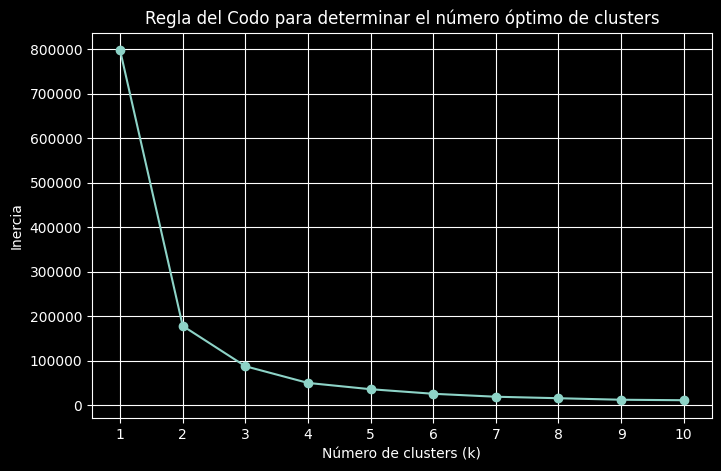

In [124]:
# Seleccionar solo las variables transformadas
X = df_completo[['TransactionAmount_boxcox',  'CustomerAge']].values

# Lista para guardar la inercia
inertia = []
K_range = range(1, 11)

# Calcular KMeans para cada valor de K
for k in K_range:
    kmeans = KMeans(n_clusters=k, random_state=0)
    kmeans.fit(X)
    inertia.append(kmeans.inertia_)

# Graficar la curva del codo
plt.figure(figsize=(8, 5))
plt.plot(K_range, inertia, marker='o')
plt.title('Regla del Codo para determinar el número óptimo de clusters')
plt.xlabel('Número de clusters (k)')
plt.ylabel('Inercia')
plt.xticks(K_range)
plt.grid(True)
plt.show()

In [125]:
print("Valores de inercia para cada k:")
for k, iner in zip(K_range, inertia):
    print(f"k = {k}: inercia = {iner:.2f}")

Valores de inercia para cada k:
k = 1: inercia = 797399.98
k = 2: inercia = 177951.26
k = 3: inercia = 87355.58
k = 4: inercia = 49809.61
k = 5: inercia = 35694.56
k = 6: inercia = 25437.90
k = 7: inercia = 18795.56
k = 8: inercia = 15438.29
k = 9: inercia = 12024.61
k = 10: inercia = 10957.21


In [126]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [127]:
# Creando el k-Means para los 2 grupos encontrados
kmeans = KMeans(n_clusters = 2, init = 'k-means++', random_state = 42)
# k-means++ acelera la convergencia, respecto de random
y_kmeans = kmeans.fit_predict(X)

centroides = kmeans.cluster_centers_

In [128]:
y_kmeans

array([0, 0, 1, ..., 0, 1, 1], dtype=int32)

In [129]:
df_completo['prediccion_CA_VS_TA'] = y_kmeans
df_completo

,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,CustomerAge,CustomerOccupation,TransactionDuration,LoginAttempts,AccountBalance,PreviousTransactionDate,TransactionAmount_boxcox,prediccion_TA_vs_AB,Distancia_Centroide,prediccion_CA_VS_TA
0,TX000001,AC00128,14.09,2023-04-11 16:29:14,Debit,San Diego,D000380,162.198.218.92,M015,ATM,70,Doctor,81,1,5112.21,2024-11-04 08:08:08,-1.740181,3,893.735868,0
1,TX000002,AC00455,376.24,2023-06-27 16:44:19,Debit,Houston,D000051,13.149.61.4,M052,ATM,68,Doctor,141,1,13758.91,2024-11-04 08:09:35,0.606439,0,582.217286,0
2,TX000003,AC00019,126.29,2023-07-10 18:16:08,Debit,Mesa,D000235,215.97.143.157,M009,Online,19,Student,56,1,1122.35,2024-11-04 08:07:04,-0.399350,1,93.538448,1
3,TX000004,AC00070,184.50,2023-05-05 16:32:11,Debit,Raleigh,D000187,200.13.225.150,M002,Online,26,Student,25,1,8569.06,2024-11-04 08:09:06,-0.080648,4,879.994473,1
4,TX000005,AC00411,13.45,2023-10-16 17:51:24,Credit,Atlanta,D000308,65.164.3.100,M091,Online,26,Student,198,1,7429.40,2024-11-04 08:06:39,-1.760804,2,606.133119,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2507,TX002508,AC00297,856.21,2023-04-26 17:09:36,Credit,Colorado Springs,D000625,21.157.41.17,M072,Branch,33,Doctor,109,1,12690.79,2024-11-04 08:11:29,1.565663,0,485.905712,1
2508,TX002509,AC00322,251.54,2023-03-22 17:36:48,Debit,Tucson,D000410,49.174.157.140,M029,Branch,48,Doctor,177,1,254.75,2024-11-04 08:11:42,0.203330,1,961.137368,0
2509,TX002510,AC00095,28.63,2023-08-21 17:08:50,Debit,San Diego,D000095,58.1.27.124,M087,Branch,56,Retired,146,1,3382.91,2024-11-04 08:08:39,-1.389072,3,835.566869,0
2510,TX002511,AC00118,185.97,2023-02-24 16:24:46,Debit,Denver,D000634,21.190.11.223,M041,Online,23,Student,19,1,1776.91,2024-11-04 08:12:22,-0.073647,1,561.022658,1


In [130]:
df_completo.groupby(['prediccion_CA_VS_TA']).size()

,0
prediccion_CA_VS_TA,
0,1274
1,1238


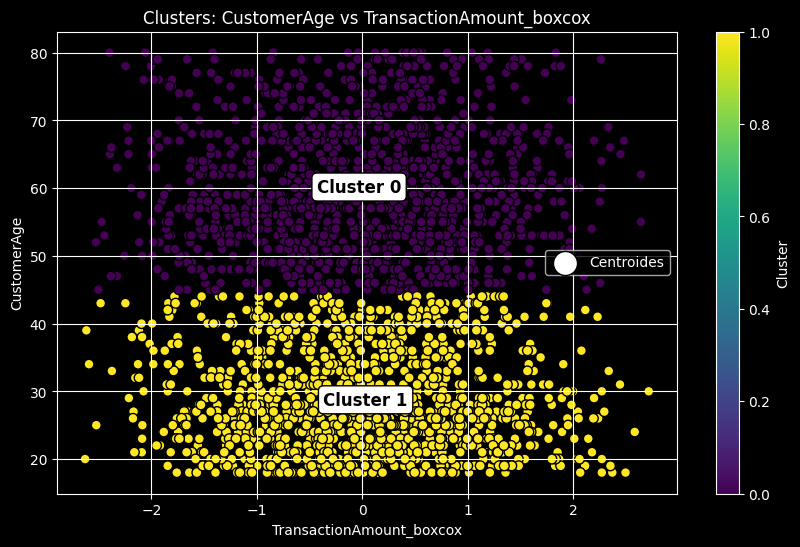

In [131]:
# --- Gráfico de los clusters con centroides ---

plt.figure(figsize=(10, 6))

# Puntos de las observaciones
plt.scatter(
    df_completo['TransactionAmount_boxcox'],
    df_completo['CustomerAge'],
    c=df_completo['prediccion_CA_VS_TA'],  # Color por cluster
    cmap='viridis',
    edgecolors='k',  # Bordes negros en los puntos
    s=50             # Tamaño de los puntos
)

# Centroides
plt.scatter(
    centroides[:, 0],  # TransactionAmount_boxcox en eje X
    centroides[:, 1],  # CustomerAge en eje Y
    marker='o',
    s=300,
    c='white',
    edgecolors='black',  # Borde negro para centroides
    label='Centroides'
)

# Etiquetas de centroides
for i, (x, y) in enumerate(centroides):
    plt.text(
        x, y, f'Cluster {i}',
        fontsize=12,
        fontweight='bold',
        ha='center',
        va='center',
        color='black',
        bbox=dict(facecolor='white', edgecolor='black', boxstyle='round,pad=0.3')
    )

plt.xlabel('TransactionAmount_boxcox')
plt.ylabel('CustomerAge')
plt.title('Clusters: CustomerAge vs TransactionAmount_boxcox')
plt.colorbar(label='Cluster')
plt.grid(True)
plt.legend()
plt.show()


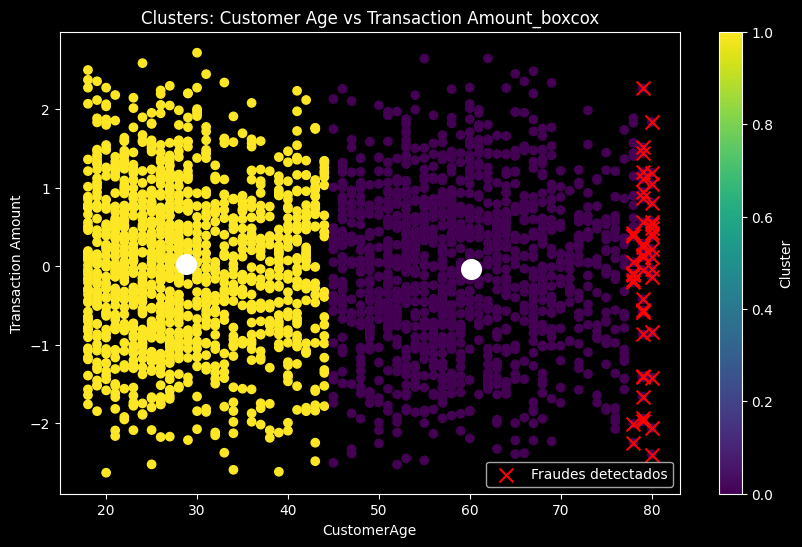

In [132]:
from scipy.spatial.distance import cdist

# Calcular las distancias a los centroides
distancias_centroides = cdist(df_completo[['CustomerAge', 'TransactionAmount_boxcox']].values, centroides)

# Obtener la distancia mínima a los centroides (distancia a su centroide más cercano)
df_completo['distancia_centroide_CA_VS_TA'] = distancias_centroides.min(axis=1)

# Definir el umbral (percentil 95 de las distancias)
umbral = df_completo['distancia_centroide_CA_VS_TA'].quantile(0.98)

# Filtrar los fraudes potenciales
fraudes_potenciales = df_completo[df_completo['distancia_centroide_CA_VS_TA'] > umbral]

# Visualizar los clusters y los posibles fraudes
plt.figure(figsize=(10, 6))

# Graficar los puntos de los clusters
plt.scatter(
    df_completo['CustomerAge'],
    df_completo['TransactionAmount_boxcox'],
    c=df_completo['prediccion_CA_VS_TA'],  # color por cluster
    cmap='viridis'
)

# Agregar los centroides como círculos blancos
plt.scatter(
    centroides[:, 1],  # CustomerAge en el eje Y
    centroides[:, 0],  # TransactionAmount_boxcox en el eje X
    marker='o',  # Cambiar a redondo
    s=200,  # Tamaño de los centroides
    c='white'  # Color blanco para los centroides
)

# Marcar los fraudes potenciales con una "x" roja
plt.scatter(
    fraudes_potenciales['CustomerAge'],
    fraudes_potenciales['TransactionAmount_boxcox'],
    c='red', s=100, label='Fraudes detectados', marker='x'
)

# Etiquetas y título del gráfico
plt.xlabel('CustomerAge')
plt.ylabel('Transaction Amount')
plt.title('Clusters: Customer Age vs Transaction Amount_boxcox')
plt.colorbar(label='Cluster')
plt.legend()
plt.show()



In [133]:
# Contar la cantidad de fraudes detectados
cantidad_fraudes = len(fraudes_potenciales)
print(f"Número de fraudes detectados: {cantidad_fraudes}")


Número de fraudes detectados: 51


In [134]:
fraudes_potenciales['CustomerAge'].min()
print(f"edad minima de posibles fraude: {fraudes_potenciales['CustomerAge'].min()}")

edad minima de posibles fraude: 78


In [135]:
fraudes_potenciales.groupby(['prediccion_CA_VS_TA']).size()

,0
prediccion_CA_VS_TA,
0,51


Para n_clusters = 2, el promedio del score de silhouette es: 0.6602


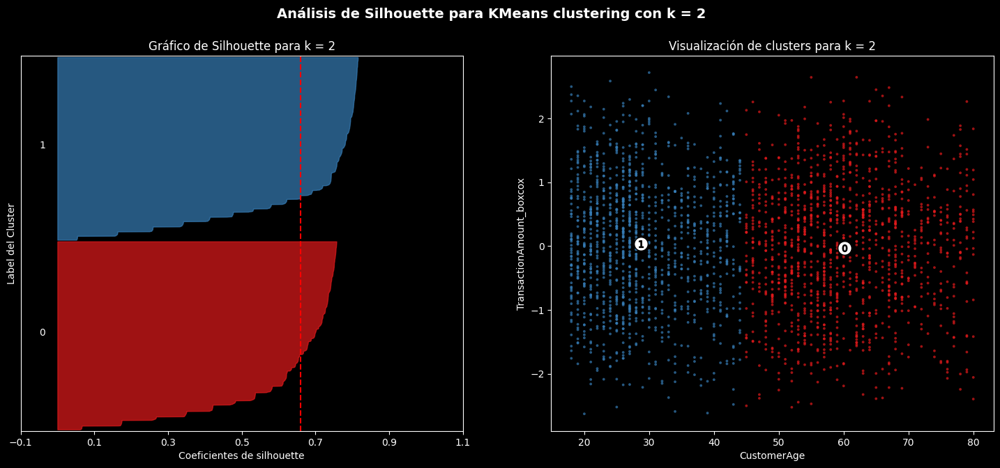

Para n_clusters = 3, el promedio del score de silhouette es: 0.5977


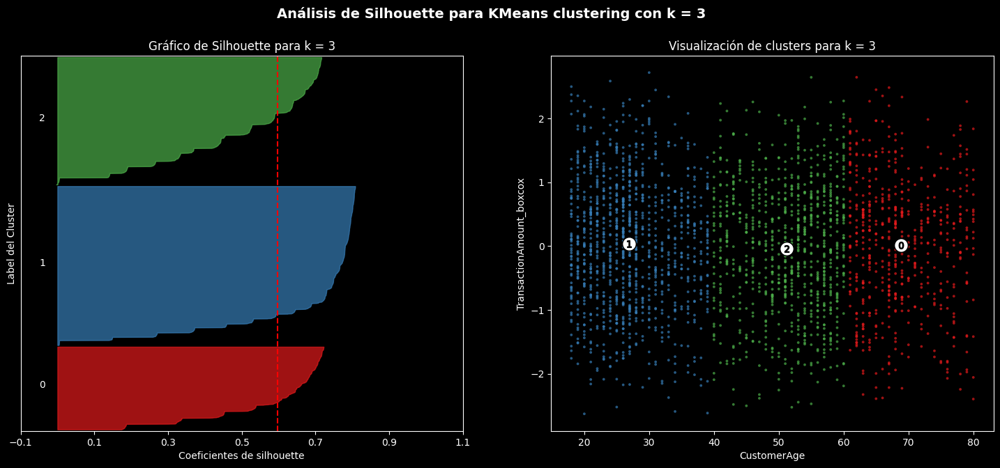

Para n_clusters = 4, el promedio del score de silhouette es: 0.5692


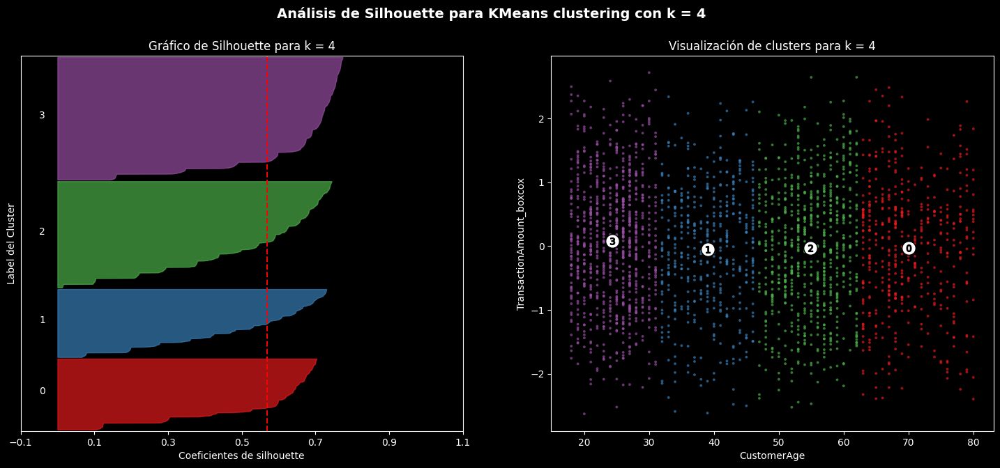

Para n_clusters = 5, el promedio del score de silhouette es: 0.5442


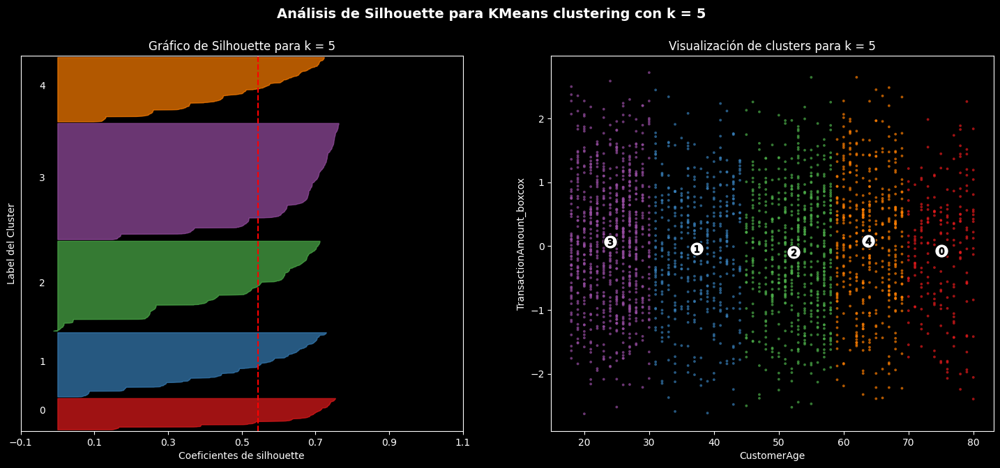

Para n_clusters = 6, el promedio del score de silhouette es: 0.5111


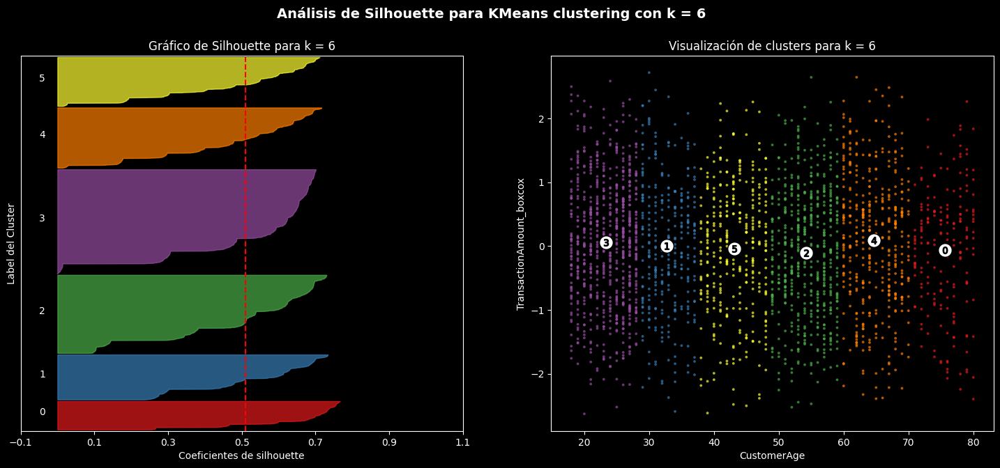

In [136]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

# Asegúrate de que df_completo esté definido antes de ejecutar el código
X = df_completo[['CustomerAge', 'TransactionAmount_boxcox']].values

my_colors = ["#e41a1c", "#377eb8", "#4daf4a", "#984ea3", "#ff7f00", "#ffff33", "#a65628"]

# Iterar sobre diferentes valores de k
for n_clusters in range(2, 7):
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    ax1.set_xlim([-0.1, 1])
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Ajustar KMeans
    clusterer = KMeans(n_clusters=n_clusters, max_iter=1000, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # Calcular el Silhouette Score
    silhouette_avg = silhouette_score(X, cluster_labels)
    print(f"Para n_clusters = {n_clusters}, el promedio del score de silhouette es: {silhouette_avg:.4f}")

    # Calcular los valores de Silhouette para cada muestra
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = my_colors[i % len(my_colors)]  # Asegura que los colores no se repitan fuera de rango

        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
        y_lower = y_upper + 10

    ax1.set_title(f"Gráfico de Silhouette para k = {n_clusters}")
    ax1.set_xlabel("Coeficientes de silhouette")
    ax1.set_ylabel("Label del Cluster")
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")
    ax1.set_yticks([])
    ax1.set_xticks(np.arange(-0.1, 1.1, 0.2))

    # Gráfico de clusters
    colors = [my_colors[label % len(my_colors)] for label in cluster_labels]

    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Mostrar los centroides de los clusters
    centers = clusterer.cluster_centers_
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker=f'${i}$', alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title(f"Visualización de clusters para k = {n_clusters}")
    ax2.set_xlabel("CustomerAge")
    ax2.set_ylabel("TransactionAmount_boxcox")

    plt.suptitle(f"Análisis de Silhouette para KMeans clustering con k = {n_clusters}",
                 fontsize=14, fontweight='bold')

    plt.show()


In [137]:
from sklearn.metrics import davies_bouldin_score
db_score = davies_bouldin_score(X, y_kmeans)
print(f"DBI: {db_score}")

DBI: 0.4505668077251948


In [138]:
#coeficiente de variacion intercluster
k = 2

cluster_variability = []

for i in range(k):  # Ahora 'k' está definido
    cluster_points = X[y_kmeans == i]
    distances = np.linalg.norm(cluster_points - kmeans.cluster_centers_[i], axis=1)
    cluster_variability.append(np.std(distances))

print("Variabilidad intra-cluster:", cluster_variability)

Variabilidad intra-cluster: [np.float64(6.576804606036031), np.float64(5.3864801818922246)]


Variabilidad intra-cluster: el Cluster 1 tiene una mayor dispersión que Cluster 2

DBI = 0.45: los clusters están bien separados valor menor a 1. se puede mejorar debe ir cercano al 0.

In [139]:
#GRID SEARCH
# Definir tu matriz de características
X = df_completo[['CustomerAge', 'TransactionAmount_boxcox']].values

# Definir los parámetros a explorar
param_grid = {
    'n_clusters': [2, 3, 4, 5, 6],
    'init': ['k-means++', 'random'],
    'max_iter': [300, 500, 1000]
}

# Guardar resultados
results = []

for n_clusters in param_grid['n_clusters']:
    for init_method in param_grid['init']:
        for max_iter in param_grid['max_iter']:
            kmeans = KMeans(n_clusters=n_clusters, init=init_method, max_iter=max_iter, random_state=42)
            cluster_labels = kmeans.fit_predict(X)

            # Silhouette Score
            silhouette_avg = silhouette_score(X, cluster_labels)

            # Davies-Bouldin Index
            dbi = davies_bouldin_score(X, cluster_labels)

            results.append({
                'n_clusters': n_clusters,
                'init': init_method,
                'max_iter': max_iter,
                'silhouette_score': silhouette_avg,
                'davies_bouldin_index': dbi
            })

# Convertir a un DataFrame
results_df = pd.DataFrame(results)

# Mostrar ordenado por mejor Silhouette Score
print("Resultados ordenados por Silhouette Score:")
print(results_df.sort_values(by='silhouette_score', ascending=False))

# También podrías ordenar por Davies-Bouldin Index (de menor a mayor)
print("\nResultados ordenados por Davies-Bouldin Index:")
print(results_df.sort_values(by='davies_bouldin_index'))

Resultados ordenados por Silhouette Score:
    n_clusters       init  max_iter  silhouette_score  davies_bouldin_index
0            2  k-means++       300          0.660157              0.450567
1            2  k-means++       500          0.660157              0.450567
2            2  k-means++      1000          0.660157              0.450567
3            2     random       300          0.660157              0.450567
4            2     random       500          0.660157              0.450567
5            2     random      1000          0.660157              0.450567
6            3  k-means++       300          0.597701              0.523351
7            3  k-means++       500          0.597701              0.523351
8            3  k-means++      1000          0.597701              0.523351
9            3     random       300          0.595973              0.530768
10           3     random       500          0.595973              0.530768
11           3     random      1000          

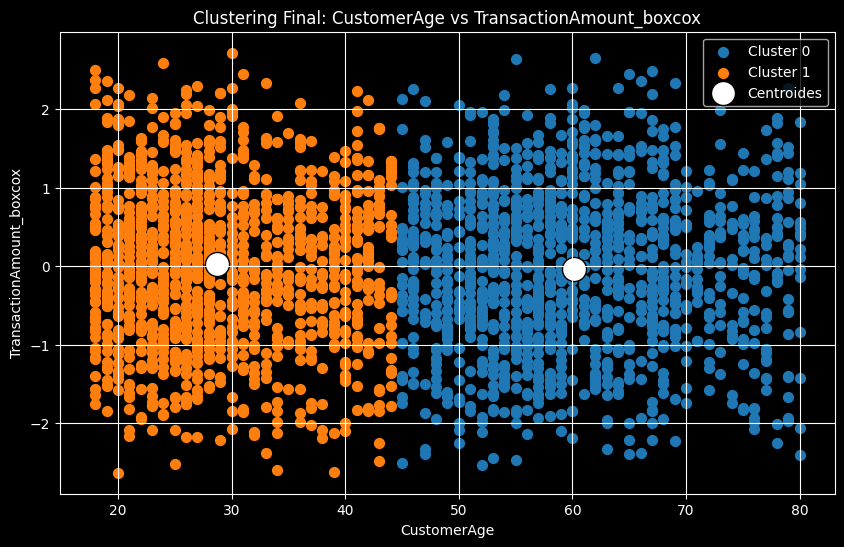

In [140]:
best_model = KMeans(
    n_clusters=2,
    init='k-means++',
    max_iter=300,
    random_state=42
)

best_model.fit(X)

cluster_labels = best_model.predict(X)

# Obtener los centroides
centroides = best_model.cluster_centers_

# Graficar
plt.figure(figsize=(10, 6))

# Colores para cada cluster
colors = ['#1f77b4', '#ff7f0e']

for cluster in range(2):
    plt.scatter(
        X[cluster_labels == cluster, 0],  # CustomerAge
        X[cluster_labels == cluster, 1],  # TransactionAmount_boxcox
        s=50,
        c=colors[cluster],
        label=f'Cluster {cluster}'
    )

# Centroides
plt.scatter(
    centroides[:, 0],
    centroides[:, 1],
    s=300,
    c='white',
    edgecolors='black',
    marker='o',
    label='Centroides'
)

plt.title('Clustering Final: CustomerAge vs TransactionAmount_boxcox')
plt.xlabel('CustomerAge')
plt.ylabel('TransactionAmount_boxcox')
plt.legend()
plt.grid(True)
plt.show()



In [141]:
from sklearn.metrics import silhouette_score

# Calcular el Silhouette Score
silhouette_avg = silhouette_score(X, cluster_labels)

print(f"Silhouette Score del modelo final: {silhouette_avg:.4f}")


Silhouette Score del modelo final: 0.6602


In [142]:
from scipy.spatial.distance import cdist

# Calcular las distancias a los centroides
distancias_centroides = cdist(df_completo[['CustomerAge', 'TransactionAmount_boxcox']].values, centroides)

# Obtener la distancia mínima a los centroides (distancia a su centroide más cercano)
df_completo['distancia_centroide_CA_VS_TA'] = distancias_centroides.min(axis=1)

# Definir el umbral (percentil 95 de las distancias)
umbral = df_completo['distancia_centroide_CA_VS_TA'].quantile(0.98)

# Filtrar los fraudes potenciales (aquellos con distancias mayores que el umbral)
fraudes_potenciales = df_completo[df_completo['distancia_centroide_CA_VS_TA'] > umbral]

# Contar la cantidad de fraudes detectados
cantidad_fraudes = len(fraudes_potenciales)

# Imprimir el número de fraudes detectados
print(f"Número de fraudes detectados: {cantidad_fraudes}")

# También puedes mostrar algunos detalles de los fraudes, por ejemplo:
fraudes_potenciales


Número de fraudes detectados: 51


,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,...,CustomerOccupation,TransactionDuration,LoginAttempts,AccountBalance,PreviousTransactionDate,TransactionAmount_boxcox,prediccion_TA_vs_AB,Distancia_Centroide,prediccion_CA_VS_TA,distancia_centroide_CA_VS_TA
61,TX000062,AC00002,263.99,2023-05-16 16:07:30,Debit,Dallas,D000285,7.146.35.122,M087,Branch,...,Retired,227,2,4175.02,2024-11-04 08:11:03,0.249598,3,43.456674,0,18.848236
141,TX000142,AC00114,1049.92,2023-10-23 16:50:33,Debit,Detroit,D000522,121.67.144.20,M052,ATM,...,Retired,21,1,2037.85,2024-11-04 08:10:34,1.835256,1,821.964577,0,19.933666
150,TX000151,AC00072,69.40,2023-07-24 18:08:43,Debit,Virginia Beach,D000413,216.151.64.40,M073,Online,...,Retired,113,1,6452.77,2024-11-04 08:09:04,-0.844593,2,370.500115,0,19.862842
186,TX000187,AC00099,1041.88,2023-09-06 16:44:02,Debit,Jacksonville,D000208,32.240.176.64,M032,Online,...,Retired,57,1,5726.20,2024-11-04 08:06:44,1.824847,2,1097.070890,0,17.942343
190,TX000191,AC00396,1422.55,2023-07-10 17:49:18,Debit,Washington,D000569,188.124.181.12,M072,Branch,...,Retired,165,1,5674.32,2024-11-04 08:06:50,2.262707,2,1148.951618,0,18.985166
263,TX000264,AC00319,512.81,2023-07-19 16:57:01,Debit,Sacramento,D000611,82.75.200.117,M004,Branch,...,Retired,30,1,6994.34,2024-11-04 08:11:58,0.945027,2,171.073655,0,18.871387
266,TX000267,AC00178,66.90,2023-04-17 16:50:45,Credit,Charlotte,D000221,138.210.196.19,M021,Online,...,Retired,129,4,5238.71,2024-11-04 08:10:39,-0.869733,3,1020.234579,0,18.864828
305,TX000306,AC00431,378.85,2023-06-16 17:21:15,Debit,Virginia Beach,D000043,192.95.36.246,M089,Branch,...,Retired,126,1,2300.53,2024-11-04 08:09:07,0.613718,1,1084.642789,0,17.857779
365,TX000366,AC00092,632.69,2023-09-12 16:28:38,Debit,Denver,D000455,211.97.88.141,M047,ATM,...,Retired,76,1,4363.74,2024-11-04 08:09:26,1.189917,3,145.269368,0,19.883645
394,TX000395,AC00326,6.30,2023-12-14 18:52:54,Debit,Columbus,D000539,210.160.90.52,M017,Branch,...,Retired,283,5,7697.68,2024-11-04 08:12:13,-2.058371,2,874.413014,0,19.949484


In [143]:
fraudes_potenciales

,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,...,CustomerOccupation,TransactionDuration,LoginAttempts,AccountBalance,PreviousTransactionDate,TransactionAmount_boxcox,prediccion_TA_vs_AB,Distancia_Centroide,prediccion_CA_VS_TA,distancia_centroide_CA_VS_TA
61,TX000062,AC00002,263.99,2023-05-16 16:07:30,Debit,Dallas,D000285,7.146.35.122,M087,Branch,...,Retired,227,2,4175.02,2024-11-04 08:11:03,0.249598,3,43.456674,0,18.848236
141,TX000142,AC00114,1049.92,2023-10-23 16:50:33,Debit,Detroit,D000522,121.67.144.20,M052,ATM,...,Retired,21,1,2037.85,2024-11-04 08:10:34,1.835256,1,821.964577,0,19.933666
150,TX000151,AC00072,69.40,2023-07-24 18:08:43,Debit,Virginia Beach,D000413,216.151.64.40,M073,Online,...,Retired,113,1,6452.77,2024-11-04 08:09:04,-0.844593,2,370.500115,0,19.862842
186,TX000187,AC00099,1041.88,2023-09-06 16:44:02,Debit,Jacksonville,D000208,32.240.176.64,M032,Online,...,Retired,57,1,5726.20,2024-11-04 08:06:44,1.824847,2,1097.070890,0,17.942343
190,TX000191,AC00396,1422.55,2023-07-10 17:49:18,Debit,Washington,D000569,188.124.181.12,M072,Branch,...,Retired,165,1,5674.32,2024-11-04 08:06:50,2.262707,2,1148.951618,0,18.985166
263,TX000264,AC00319,512.81,2023-07-19 16:57:01,Debit,Sacramento,D000611,82.75.200.117,M004,Branch,...,Retired,30,1,6994.34,2024-11-04 08:11:58,0.945027,2,171.073655,0,18.871387
266,TX000267,AC00178,66.90,2023-04-17 16:50:45,Credit,Charlotte,D000221,138.210.196.19,M021,Online,...,Retired,129,4,5238.71,2024-11-04 08:10:39,-0.869733,3,1020.234579,0,18.864828
305,TX000306,AC00431,378.85,2023-06-16 17:21:15,Debit,Virginia Beach,D000043,192.95.36.246,M089,Branch,...,Retired,126,1,2300.53,2024-11-04 08:09:07,0.613718,1,1084.642789,0,17.857779
365,TX000366,AC00092,632.69,2023-09-12 16:28:38,Debit,Denver,D000455,211.97.88.141,M047,ATM,...,Retired,76,1,4363.74,2024-11-04 08:09:26,1.189917,3,145.269368,0,19.883645
394,TX000395,AC00326,6.30,2023-12-14 18:52:54,Debit,Columbus,D000539,210.160.90.52,M017,Branch,...,Retired,283,5,7697.68,2024-11-04 08:12:13,-2.058371,2,874.413014,0,19.949484


In [144]:
# Guardar los fraudes detectados en una nueva variable
resultados_kmeans_optimizado_TA_VS_CA = fraudes_potenciales.copy()

# Mostrar para confirmar
print(f"Número de fraudes detectados: {len(resultados_kmeans_optimizado_TA_VS_CA)}")
resultados_kmeans_optimizado_TA_VS_CA

Número de fraudes detectados: 51


,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,...,CustomerOccupation,TransactionDuration,LoginAttempts,AccountBalance,PreviousTransactionDate,TransactionAmount_boxcox,prediccion_TA_vs_AB,Distancia_Centroide,prediccion_CA_VS_TA,distancia_centroide_CA_VS_TA
61,TX000062,AC00002,263.99,2023-05-16 16:07:30,Debit,Dallas,D000285,7.146.35.122,M087,Branch,...,Retired,227,2,4175.02,2024-11-04 08:11:03,0.249598,3,43.456674,0,18.848236
141,TX000142,AC00114,1049.92,2023-10-23 16:50:33,Debit,Detroit,D000522,121.67.144.20,M052,ATM,...,Retired,21,1,2037.85,2024-11-04 08:10:34,1.835256,1,821.964577,0,19.933666
150,TX000151,AC00072,69.40,2023-07-24 18:08:43,Debit,Virginia Beach,D000413,216.151.64.40,M073,Online,...,Retired,113,1,6452.77,2024-11-04 08:09:04,-0.844593,2,370.500115,0,19.862842
186,TX000187,AC00099,1041.88,2023-09-06 16:44:02,Debit,Jacksonville,D000208,32.240.176.64,M032,Online,...,Retired,57,1,5726.20,2024-11-04 08:06:44,1.824847,2,1097.070890,0,17.942343
190,TX000191,AC00396,1422.55,2023-07-10 17:49:18,Debit,Washington,D000569,188.124.181.12,M072,Branch,...,Retired,165,1,5674.32,2024-11-04 08:06:50,2.262707,2,1148.951618,0,18.985166
263,TX000264,AC00319,512.81,2023-07-19 16:57:01,Debit,Sacramento,D000611,82.75.200.117,M004,Branch,...,Retired,30,1,6994.34,2024-11-04 08:11:58,0.945027,2,171.073655,0,18.871387
266,TX000267,AC00178,66.90,2023-04-17 16:50:45,Credit,Charlotte,D000221,138.210.196.19,M021,Online,...,Retired,129,4,5238.71,2024-11-04 08:10:39,-0.869733,3,1020.234579,0,18.864828
305,TX000306,AC00431,378.85,2023-06-16 17:21:15,Debit,Virginia Beach,D000043,192.95.36.246,M089,Branch,...,Retired,126,1,2300.53,2024-11-04 08:09:07,0.613718,1,1084.642789,0,17.857779
365,TX000366,AC00092,632.69,2023-09-12 16:28:38,Debit,Denver,D000455,211.97.88.141,M047,ATM,...,Retired,76,1,4363.74,2024-11-04 08:09:26,1.189917,3,145.269368,0,19.883645
394,TX000395,AC00326,6.30,2023-12-14 18:52:54,Debit,Columbus,D000539,210.160.90.52,M017,Branch,...,Retired,283,5,7697.68,2024-11-04 08:12:13,-2.058371,2,874.413014,0,19.949484


###Kmeans TransactionAmount-boxcox, AccountBalance, CustomerAge

In [145]:
# Seleccionar variables
X = df_completo[['TransactionAmount_boxcox', 'AccountBalance', 'CustomerAge']].values

# Estandarizar
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

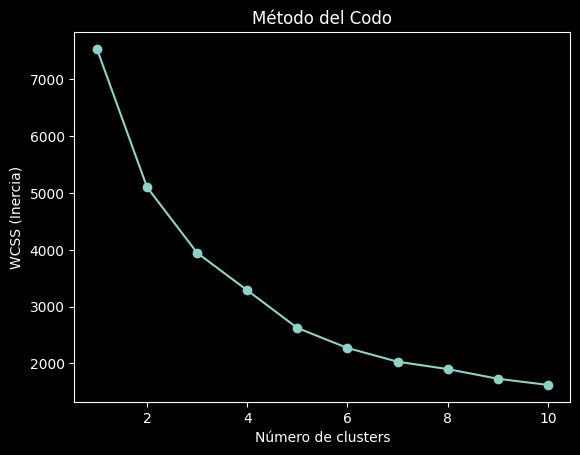

In [146]:
plt.style.use('dark_background')

# Método del codo
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42)
    kmeans.fit(X_scaled)
    wcss.append(kmeans.inertia_)

# Graficar
plt.plot(range(1, 11), wcss, marker='o')
plt.title('Método del Codo', color='white')
plt.xlabel('Número de clusters', color='white')
plt.ylabel('WCSS (Inercia)', color='white')
plt.xticks(color='white')
plt.yticks(color='white')
plt.show()

In [147]:
kmeans = KMeans(n_clusters=6, init='k-means++', random_state=42)
y_kmeans = kmeans.fit_predict(X_scaled)

# Guardar en el dataframe
df_completo['cluster_TA_AB_CA'] = y_kmeans

In [148]:
print(df_completo['cluster_TA_AB_CA'].value_counts())


cluster_TA_AB_CA
4    502
5    442
2    439
1    403
3    388
0    338
Name: count, dtype: int64


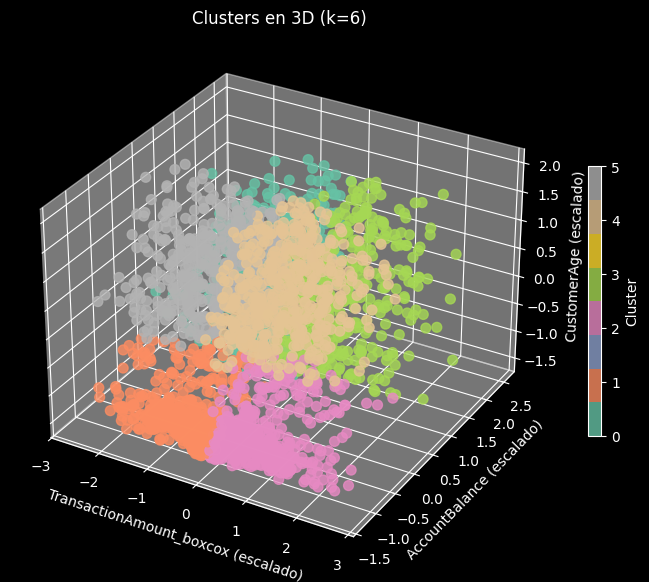

In [149]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# Escalar las variables nuevamente si no lo hiciste antes
X = df_completo[['CustomerAge', 'TransactionAmount_boxcox', 'AccountBalance']].copy()
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Aplicar KMeans con k=6
kmeans6 = KMeans(n_clusters=6, random_state=42)
labels = kmeans6.fit_predict(X_scaled)

# Gráfico 3D
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(
    X_scaled[:, 1],  # TransactionAmount_boxcox
    X_scaled[:, 2],  # AccountBalance
    X_scaled[:, 0],  # CustomerAge
    c=labels,
    cmap='Set2',
    s=50,
    alpha=0.8
)

ax.set_title('Clusters en 3D (k=6)')
ax.set_xlabel('TransactionAmount_boxcox (escalado)')
ax.set_ylabel('AccountBalance (escalado)')
ax.set_zlabel('CustomerAge (escalado)')

plt.colorbar(scatter, ax=ax, shrink=0.5, label='Cluster')
plt.show()


el cluster rosa  podría ser sospechoso. Es un grupo con:

Montos altos

Saldos bajos

Edad baja

jóvenes con cuentas casi vacías haciendo transacciones inusualmente grandes.

In [150]:
df_completo.groupby('cluster_TA_AB_CA')[['TransactionAmount_boxcox', 'AccountBalance', 'CustomerAge']].mean()


,TransactionAmount_boxcox,AccountBalance,CustomerAge
cluster_TA_AB_CA,,,
0,-0.852877,10176.267101,43.405325
1,-0.800086,1656.855881,26.163772
2,0.806239,1690.506720,25.790433
3,0.768613,9709.209562,45.041237
4,0.739608,4247.703586,61.910359
5,-0.933794,4747.024638,61.377828


In [151]:
df_completo

,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,...,TransactionDuration,LoginAttempts,AccountBalance,PreviousTransactionDate,TransactionAmount_boxcox,prediccion_TA_vs_AB,Distancia_Centroide,prediccion_CA_VS_TA,distancia_centroide_CA_VS_TA,cluster_TA_AB_CA
0,TX000001,AC00128,14.09,2023-04-11 16:29:14,Debit,San Diego,D000380,162.198.218.92,M015,ATM,...,81,1,5112.21,2024-11-04 08:08:08,-1.740181,3,893.735868,0,9.993478,5
1,TX000002,AC00455,376.24,2023-06-27 16:44:19,Debit,Houston,D000051,13.149.61.4,M052,ATM,...,141,1,13758.91,2024-11-04 08:09:35,0.606439,0,582.217286,0,7.871968,3
2,TX000003,AC00019,126.29,2023-07-10 18:16:08,Debit,Mesa,D000235,215.97.143.157,M009,Online,...,56,1,1122.35,2024-11-04 08:07:04,-0.399350,1,93.538448,1,9.753460,1
3,TX000004,AC00070,184.50,2023-05-05 16:32:11,Debit,Raleigh,D000187,200.13.225.150,M002,Online,...,25,1,8569.06,2024-11-04 08:09:06,-0.080648,4,879.994473,1,2.746230,0
4,TX000005,AC00411,13.45,2023-10-16 17:51:24,Credit,Atlanta,D000308,65.164.3.100,M091,Online,...,198,1,7429.40,2024-11-04 08:06:39,-1.760804,2,606.133119,1,3.277397,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2507,TX002508,AC00297,856.21,2023-04-26 17:09:36,Credit,Colorado Springs,D000625,21.157.41.17,M072,Branch,...,109,1,12690.79,2024-11-04 08:11:29,1.565663,0,485.905712,1,4.524146,3
2508,TX002509,AC00322,251.54,2023-03-22 17:36:48,Debit,Tucson,D000410,49.174.157.140,M029,Branch,...,177,1,254.75,2024-11-04 08:11:42,0.203330,1,961.137368,0,12.156096,4
2509,TX002510,AC00095,28.63,2023-08-21 17:08:50,Debit,San Diego,D000095,58.1.27.124,M087,Branch,...,146,1,3382.91,2024-11-04 08:08:39,-1.389072,3,835.566869,0,4.370359,5
2510,TX002511,AC00118,185.97,2023-02-24 16:24:46,Debit,Denver,D000634,21.190.11.223,M041,Online,...,19,1,1776.91,2024-11-04 08:12:22,-0.073647,1,561.022658,1,5.744903,1


Para n_clusters = 2, el promedio del score de silhouette es: 0.3085


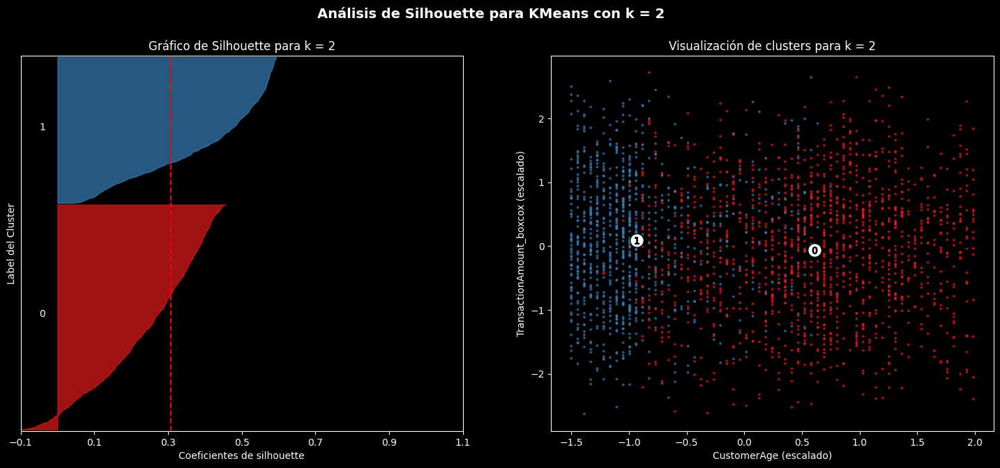

Para n_clusters = 3, el promedio del score de silhouette es: 0.3119


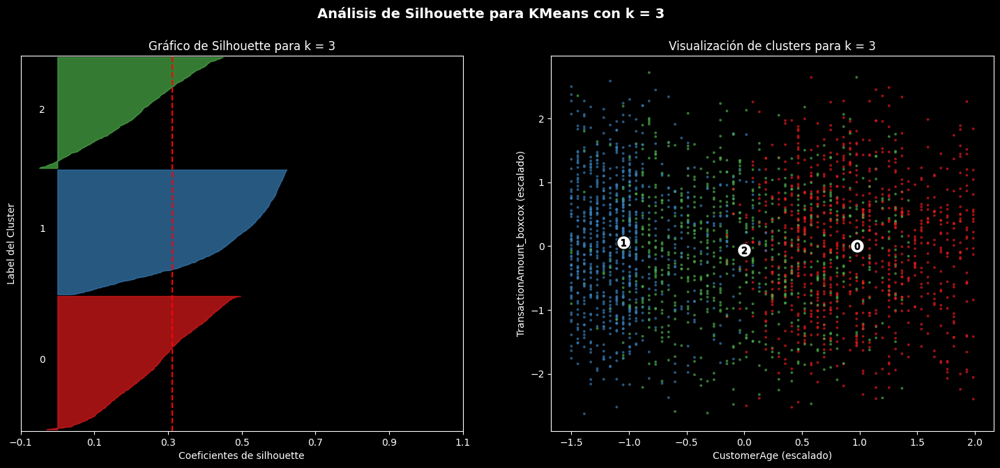

Para n_clusters = 4, el promedio del score de silhouette es: 0.3154


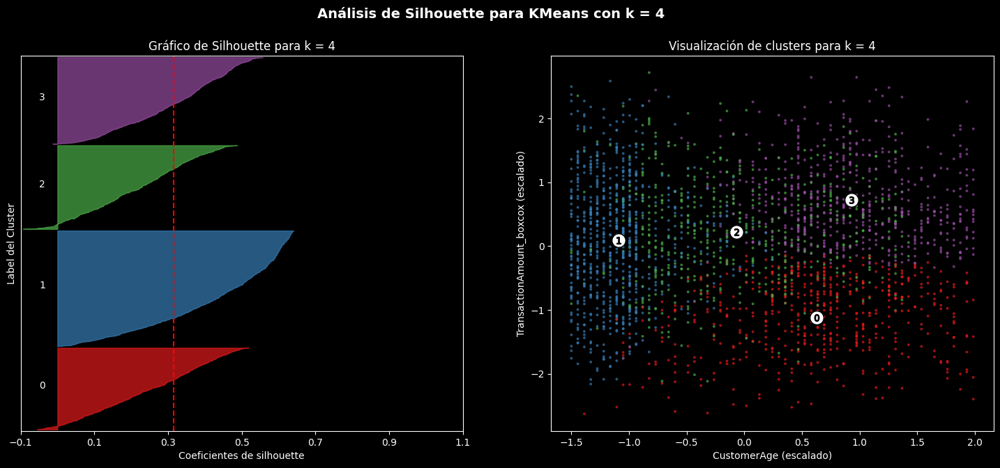

Para n_clusters = 5, el promedio del score de silhouette es: 0.2962


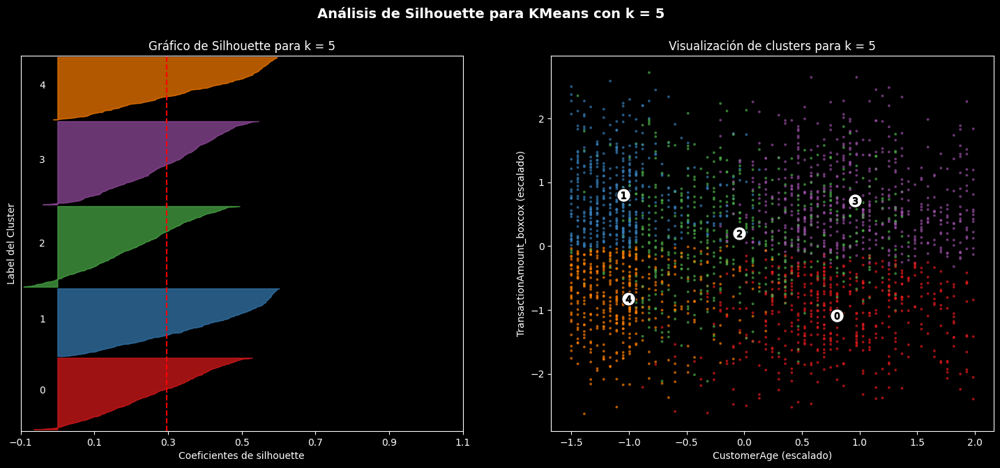

Para n_clusters = 6, el promedio del score de silhouette es: 0.3030


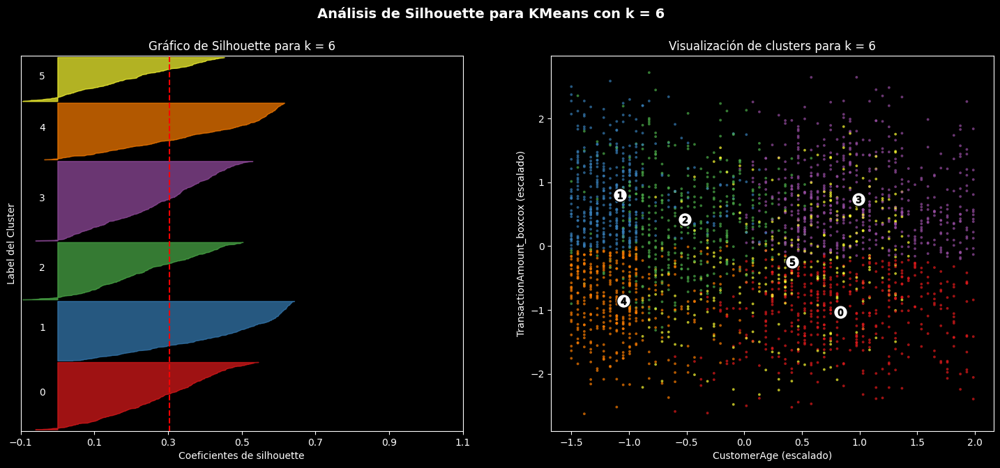

In [152]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np
from sklearn.preprocessing import StandardScaler

# Selección y escalado de variables
X = df_completo[['CustomerAge', 'TransactionAmount_boxcox', 'AccountBalance']].copy()
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Para graficar en 2D usaremos las primeras dos variables escaladas
X_plot = X_scaled[:, [0, 1]]  # CustomerAge y TransactionAmount_boxcox

# Colores personalizados
my_colors = ["#e41a1c", "#377eb8", "#4daf4a", "#984ea3", "#ff7f00", "#ffff33", "#a65628"]

# Iterar sobre diferentes valores de k
for n_clusters in range(2, 7):
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    ax1.set_xlim([-0.1, 1])
    ax1.set_ylim([0, len(X_scaled) + (n_clusters + 1) * 10])

    # Ajustar KMeans
    clusterer = KMeans(n_clusters=n_clusters, max_iter=1000, random_state=10)
    cluster_labels = clusterer.fit_predict(X_scaled)

    # Calcular el Silhouette Score
    silhouette_avg = silhouette_score(X_scaled, cluster_labels)
    print(f"Para n_clusters = {n_clusters}, el promedio del score de silhouette es: {silhouette_avg:.4f}")

    # Calcular los valores de Silhouette para cada muestra
    sample_silhouette_values = silhouette_samples(X_scaled, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = my_colors[i % len(my_colors)]

        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
        y_lower = y_upper + 10

    ax1.set_title(f"Gráfico de Silhouette para k = {n_clusters}")
    ax1.set_xlabel("Coeficientes de silhouette")
    ax1.set_ylabel("Label del Cluster")
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")
    ax1.set_yticks([])
    ax1.set_xticks(np.arange(-0.1, 1.1, 0.2))

    # Gráfico de clusters (solo con dos dimensiones para visualizar)
    colors = [my_colors[label % len(my_colors)] for label in cluster_labels]

    ax2.scatter(X_plot[:, 0], X_plot[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Mostrar los centroides (proyectados a 2D)
    centers = clusterer.cluster_centers_
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker=f'${i}$', alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title(f"Visualización de clusters para k = {n_clusters}")
    ax2.set_xlabel("CustomerAge (escalado)")
    ax2.set_ylabel("TransactionAmount_boxcox (escalado)")

    plt.suptitle(f"Análisis de Silhouette para KMeans con k = {n_clusters}",
                 fontsize=14, fontweight='bold')

    plt.show()


In [153]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

kmeans = KMeans(n_clusters=6, random_state=42)
y_kmeans = kmeans.fit_predict(X_pca)

silhouette_avg = silhouette_score(X_pca, y_kmeans)
print(f"Silhouette score usando PCA: {silhouette_avg:.4f}")


Silhouette score usando PCA: 0.3689


Aunque PCA ayudó un poco, la combinación de esas tres variables juntas no es óptima para clustering.
Los datos no tienen grupos muy bien definidos teniendo en cta estas 3 variables.

#DBSCAN

##DBSCAN TransactionAmount_boxcox VS CustomerAge

In [154]:
!pip install kneed


In [155]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt
import numpy as np
from kneed import KneeLocator

In [156]:
#Seleccion de la variable
X = df_completo[['TransactionAmount_boxcox', 'CustomerAge']].values
X

array([[-1.74018063, 70.        ],
       [ 0.60643934, 68.        ],
       [-0.39935023, 19.        ],
       ...,
       [-1.3890717 , 56.        ],
       [-0.0736474 , 23.        ],
       [ 0.17089933, 24.        ]])

In [157]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

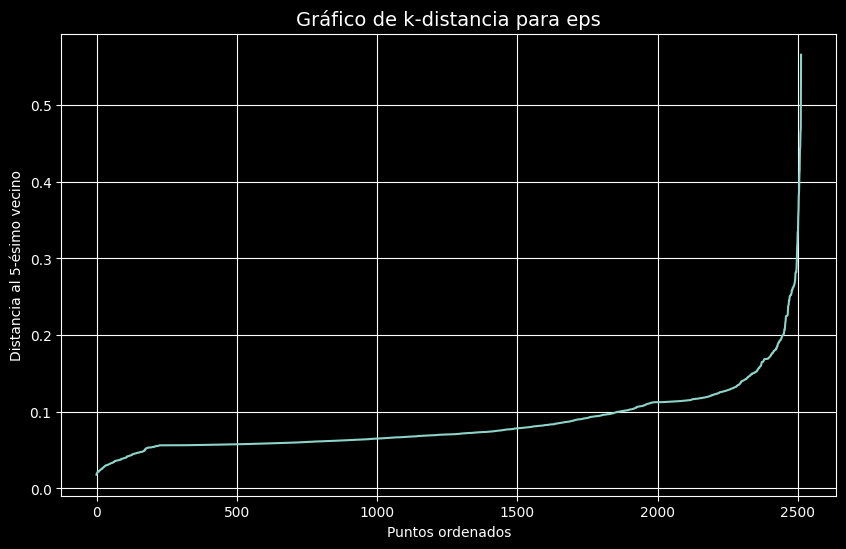


Valor óptimo de eps encontrado automáticamente: 0.2252


In [158]:
# Calcular vecinos más cercanos
k = 5  # típico min_samples
neighbors = NearestNeighbors(n_neighbors=k)
neighbors_fit = neighbors.fit(X_scaled)
distances, indices = neighbors_fit.kneighbors(X_scaled)

# Ordenar distancias
distances = np.sort(distances[:, k-1])

# Gráfica
plt.figure(figsize=(10, 6))
plt.plot(distances)
plt.title('Gráfico de k-distancia para eps', fontsize=14)
plt.xlabel('Puntos ordenados')
plt.ylabel(f'Distancia al {k}-ésimo vecino')
plt.grid(True)
plt.show()

# Encontrar el "codo" automáticamente
kneedle = KneeLocator(range(len(distances)), distances, S=1.0, curve="convex", direction="increasing")
optimal_eps = distances[kneedle.knee] if kneedle.knee is not None else None

if optimal_eps:
    print(f"\nValor óptimo de eps encontrado automáticamente: {optimal_eps:.4f}")
else:
    print("\nNo se encontró un codo claro. Elige eps manualmente del gráfico.")


In [159]:
# Entrenamiento del Modelo
from sklearn.cluster import DBSCAN
dbscan = DBSCAN(eps=0.2252, min_samples=5)
dbscan_labels = dbscan.fit_predict(X_scaled)

In [160]:
#agrego etiquetas al dataframe
df_completo['DBSCAN_Cluster_TA_VS_CA'] = dbscan_labels

In [161]:
#  Asignoo nombres descriptivos
# Identifico etiquetas únicas
unique_labels = np.unique(dbscan_labels)

# Crear mapeo dinámico
label_mapping = {}
for i, label in enumerate(unique_labels):
    if label == -1:
        label_mapping[label] = 'Fraude'
    elif i == 1:
        label_mapping[label] = 'Normal'
    else:
        label_mapping[label] = f'Grupo Sospechoso{i - 1}'

# Aplicar mapeo
df_completo['DBSCAN_Cluster_Etiqueta'] = df_completo['DBSCAN_Cluster_TA_VS_CA'].map(label_mapping)

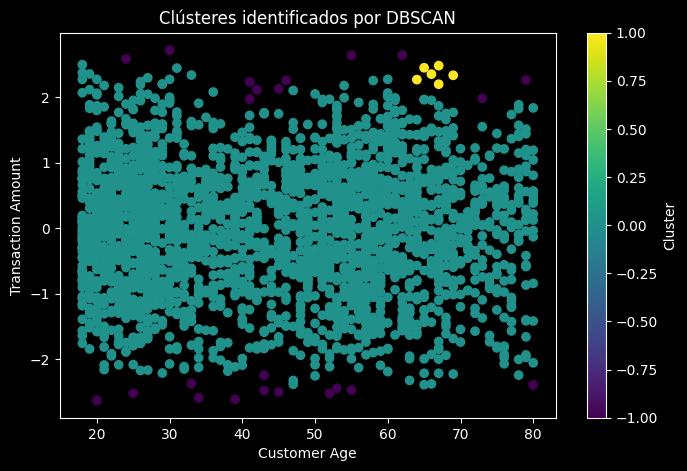

In [162]:
plt.figure(figsize=(8,5))
plt.scatter(df_completo['CustomerAge'], df_completo['TransactionAmount_boxcox'], c=dbscan_labels, cmap='viridis')
plt.xlabel('Customer Age')
plt.ylabel('Transaction Amount')
plt.title('Clústeres identificados por DBSCAN')
plt.colorbar(label='Cluster')
plt.show()


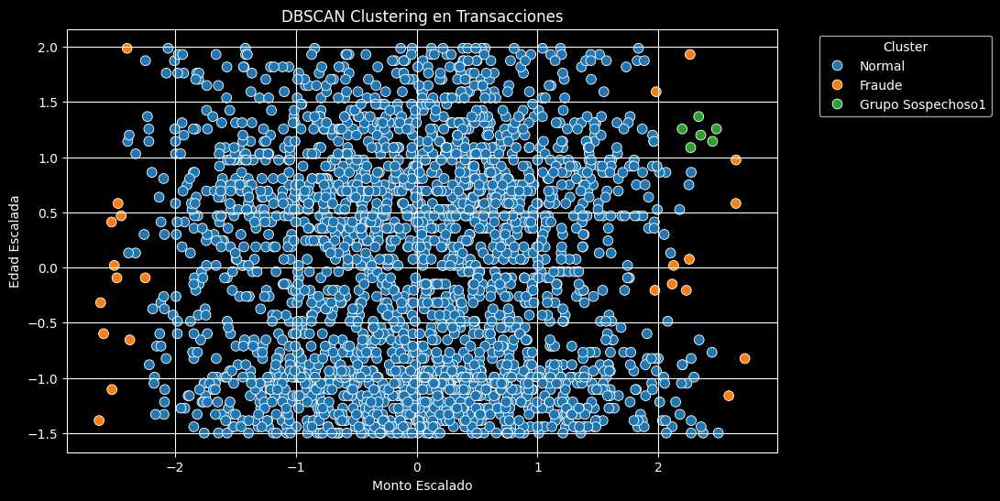

In [163]:
plt.figure(figsize=(10, 6))
sns.scatterplot(
    x=X_scaled[:, 0],
    y=X_scaled[:, 1],
    hue=df_completo['DBSCAN_Cluster_Etiqueta'],
    palette='tab10',
    s=60
)
plt.title('DBSCAN Clustering en Transacciones')
plt.xlabel('Monto Escalado')
plt.ylabel('Edad Escalada')
plt.legend(title='Cluster',  bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

Los puntos con Cluster_DBSCAN == -1 son los anómalos o ruido según DBSCAN, posibles candidatos a fraude.

In [164]:
df_fraude = df_completo[df_completo['DBSCAN_Cluster_Etiqueta'] == 'Fraude'].shape
print(f"Cantidad de Fraudes detectados: {df_fraude[0]}")

Cantidad de Fraudes detectados: 23


In [165]:
porc_fraude = (df_completo['DBSCAN_Cluster_TA_VS_CA'] == -1).mean()
print(f"Porcentaje de Fraudes detectados: {porc_fraude * 100:.2f}%")


Porcentaje de Fraudes detectados: 0.92%


In [166]:
from sklearn.metrics import silhouette_score

# Considerá sólo los puntos que no son ruido
mask = dbscan_labels != -1
if mask.sum() > 1:
    sil_score = silhouette_score(X_scaled[mask], dbscan_labels[mask])
    print(f"Silhouette Score (sin ruido): {sil_score:.3f}")
else:
    print("Muy pocos puntos para calcular Silhouette Score.")


Silhouette Score (sin ruido): 0.319


In [167]:
df_fraude = df_completo[df_completo['DBSCAN_Cluster_Etiqueta'] == 'Fraude']
df_fraude.describe()


,TransactionAmount,TransactionDate,CustomerAge,TransactionDuration,LoginAttempts,AccountBalance,PreviousTransactionDate,TransactionAmount_boxcox,prediccion_TA_vs_AB,Distancia_Centroide,prediccion_CA_VS_TA,distancia_centroide_CA_VS_TA,cluster_TA_AB_CA,DBSCAN_Cluster_TA_VS_CA
count,23.000000,23,23.000000,23.000000,23.0,23.000000,23,23.000000,23.000000,23.000000,23.000000,23.000000,23.000000,23.0
mean,717.190000,2023-08-13 01:19:39.739130368,46.086957,146.956522,1.0,6470.946957,2024-11-04 08:09:50.695652352,-0.186209,1.826087,729.480635,0.521739,10.364432,2.782609,-1.0
min,0.260000,2023-01-16 17:00:11,20.000000,28.000000,1.0,1244.170000,2024-11-04 08:06:27,-2.629493,0.000000,28.392864,0.000000,2.964365,0.000000,-1.0
25%,1.065000,2023-06-20 05:06:53,36.500000,102.000000,1.0,2221.620000,2024-11-04 08:08:49,-2.493083,1.000000,247.378802,0.000000,5.754456,1.000000,-1.0
50%,3.420000,2023-08-21 17:19:06,43.000000,150.000000,1.0,5674.320000,2024-11-04 08:09:57,-2.247317,2.000000,719.474781,1.000000,10.592576,3.000000,-1.0
75%,1404.615000,2023-10-18 04:22:28.500000,54.000000,172.500000,1.0,10484.825000,2024-11-04 08:11:34.500000,2.244164,3.000000,1084.383775,1.000000,14.387246,4.000000,-1.0
max,1919.110000,2024-01-01 16:45:56,80.000000,297.000000,1.0,14180.210000,2024-11-04 08:12:22,2.716535,4.000000,1678.685209,1.000000,19.986848,5.000000,-1.0
std,788.087896,NaN,16.211424,76.925866,0.0,4453.746904,NaN,2.462776,1.370208,523.182256,0.510754,5.045249,1.807975,0.0


In [168]:
#AJUSTE DE HIPERPARAMETROS
from sklearn.metrics import silhouette_score
import numpy as np

best_score = -1
best_params = {}

eps_values = np.arange(0.15, 0.35, 0.01)   # Puedes ajustar el rango
min_samples_values = range(3, 10)           # También puedes ampliar

results = []

for eps in eps_values:
    for min_samples in min_samples_values:
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        labels = dbscan.fit_predict(X_scaled)

        # Filtrar ruido
        mask = labels != -1
        if np.sum(mask) > 1 and len(set(labels[mask])) > 1:
            score = silhouette_score(X_scaled[mask], labels[mask])
            results.append((eps, min_samples, score))
            if score > best_score:
                best_score = score
                best_params = {'eps': eps, 'min_samples': min_samples}

print(f"\nMejores parámetros encontrados:")
print(f"eps = {best_params['eps']:.4f}")
print(f"min_samples = {best_params['min_samples']}")
print(f"Silhouette Score = {best_score:.4f}")

# Opcional: mostrar todos los resultados
import pandas as pd
df_results = pd.DataFrame(results, columns=['eps', 'min_samples', 'silhouette_score'])
print(df_results.sort_values(by='silhouette_score', ascending=False))



Mejores parámetros encontrados:
eps = 0.2000
min_samples = 6
Silhouette Score = 0.3259
     eps  min_samples  silhouette_score
38  0.20            6          0.325928
45  0.21            6          0.324785
51  0.22            6          0.323320
55  0.23            6          0.321023
58  0.24            6          0.320610
..   ...          ...               ...
5   0.15            8         -0.184714
10  0.16            6         -0.199402
9   0.16            5         -0.229241
1   0.15            4         -0.249255
2   0.15            5         -0.347255

[63 rows x 3 columns]


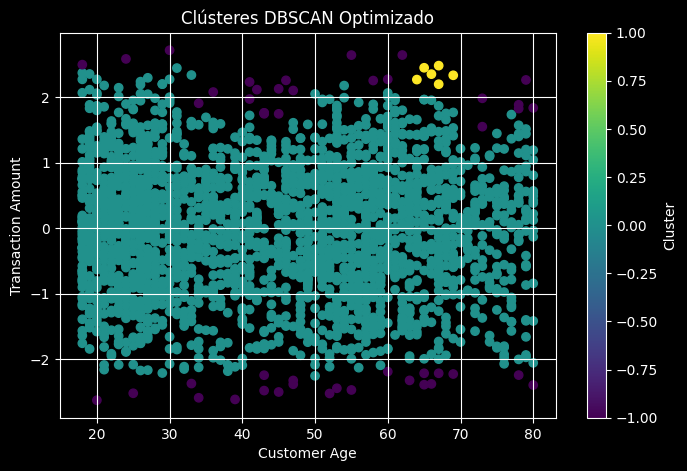

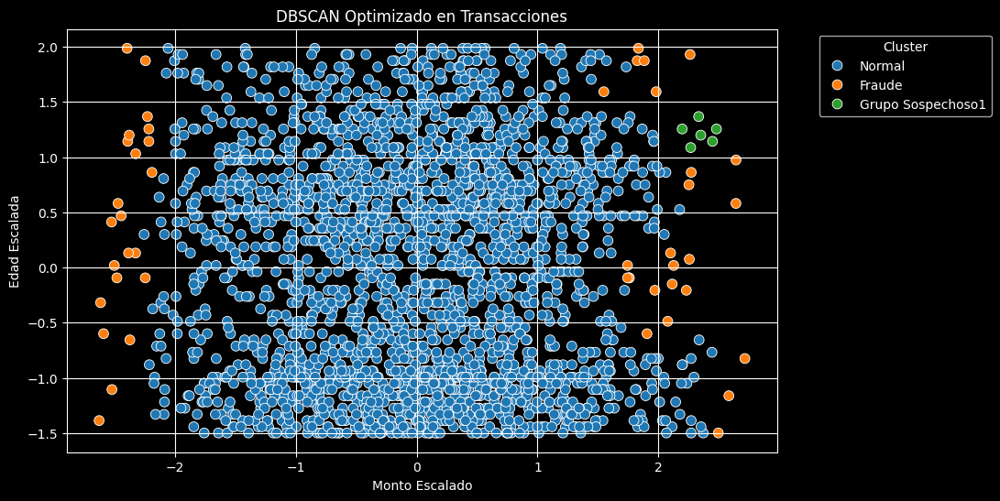

Cantidad de Fraudes detectados: 47
Porcentaje de Fraudes detectados: 1.87%
Silhouette Score (sin ruido, optimizado): 0.326


In [169]:
# Entrenar nuevamente DBSCAN con los mejores parámetros
dbscan_optimizado = DBSCAN(eps=0.2000, min_samples=6)
dbscan_labels_opt = dbscan_optimizado.fit_predict(X_scaled)

# Agregar nuevas etiquetas al dataframe
df_completo['DBSCAN_Cluster_TA_VS_CA_OPT'] = dbscan_labels_opt

# Asignar etiquetas descriptivas
unique_labels_opt = np.unique(dbscan_labels_opt)

label_mapping_opt = {}
for i, label in enumerate(unique_labels_opt):
    if label == -1:
        label_mapping_opt[label] = 'Fraude'
    elif i == 1:
        label_mapping_opt[label] = 'Normal'
    else:
        label_mapping_opt[label] = f'Grupo Sospechoso{i - 1}'

df_completo['DBSCAN_Cluster_Etiqueta_OPT'] = df_completo['DBSCAN_Cluster_TA_VS_CA_OPT'].map(label_mapping_opt)

# Visualización
plt.figure(figsize=(8,5))
plt.scatter(df_completo['CustomerAge'], df_completo['TransactionAmount_boxcox'], c=dbscan_labels_opt, cmap='viridis')
plt.xlabel('Customer Age')
plt.ylabel('Transaction Amount')
plt.title('Clústeres DBSCAN Optimizado')
plt.colorbar(label='Cluster')
plt.grid(True)
plt.show()

import seaborn as sns
plt.figure(figsize=(10, 6))
sns.scatterplot(
    x=X_scaled[:, 0],
    y=X_scaled[:, 1],
    hue=df_completo['DBSCAN_Cluster_Etiqueta_OPT'],
    palette='tab10',
    s=60
)
plt.title('DBSCAN Optimizado en Transacciones')
plt.xlabel('Monto Escalado')
plt.ylabel('Edad Escalada')
plt.legend(title='Cluster',  bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

# Cálculo de fraudes detectados
df_fraude_opt = df_completo[df_completo['DBSCAN_Cluster_Etiqueta_OPT'] == 'Fraude']
print(f"Cantidad de Fraudes detectados: {df_fraude_opt.shape[0]}")

porc_fraude_opt = (df_completo['DBSCAN_Cluster_TA_VS_CA_OPT'] == -1).mean()
print(f"Porcentaje de Fraudes detectados: {porc_fraude_opt * 100:.2f}%")

# Silhouette Score (sin ruido)
mask_opt = dbscan_labels_opt != -1
if mask_opt.sum() > 1:
    sil_score_opt = silhouette_score(X_scaled[mask_opt], dbscan_labels_opt[mask_opt])
    print(f"Silhouette Score (sin ruido, optimizado): {sil_score_opt:.3f}")
else:
    print("Muy pocos puntos para calcular Silhouette Score.")


In [170]:
# Seleccionar únicamente los fraudes detectados por DBSCAN
resultados_dbscan_TA_VS_CA = df_completo[df_completo['DBSCAN_Cluster_Etiqueta_OPT'] == 'Fraude']

# Mostrar la cantidad de fraudes detectados y los primeros registros
print(f"Número de fraudes detectados por DBSCAN: {len(resultados_dbscan_TA_VS_CA)}")
resultados_dbscan_TA_VS_CA.head()


Número de fraudes detectados por DBSCAN: 47


,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,...,TransactionAmount_boxcox,prediccion_TA_vs_AB,Distancia_Centroide,prediccion_CA_VS_TA,distancia_centroide_CA_VS_TA,cluster_TA_AB_CA,DBSCAN_Cluster_TA_VS_CA,DBSCAN_Cluster_Etiqueta,DBSCAN_Cluster_TA_VS_CA_OPT,DBSCAN_Cluster_Etiqueta_OPT
115,TX000116,AC00468,2.50,2023-07-21 16:43:11,Debit,San Diego,D000673,44.73.3.217,M042,Online,...,-2.327577,0,1031.425614,0,13.352903,0,0,Normal,-1,Fraude
141,TX000142,AC00114,1049.92,2023-10-23 16:50:33,Debit,Detroit,D000522,121.67.144.20,M052,ATM,...,1.835256,1,821.964577,0,19.933666,4,0,Normal,-1,Fraude
186,TX000187,AC00099,1041.88,2023-09-06 16:44:02,Debit,Jacksonville,D000208,32.240.176.64,M032,Online,...,1.824847,2,1097.070890,0,17.942343,4,0,Normal,-1,Fraude
190,TX000191,AC00396,1422.55,2023-07-10 17:49:18,Debit,Washington,D000569,188.124.181.12,M072,Branch,...,2.262707,2,1148.951618,0,18.985166,4,-1,Fraude,-1,Fraude
340,TX000341,AC00107,1830.00,2023-03-01 16:31:58,Debit,San Antonio,D000436,62.27.235.199,M082,Online,...,2.642217,1,1019.815931,0,5.805668,4,-1,Fraude,-1,Fraude


In [171]:
# Comparar fraudes detectados por DBSCAN y KMeans
fraudes_comunes_dbscan_kmeans = pd.merge(
    resultados_dbscan_TA_VS_CA,
    resultados_kmeans_optimizado_TA_VS_CA,
    how='inner',
    on='TransactionID'
)

print(f"Fraudes detectados por ambos modelos: {len(fraudes_comunes_dbscan_kmeans)}")
fraudes_comunes_dbscan_kmeans.head()


Fraudes detectados por ambos modelos: 6


,TransactionID,AccountID_x,TransactionAmount_x,TransactionDate_x,TransactionType_x,Location_x,DeviceID_x,IP Address_x,MerchantID_x,Channel_x,...,CustomerOccupation_y,TransactionDuration_y,LoginAttempts_y,AccountBalance_y,PreviousTransactionDate_y,TransactionAmount_boxcox_y,prediccion_TA_vs_AB_y,Distancia_Centroide_y,prediccion_CA_VS_TA_y,distancia_centroide_CA_VS_TA_y
0,TX000142,AC00114,1049.92,2023-10-23 16:50:33,Debit,Detroit,D000522,121.67.144.20,M052,ATM,...,Retired,21,1,2037.85,2024-11-04 08:10:34,1.835256,1,821.964577,0,19.933666
1,TX000187,AC00099,1041.88,2023-09-06 16:44:02,Debit,Jacksonville,D000208,32.240.176.64,M032,Online,...,Retired,57,1,5726.20,2024-11-04 08:06:44,1.824847,2,1097.070890,0,17.942343
2,TX000191,AC00396,1422.55,2023-07-10 17:49:18,Debit,Washington,D000569,188.124.181.12,M072,Branch,...,Retired,165,1,5674.32,2024-11-04 08:06:50,2.262707,2,1148.951618,0,18.985166
3,TX000614,AC00084,3.44,2023-01-19 17:24:30,Debit,Fort Worth,D000389,45.64.74.86,M004,ATM,...,Retired,108,1,7561.33,2024-11-04 08:12:20,-2.245719,2,738.063970,0,17.983109
4,TX001771,AC00022,1.82,2023-04-13 17:35:38,Debit,San Francisco,D000652,146.250.144.172,M009,Online,...,Retired,60,1,5571.39,2024-11-04 08:09:18,-2.397880,2,1251.881466,0,19.986848


#ISOLATION FOREST

In [172]:
from sklearn.ensemble import IsolationForest
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns

In [173]:
# Selección de las variables
X = df_completo[['CustomerAge', 'TransactionAmount_boxcox']].values

In [174]:
# Escalado de las variables
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [175]:
# Aplicar Isolation Forest
iso_forest = IsolationForest(contamination=0.02, random_state=42)  # Contaminación es el porcentaje de fraudes estimados
y_pred = iso_forest.fit_predict(X_scaled)

# Los valores predichos por Isolation Forest son: 1 (normal) y -1 (anomalía/fraude)
df_completo['IF_Anomalia'] = y_pred

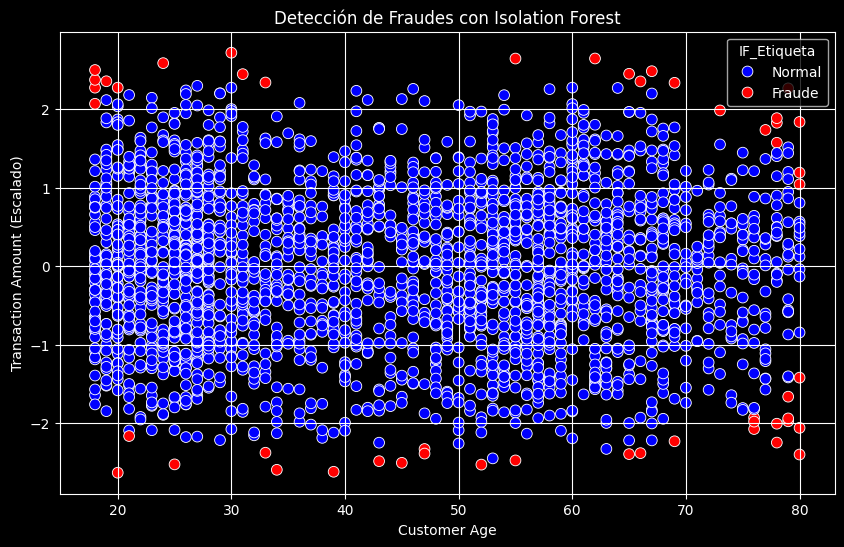

Cantidad de fraudes detectados con Isolation Forest: 51
Porcentaje de fraudes detectados: 2.03%


In [176]:
# Mapeo de las etiquetas (1 -> Normal, -1 -> Fraude)
df_completo['IF_Etiqueta'] = df_completo['IF_Anomalia'].map({1: 'Normal', -1: 'Fraude'})

# Visualización 2D de las predicciones de fraude
plt.figure(figsize=(10, 6))
sns.scatterplot(
    x=df_completo['CustomerAge'],
    y=df_completo['TransactionAmount_boxcox'],
    hue=df_completo['IF_Etiqueta'],
    palette={'Normal': 'blue', 'Fraude': 'red'},
    s=60
)
plt.title('Detección de Fraudes con Isolation Forest')
plt.xlabel('Customer Age')
plt.ylabel('Transaction Amount (Escalado)')
plt.grid(True)
plt.show()

# Mostrar cantidad de fraudes detectados
n_fraudes = df_completo[df_completo['IF_Etiqueta'] == 'Fraude'].shape[0]
print(f"Cantidad de fraudes detectados con Isolation Forest: {n_fraudes}")
print(f"Porcentaje de fraudes detectados: {n_fraudes / len(df_completo) * 100:.2f}%")

# Si quieres ver los detalles de los fraudes detectados
df_fraude = df_completo[df_completo['IF_Etiqueta'] == 'Fraude']


In [177]:
df_completo

,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,...,Distancia_Centroide,prediccion_CA_VS_TA,distancia_centroide_CA_VS_TA,cluster_TA_AB_CA,DBSCAN_Cluster_TA_VS_CA,DBSCAN_Cluster_Etiqueta,DBSCAN_Cluster_TA_VS_CA_OPT,DBSCAN_Cluster_Etiqueta_OPT,IF_Anomalia,IF_Etiqueta
0,TX000001,AC00128,14.09,2023-04-11 16:29:14,Debit,San Diego,D000380,162.198.218.92,M015,ATM,...,893.735868,0,9.993478,5,0,Normal,0,Normal,1,Normal
1,TX000002,AC00455,376.24,2023-06-27 16:44:19,Debit,Houston,D000051,13.149.61.4,M052,ATM,...,582.217286,0,7.871968,3,0,Normal,0,Normal,1,Normal
2,TX000003,AC00019,126.29,2023-07-10 18:16:08,Debit,Mesa,D000235,215.97.143.157,M009,Online,...,93.538448,1,9.753460,1,0,Normal,0,Normal,1,Normal
3,TX000004,AC00070,184.50,2023-05-05 16:32:11,Debit,Raleigh,D000187,200.13.225.150,M002,Online,...,879.994473,1,2.746230,0,0,Normal,0,Normal,1,Normal
4,TX000005,AC00411,13.45,2023-10-16 17:51:24,Credit,Atlanta,D000308,65.164.3.100,M091,Online,...,606.133119,1,3.277397,0,0,Normal,0,Normal,1,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2507,TX002508,AC00297,856.21,2023-04-26 17:09:36,Credit,Colorado Springs,D000625,21.157.41.17,M072,Branch,...,485.905712,1,4.524146,3,0,Normal,0,Normal,1,Normal
2508,TX002509,AC00322,251.54,2023-03-22 17:36:48,Debit,Tucson,D000410,49.174.157.140,M029,Branch,...,961.137368,0,12.156096,4,0,Normal,0,Normal,1,Normal
2509,TX002510,AC00095,28.63,2023-08-21 17:08:50,Debit,San Diego,D000095,58.1.27.124,M087,Branch,...,835.566869,0,4.370359,5,0,Normal,0,Normal,1,Normal
2510,TX002511,AC00118,185.97,2023-02-24 16:24:46,Debit,Denver,D000634,21.190.11.223,M041,Online,...,561.022658,1,5.744903,1,0,Normal,0,Normal,1,Normal


In [178]:
# Guardar los fraudes detectados por Isolation Forest
resultados_isolationforest_TA_VS_CA = df_completo[df_completo['IF_Etiqueta'] == 'Fraude']

# Mostrar la cantidad de fraudes detectados y los primeros registros
print(f"Número de fraudes detectados por Isolation Forest: {len(resultados_isolationforest_TA_VS_CA)}")
resultados_isolationforest_TA_VS_CA.head()


Número de fraudes detectados por Isolation Forest: 51


,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,...,Distancia_Centroide,prediccion_CA_VS_TA,distancia_centroide_CA_VS_TA,cluster_TA_AB_CA,DBSCAN_Cluster_TA_VS_CA,DBSCAN_Cluster_Etiqueta,DBSCAN_Cluster_TA_VS_CA_OPT,DBSCAN_Cluster_Etiqueta_OPT,IF_Anomalia,IF_Etiqueta
115,TX000116,AC00468,2.50,2023-07-21 16:43:11,Debit,San Diego,D000673,44.73.3.217,M042,Online,...,1031.425614,0,13.352903,0,0,Normal,-1,Fraude,-1,Fraude
141,TX000142,AC00114,1049.92,2023-10-23 16:50:33,Debit,Detroit,D000522,121.67.144.20,M052,ATM,...,821.964577,0,19.933666,4,0,Normal,-1,Fraude,-1,Fraude
146,TX000147,AC00385,973.39,2023-08-30 17:23:20,Debit,Sacramento,D000292,202.194.199.70,M026,Branch,...,826.334353,0,16.938276,4,0,Normal,0,Normal,-1,Fraude
186,TX000187,AC00099,1041.88,2023-09-06 16:44:02,Debit,Jacksonville,D000208,32.240.176.64,M032,Online,...,1097.070890,0,17.942343,4,0,Normal,-1,Fraude,-1,Fraude
190,TX000191,AC00396,1422.55,2023-07-10 17:49:18,Debit,Washington,D000569,188.124.181.12,M072,Branch,...,1148.951618,0,18.985166,4,-1,Fraude,-1,Fraude,-1,Fraude


#COMPARACION DE ANOMALIAS DETECTADAS POR MODELO

##Anomalias detectadas por Kmeans

In [179]:
resultados_kmeans_optimizado_TA_VS_CA

,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,...,CustomerOccupation,TransactionDuration,LoginAttempts,AccountBalance,PreviousTransactionDate,TransactionAmount_boxcox,prediccion_TA_vs_AB,Distancia_Centroide,prediccion_CA_VS_TA,distancia_centroide_CA_VS_TA
61,TX000062,AC00002,263.99,2023-05-16 16:07:30,Debit,Dallas,D000285,7.146.35.122,M087,Branch,...,Retired,227,2,4175.02,2024-11-04 08:11:03,0.249598,3,43.456674,0,18.848236
141,TX000142,AC00114,1049.92,2023-10-23 16:50:33,Debit,Detroit,D000522,121.67.144.20,M052,ATM,...,Retired,21,1,2037.85,2024-11-04 08:10:34,1.835256,1,821.964577,0,19.933666
150,TX000151,AC00072,69.40,2023-07-24 18:08:43,Debit,Virginia Beach,D000413,216.151.64.40,M073,Online,...,Retired,113,1,6452.77,2024-11-04 08:09:04,-0.844593,2,370.500115,0,19.862842
186,TX000187,AC00099,1041.88,2023-09-06 16:44:02,Debit,Jacksonville,D000208,32.240.176.64,M032,Online,...,Retired,57,1,5726.20,2024-11-04 08:06:44,1.824847,2,1097.070890,0,17.942343
190,TX000191,AC00396,1422.55,2023-07-10 17:49:18,Debit,Washington,D000569,188.124.181.12,M072,Branch,...,Retired,165,1,5674.32,2024-11-04 08:06:50,2.262707,2,1148.951618,0,18.985166
263,TX000264,AC00319,512.81,2023-07-19 16:57:01,Debit,Sacramento,D000611,82.75.200.117,M004,Branch,...,Retired,30,1,6994.34,2024-11-04 08:11:58,0.945027,2,171.073655,0,18.871387
266,TX000267,AC00178,66.90,2023-04-17 16:50:45,Credit,Charlotte,D000221,138.210.196.19,M021,Online,...,Retired,129,4,5238.71,2024-11-04 08:10:39,-0.869733,3,1020.234579,0,18.864828
305,TX000306,AC00431,378.85,2023-06-16 17:21:15,Debit,Virginia Beach,D000043,192.95.36.246,M089,Branch,...,Retired,126,1,2300.53,2024-11-04 08:09:07,0.613718,1,1084.642789,0,17.857779
365,TX000366,AC00092,632.69,2023-09-12 16:28:38,Debit,Denver,D000455,211.97.88.141,M047,ATM,...,Retired,76,1,4363.74,2024-11-04 08:09:26,1.189917,3,145.269368,0,19.883645
394,TX000395,AC00326,6.30,2023-12-14 18:52:54,Debit,Columbus,D000539,210.160.90.52,M017,Branch,...,Retired,283,5,7697.68,2024-11-04 08:12:13,-2.058371,2,874.413014,0,19.949484


In [180]:
resultados_kmeans_optimizado_TA_VS_CA.describe()

,TransactionAmount,TransactionDate,CustomerAge,TransactionDuration,LoginAttempts,AccountBalance,PreviousTransactionDate,TransactionAmount_boxcox,prediccion_TA_vs_AB,Distancia_Centroide,prediccion_CA_VS_TA,distancia_centroide_CA_VS_TA
count,51.000000,51,51.000000,51.000000,51.000000,51.000000,51,51.000000,51.000000,51.000000,51.0,51.000000
mean,375.275686,2023-07-08 17:40:49.725490176,79.117647,119.588235,1.254902,4591.371176,2024-11-04 08:09:18.960784128,0.142111,2.392157,687.018164,0.0,19.004046
min,1.820000,2023-01-09 16:45:12,78.000000,21.000000,1.000000,1146.780000,2024-11-04 08:06:31,-2.397880,1.000000,15.604381,0.0,17.857779
25%,99.715000,2023-05-06 05:02:49.500000,79.000000,58.500000,1.000000,3504.690000,2024-11-04 08:07:36.500000,-0.583177,2.000000,327.767842,0.0,18.846862
50%,302.160000,2023-07-19 16:57:01,79.000000,113.000000,1.000000,4543.560000,2024-11-04 08:09:09,0.381921,3.000000,697.867141,0.0,18.886249
75%,573.990000,2023-09-08 18:02:26.500000,80.000000,157.500000,1.000000,5652.760000,2024-11-04 08:10:38.500000,1.074465,3.000000,1007.055499,0.0,19.849072
max,1422.550000,2023-12-19 16:11:38,80.000000,283.000000,5.000000,7697.680000,2024-11-04 08:12:20,2.262707,3.000000,1391.692791,0.0,19.986848
std,338.467613,NaN,0.738839,70.288314,0.890913,1603.415307,NaN,1.229570,0.750425,401.343109,0.0,0.727701


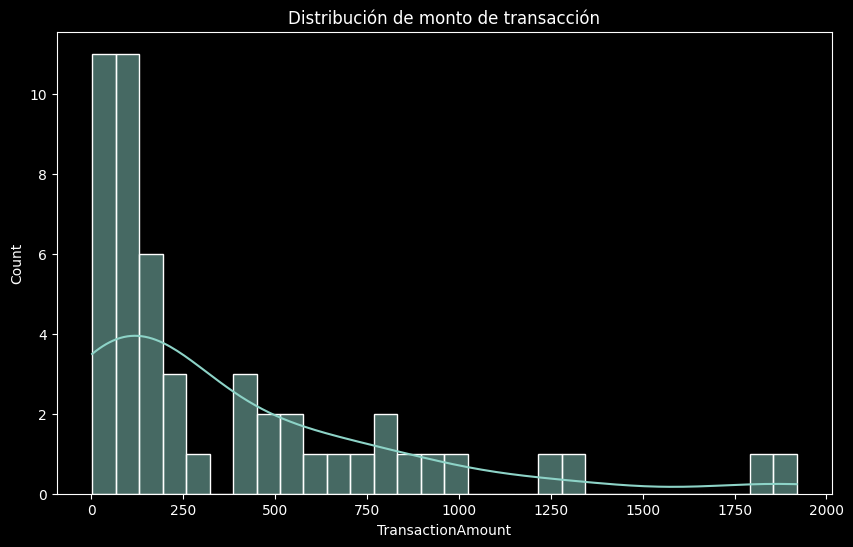

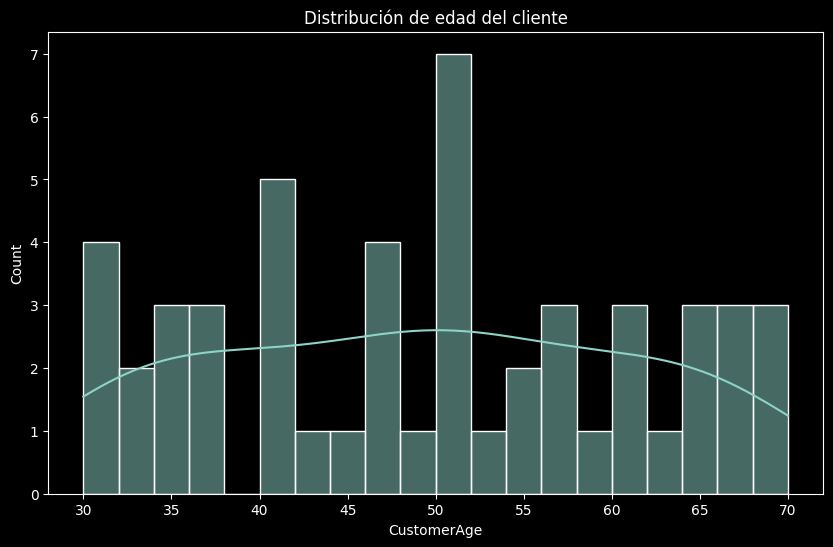

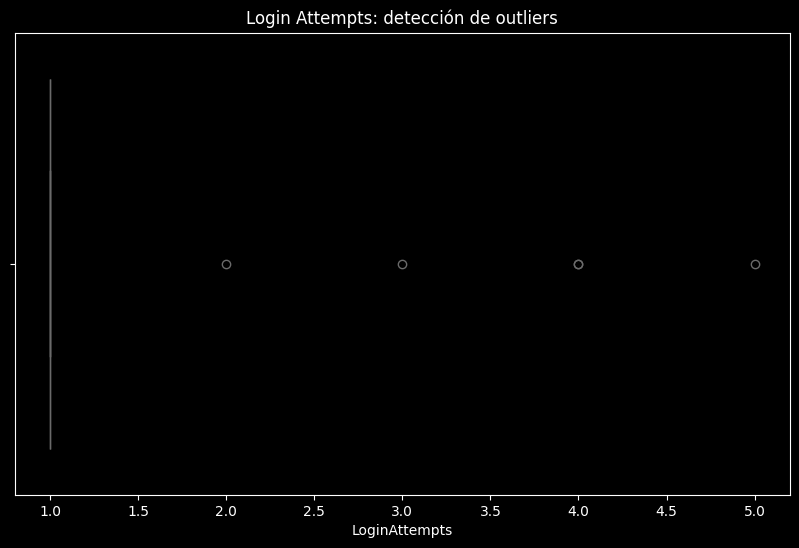

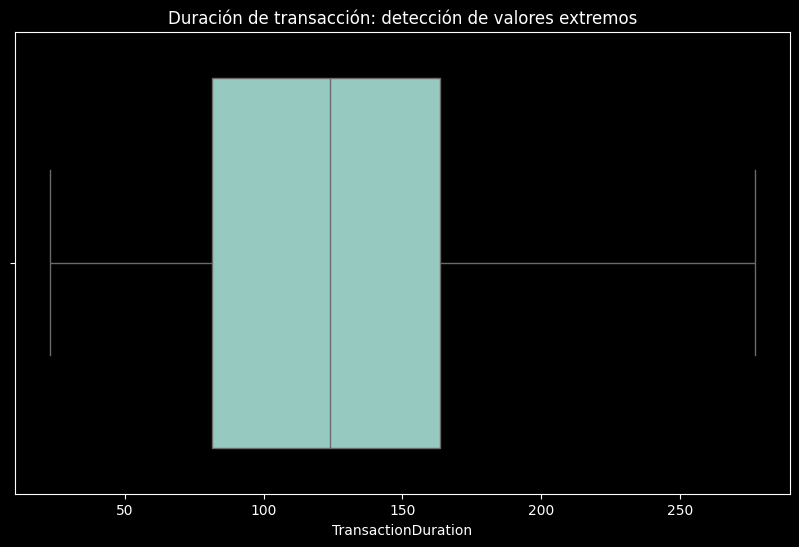

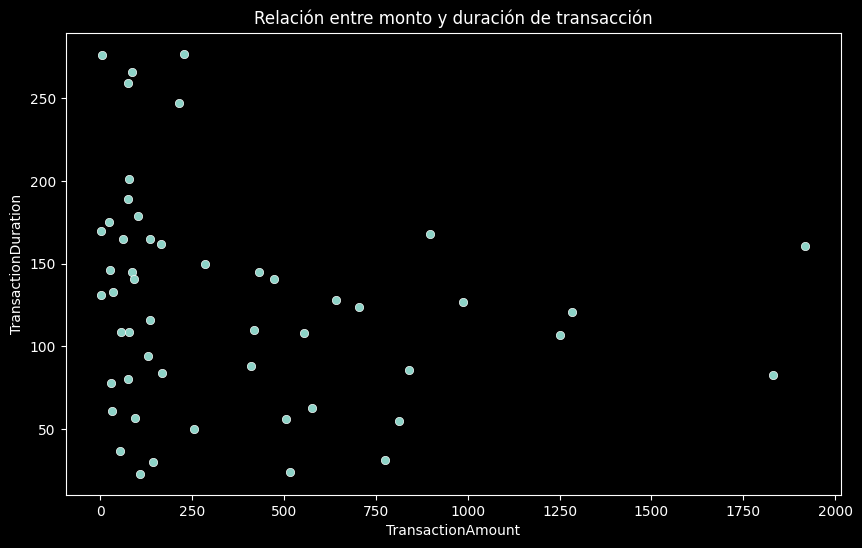

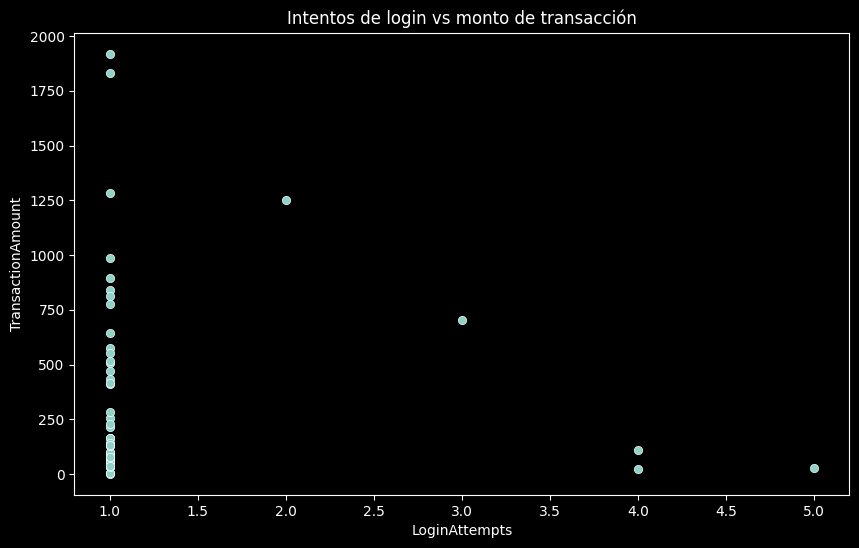

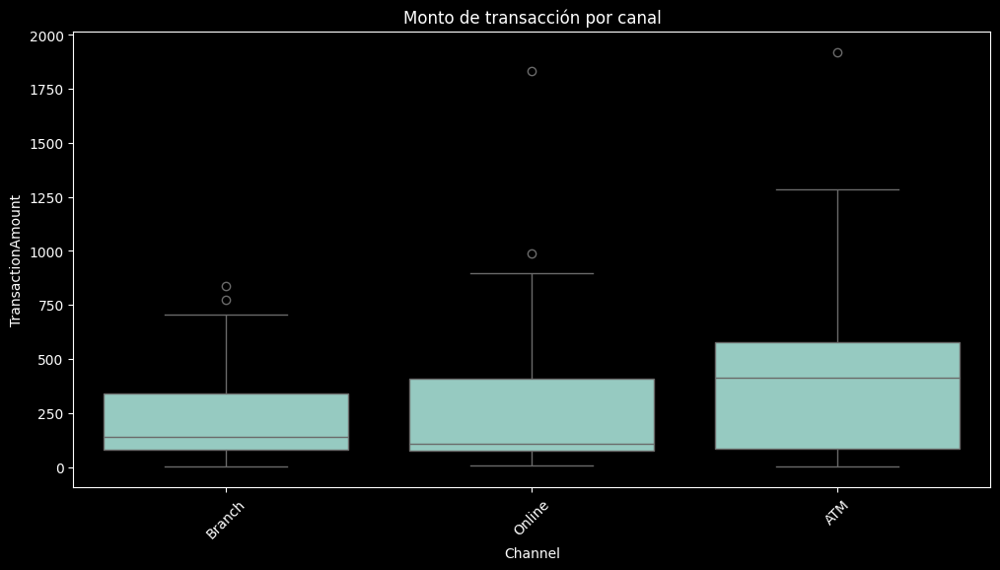

In [181]:
plt.figure(figsize=(10, 6))
sns.histplot(resultados_kmeans_optimizado_TA_VS_AB['TransactionAmount'], bins=30, kde=True)
plt.title('Distribución de monto de transacción')
plt.show()

# 2. Edad del cliente
plt.figure(figsize=(10, 6))
sns.histplot(resultados_kmeans_optimizado_TA_VS_AB['CustomerAge'], bins=20, kde=True)
plt.title('Distribución de edad del cliente')
plt.show()

# 3. Login attempts: detectar intentos inusuales
plt.figure(figsize=(10, 6))
sns.boxplot(x=resultados_kmeans_optimizado_TA_VS_AB['LoginAttempts'])
plt.title('Login Attempts: detección de outliers')
plt.show()

# 4. Duración de la transacción
plt.figure(figsize=(10, 6))
sns.boxplot(x=resultados_kmeans_optimizado_TA_VS_AB['TransactionDuration'])
plt.title('Duración de transacción: detección de valores extremos')
plt.show()

# 5. Relación entre monto y duración
plt.figure(figsize=(10, 6))
sns.scatterplot(data=resultados_kmeans_optimizado_TA_VS_AB, x='TransactionAmount', y='TransactionDuration')
plt.title('Relación entre monto y duración de transacción')
plt.show()

# 6. Comparar intentos de login vs monto de transacción
plt.figure(figsize=(10, 6))
sns.scatterplot(data=resultados_kmeans_optimizado_TA_VS_AB, x='LoginAttempts', y='TransactionAmount')
plt.title('Intentos de login vs monto de transacción')
plt.show()

# 7. Canal de transacción: ¿hay canales con montos atípicos?
plt.figure(figsize=(12, 6))
sns.boxplot(data=resultados_kmeans_optimizado_TA_VS_AB, x='Channel', y='TransactionAmount')
plt.title('Monto de transacción por canal')
plt.xticks(rotation=45)
plt.show()

##Anomalias detectadas por DBSCAN

In [182]:
resultados_dbscan_TA_VS_CA

,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,...,TransactionAmount_boxcox,prediccion_TA_vs_AB,Distancia_Centroide,prediccion_CA_VS_TA,distancia_centroide_CA_VS_TA,cluster_TA_AB_CA,DBSCAN_Cluster_TA_VS_CA,DBSCAN_Cluster_Etiqueta,DBSCAN_Cluster_TA_VS_CA_OPT,DBSCAN_Cluster_Etiqueta_OPT
115,TX000116,AC00468,2.50,2023-07-21 16:43:11,Debit,San Diego,D000673,44.73.3.217,M042,Online,...,-2.327577,0,1031.425614,0,13.352903,0,0,Normal,-1,Fraude
141,TX000142,AC00114,1049.92,2023-10-23 16:50:33,Debit,Detroit,D000522,121.67.144.20,M052,ATM,...,1.835256,1,821.964577,0,19.933666,4,0,Normal,-1,Fraude
186,TX000187,AC00099,1041.88,2023-09-06 16:44:02,Debit,Jacksonville,D000208,32.240.176.64,M032,Online,...,1.824847,2,1097.070890,0,17.942343,4,0,Normal,-1,Fraude
190,TX000191,AC00396,1422.55,2023-07-10 17:49:18,Debit,Washington,D000569,188.124.181.12,M072,Branch,...,2.262707,2,1148.951618,0,18.985166,4,-1,Fraude,-1,Fraude
340,TX000341,AC00107,1830.00,2023-03-01 16:31:58,Debit,San Antonio,D000436,62.27.235.199,M082,Online,...,2.642217,1,1019.815931,0,5.805668,4,-1,Fraude,-1,Fraude
344,TX000345,AC00156,1271.90,2023-08-28 16:43:15,Debit,Houston,D000312,210.136.14.108,M073,ATM,...,2.101443,1,904.914963,0,13.325503,4,0,Normal,-1,Fraude
375,TX000376,AC00316,1392.54,2023-11-20 16:51:14,Debit,El Paso,D000113,63.67.150.226,M013,Branch,...,2.231646,0,171.011976,1,12.451984,3,-1,Fraude,-1,Fraude
486,TX000487,AC00148,1416.69,2023-01-16 17:00:11,Debit,Nashville,D000418,219.98.242.240,M015,ATM,...,2.256681,3,477.751245,0,14.337460,4,-1,Fraude,-1,Fraude
490,TX000491,AC00166,0.99,2023-09-13 16:55:14,Debit,Los Angeles,D000503,187.199.178.27,M029,ATM,...,-2.503747,3,99.404986,0,15.354341,5,-1,Fraude,-1,Fraude
504,TX000505,AC00052,3.42,2023-09-25 16:14:35,Credit,San Antonio,D000484,151.247.130.190,M092,Online,...,-2.247317,0,1003.519365,1,14.437032,0,-1,Fraude,-1,Fraude


In [183]:
resultados_dbscan_TA_VS_CA.describe()

,TransactionAmount,TransactionDate,CustomerAge,TransactionDuration,LoginAttempts,AccountBalance,PreviousTransactionDate,TransactionAmount_boxcox,prediccion_TA_vs_AB,Distancia_Centroide,prediccion_CA_VS_TA,distancia_centroide_CA_VS_TA,cluster_TA_AB_CA,DBSCAN_Cluster_TA_VS_CA,DBSCAN_Cluster_TA_VS_CA_OPT
count,47.000000,47,47.000000,47.000000,47.000000,47.000000,47,47.000000,47.000000,47.000000,47.000000,47.000000,47.000000,47.000000,47.0
mean,694.378723,2023-08-02 02:48:32.148936448,51.553191,139.936170,1.106383,6104.603404,2024-11-04 08:09:53.574468352,0.000211,1.787234,772.009933,0.382979,10.473097,3.170213,-0.489362,-1.0
min,0.260000,2023-01-09 16:21:35,18.000000,21.000000,1.000000,602.360000,2024-11-04 08:06:27,-2.629493,0.000000,28.392864,0.000000,2.167123,0.000000,-1.000000,-1.0
25%,1.955000,2023-05-13 04:33:27,41.500000,105.000000,1.000000,2374.605000,2024-11-04 08:08:40.500000,-2.382985,1.000000,456.711630,0.000000,5.641804,2.000000,-1.000000,-1.0
50%,981.760000,2023-08-28 16:43:15,47.000000,140.000000,1.000000,5726.200000,2024-11-04 08:09:57,1.745031,2.000000,725.347974,0.000000,11.023097,4.000000,0.000000,-1.0
75%,1277.935000,2023-10-20 06:20:24.500000,65.000000,172.500000,1.000000,8844.280000,2024-11-04 08:11:24,2.108161,2.500000,1076.691189,1.000000,14.360336,5.000000,0.000000,-1.0
max,1919.110000,2024-01-01 16:45:56,80.000000,300.000000,5.000000,14180.210000,2024-11-04 08:12:22,2.716535,4.000000,1678.685209,1.000000,19.986848,5.000000,0.000000,-1.0
std,692.158194,NaN,16.981843,70.780249,0.598333,3912.765002,NaN,2.286843,1.232463,458.376780,0.491369,5.250580,1.698070,0.505291,0.0


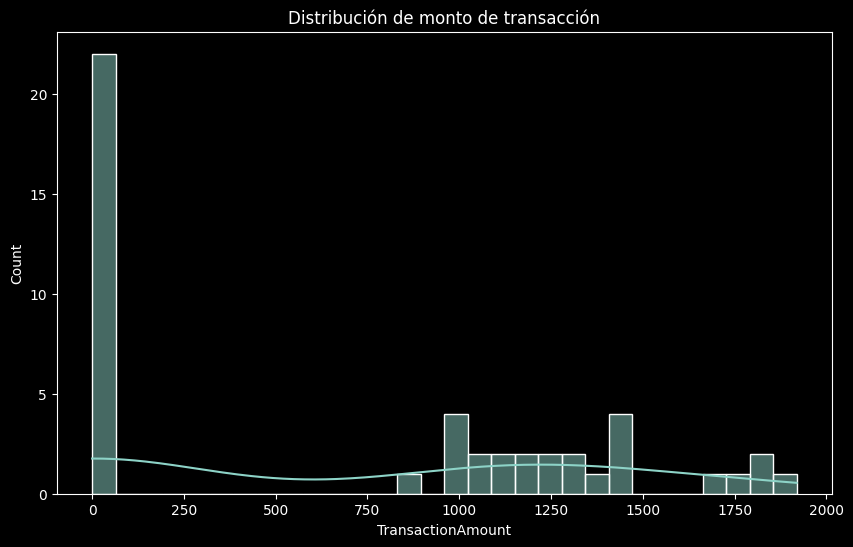

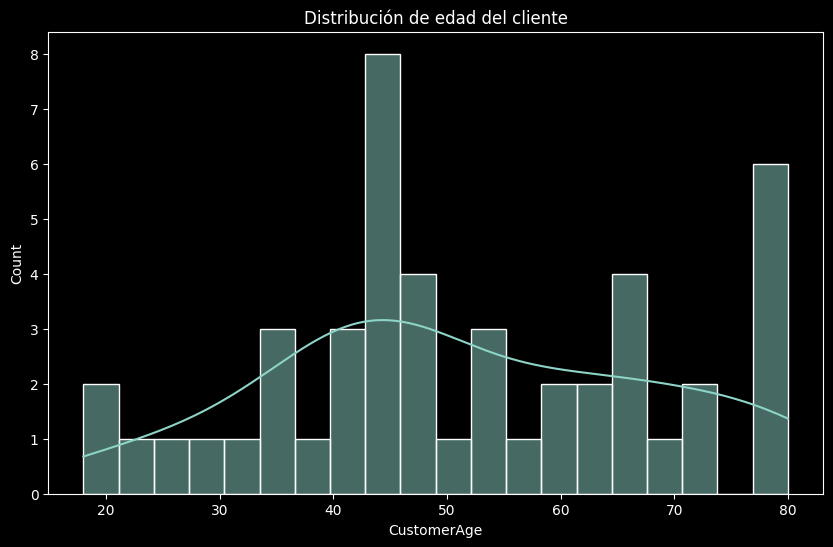

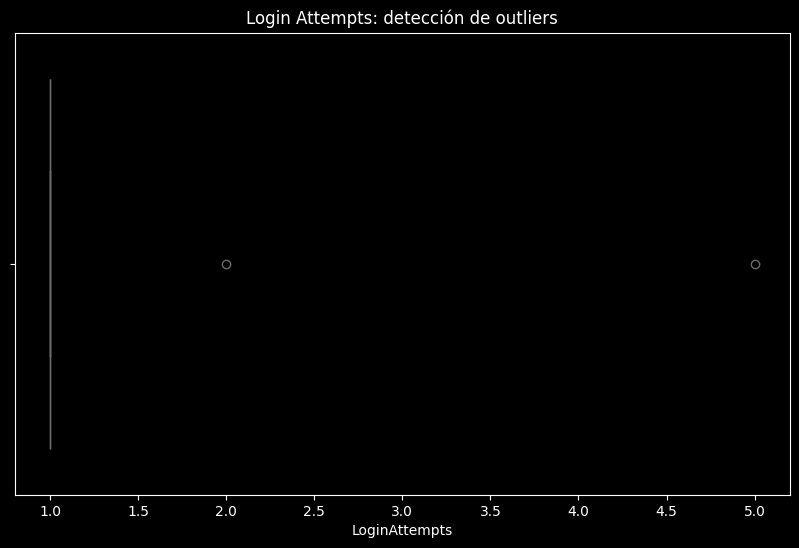

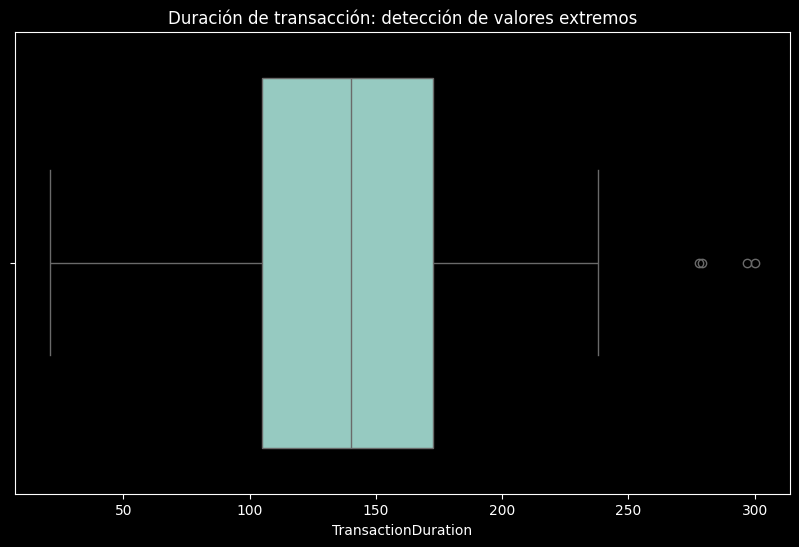

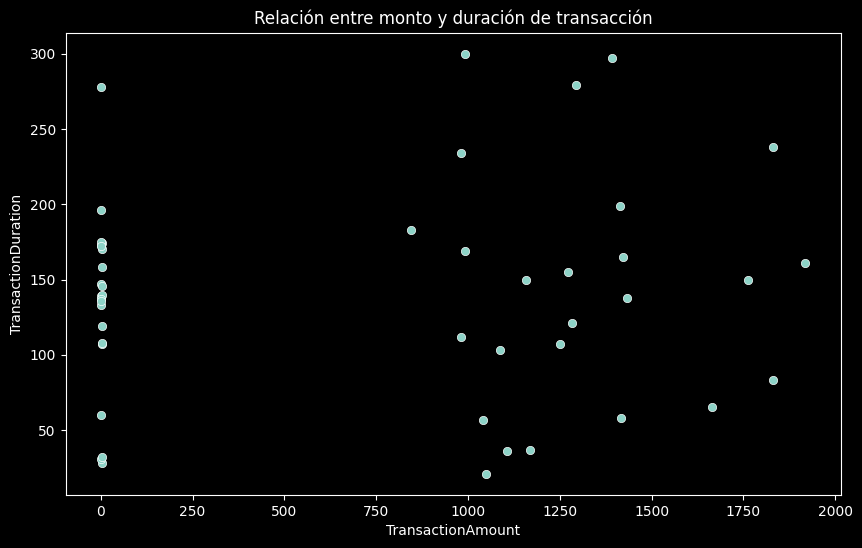

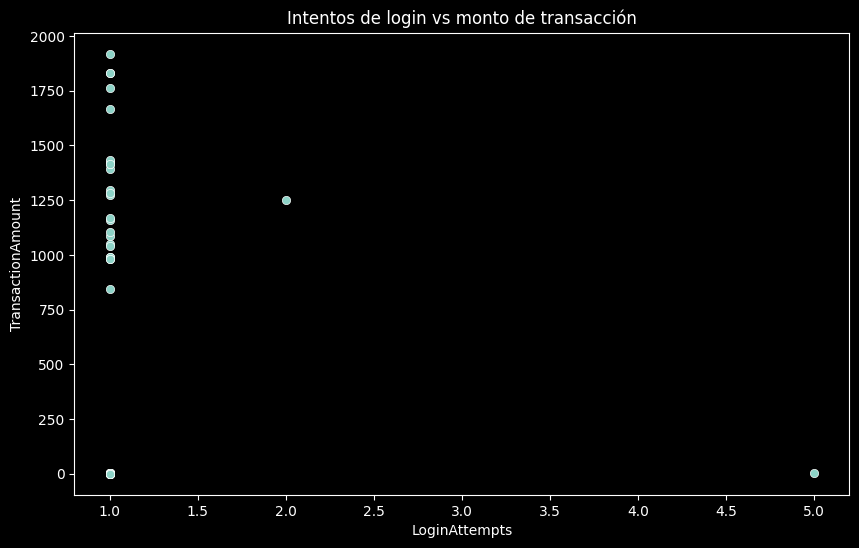

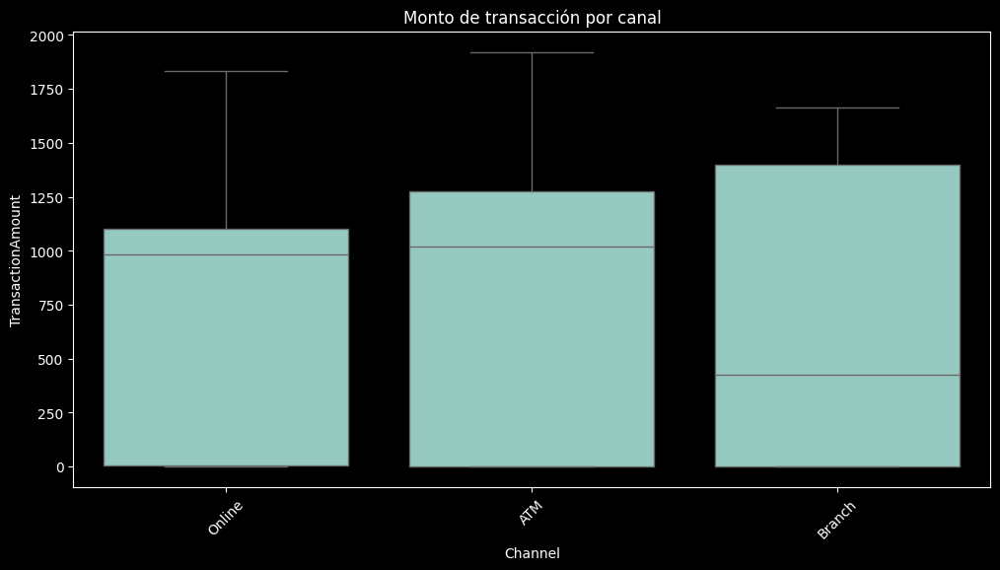

In [184]:
plt.figure(figsize=(10, 6))
sns.histplot(resultados_dbscan_TA_VS_CA['TransactionAmount'], bins=30, kde=True)
plt.title('Distribución de monto de transacción')
plt.show()

# 2. Edad del cliente
plt.figure(figsize=(10, 6))
sns.histplot(resultados_dbscan_TA_VS_CA['CustomerAge'], bins=20, kde=True)
plt.title('Distribución de edad del cliente')
plt.show()

# 3. Login attempts: detectar intentos inusuales
plt.figure(figsize=(10, 6))
sns.boxplot(x=resultados_dbscan_TA_VS_CA['LoginAttempts'])
plt.title('Login Attempts: detección de outliers')
plt.show()

# 4. Duración de la transacción
plt.figure(figsize=(10, 6))
sns.boxplot(x=resultados_dbscan_TA_VS_CA['TransactionDuration'])
plt.title('Duración de transacción: detección de valores extremos')
plt.show()

# 5. Relación entre monto y duración
plt.figure(figsize=(10, 6))
sns.scatterplot(data=resultados_dbscan_TA_VS_CA, x='TransactionAmount', y='TransactionDuration')
plt.title('Relación entre monto y duración de transacción')
plt.show()

# 6. Comparar intentos de login vs monto de transacción
plt.figure(figsize=(10, 6))
sns.scatterplot(data=resultados_dbscan_TA_VS_CA, x='LoginAttempts', y='TransactionAmount')
plt.title('Intentos de login vs monto de transacción')
plt.show()

# 7. Canal de transacción: ¿hay canales con montos atípicos?
plt.figure(figsize=(12, 6))
sns.boxplot(data=resultados_dbscan_TA_VS_CA, x='Channel', y='TransactionAmount')
plt.title('Monto de transacción por canal')
plt.xticks(rotation=45)
plt.show()

##Anomalias detectadas por Isolation Forest

In [185]:
resultados_isolationforest_TA_VS_CA

,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,...,Distancia_Centroide,prediccion_CA_VS_TA,distancia_centroide_CA_VS_TA,cluster_TA_AB_CA,DBSCAN_Cluster_TA_VS_CA,DBSCAN_Cluster_Etiqueta,DBSCAN_Cluster_TA_VS_CA_OPT,DBSCAN_Cluster_Etiqueta_OPT,IF_Anomalia,IF_Etiqueta
115,TX000116,AC00468,2.50,2023-07-21 16:43:11,Debit,San Diego,D000673,44.73.3.217,M042,Online,...,1031.425614,0,13.352903,0,0,Normal,-1,Fraude,-1,Fraude
141,TX000142,AC00114,1049.92,2023-10-23 16:50:33,Debit,Detroit,D000522,121.67.144.20,M052,ATM,...,821.964577,0,19.933666,4,0,Normal,-1,Fraude,-1,Fraude
146,TX000147,AC00385,973.39,2023-08-30 17:23:20,Debit,Sacramento,D000292,202.194.199.70,M026,Branch,...,826.334353,0,16.938276,4,0,Normal,0,Normal,-1,Fraude
186,TX000187,AC00099,1041.88,2023-09-06 16:44:02,Debit,Jacksonville,D000208,32.240.176.64,M032,Online,...,1097.070890,0,17.942343,4,0,Normal,-1,Fraude,-1,Fraude
190,TX000191,AC00396,1422.55,2023-07-10 17:49:18,Debit,Washington,D000569,188.124.181.12,M072,Branch,...,1148.951618,0,18.985166,4,-1,Fraude,-1,Fraude,-1,Fraude
340,TX000341,AC00107,1830.00,2023-03-01 16:31:58,Debit,San Antonio,D000436,62.27.235.199,M082,Online,...,1019.815931,0,5.805668,4,-1,Fraude,-1,Fraude,-1,Fraude
365,TX000366,AC00092,632.69,2023-09-12 16:28:38,Debit,Denver,D000455,211.97.88.141,M047,ATM,...,145.269368,0,19.883645,4,0,Normal,0,Normal,-1,Fraude
394,TX000395,AC00326,6.30,2023-12-14 18:52:54,Debit,Columbus,D000539,210.160.90.52,M017,Branch,...,874.413014,0,19.949484,5,0,Normal,0,Normal,-1,Fraude
475,TX000476,AC00464,1431.30,2023-09-04 18:46:40,Debit,Oklahoma City,D000563,7.105.184.86,M082,ATM,...,157.772962,1,10.975015,2,0,Normal,0,Normal,-1,Fraude
490,TX000491,AC00166,0.99,2023-09-13 16:55:14,Debit,Los Angeles,D000503,187.199.178.27,M029,ATM,...,99.404986,0,15.354341,5,-1,Fraude,-1,Fraude,-1,Fraude


In [186]:
resultados_isolationforest_TA_VS_CA.describe()

,TransactionAmount,TransactionDate,CustomerAge,TransactionDuration,LoginAttempts,AccountBalance,PreviousTransactionDate,TransactionAmount_boxcox,prediccion_TA_vs_AB,Distancia_Centroide,prediccion_CA_VS_TA,distancia_centroide_CA_VS_TA,cluster_TA_AB_CA,DBSCAN_Cluster_TA_VS_CA,DBSCAN_Cluster_TA_VS_CA_OPT,IF_Anomalia
count,51.000000,51,51.000000,51.000000,51.000000,51.000000,51,51.000000,51.000000,51.000000,51.000000,51.000000,51.000000,51.000000,51.000000,51.0
mean,675.352745,2023-08-09 17:38:35.509804288,55.647059,122.137255,1.215686,4728.473137,2024-11-04 08:09:28.725490432,-0.081328,1.803922,698.898887,0.333333,12.044948,3.333333,-0.235294,-0.431373,-1.0
min,0.260000,2023-01-09 16:45:12,18.000000,21.000000,1.000000,756.740000,2024-11-04 08:06:26,-2.629493,0.000000,43.963406,0.000000,2.964365,0.000000,-1.000000,-1.000000,-1.0
25%,2.265000,2023-06-15 16:29:40,33.000000,65.000000,1.000000,1726.415000,2024-11-04 08:07:57.500000,-2.351248,1.000000,345.677704,0.000000,6.306695,2.000000,-1.000000,-1.000000,-1.0
50%,27.070000,2023-08-30 17:23:20,65.000000,129.000000,1.000000,3773.290000,2024-11-04 08:09:45,-1.419410,2.000000,719.474781,0.000000,10.995783,4.000000,0.000000,-1.000000,-1.0
75%,1462.270000,2023-10-20 06:20:24.500000,78.000000,165.000000,1.000000,7223.260000,2024-11-04 08:10:44.500000,2.302822,3.000000,1025.620773,1.000000,17.945430,5.000000,0.000000,0.000000,-1.0
max,1919.110000,2024-01-01 16:45:56,80.000000,296.000000,5.000000,13913.920000,2024-11-04 08:12:22,2.716535,4.000000,1678.685209,1.000000,19.986848,5.000000,1.000000,1.000000,-1.0
std,735.926786,NaN,23.375905,67.151179,0.878948,3524.910647,NaN,2.256044,1.095803,436.024432,0.476095,5.719428,1.704895,0.586114,0.640466,0.0


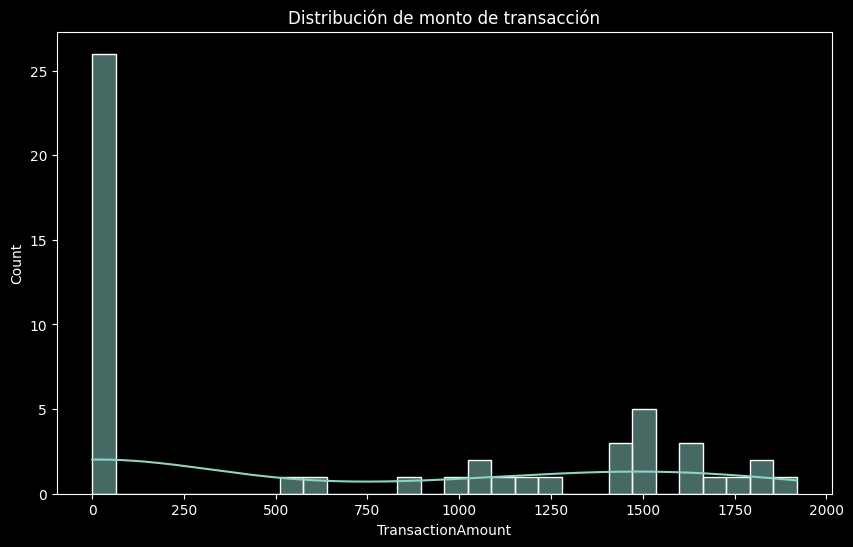

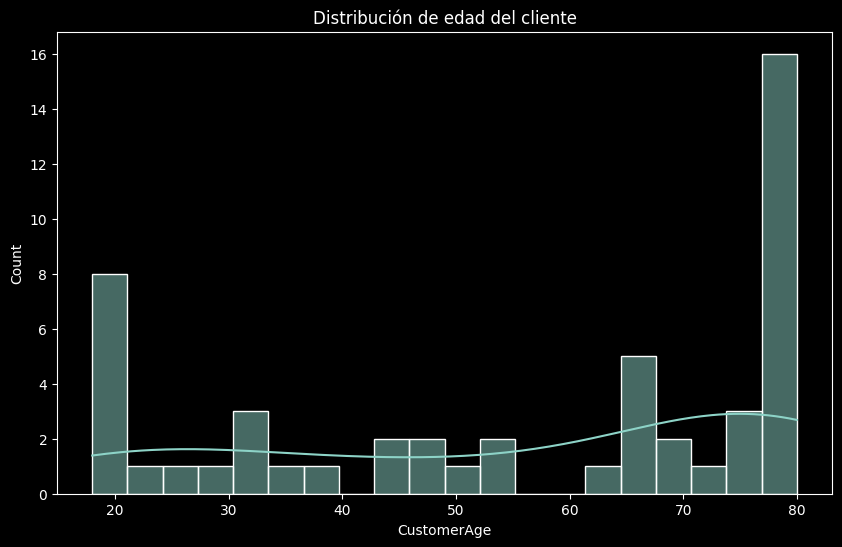

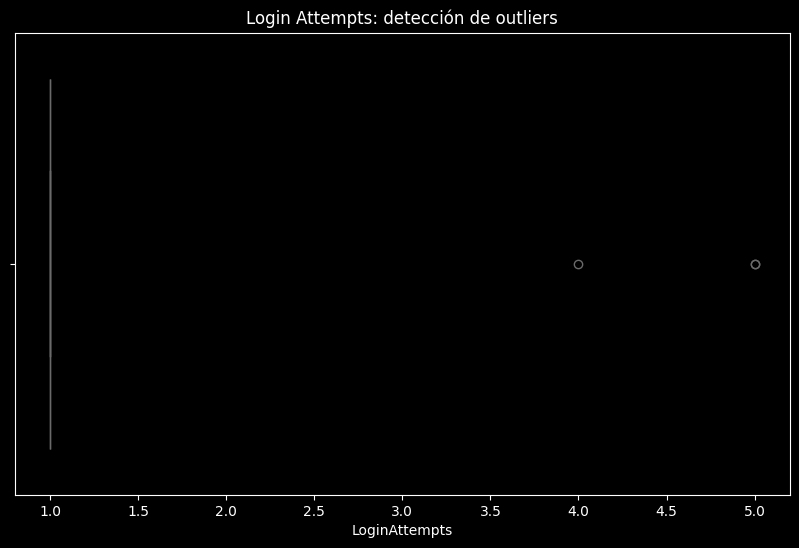

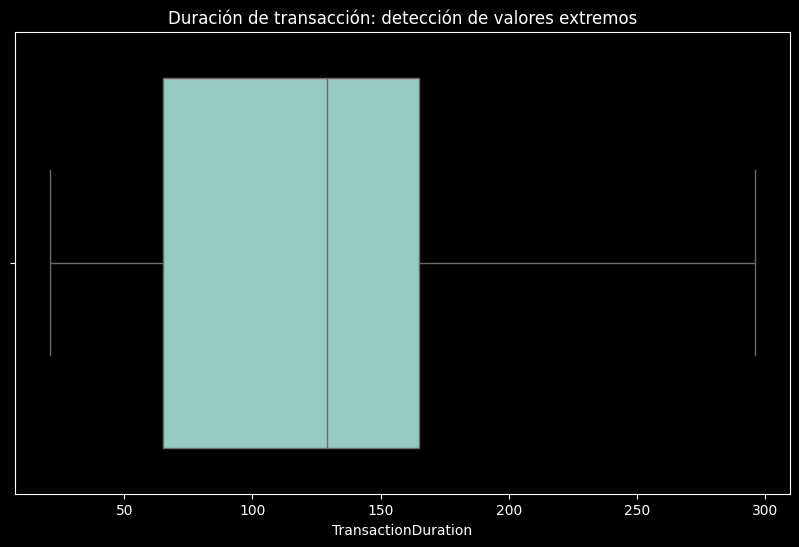

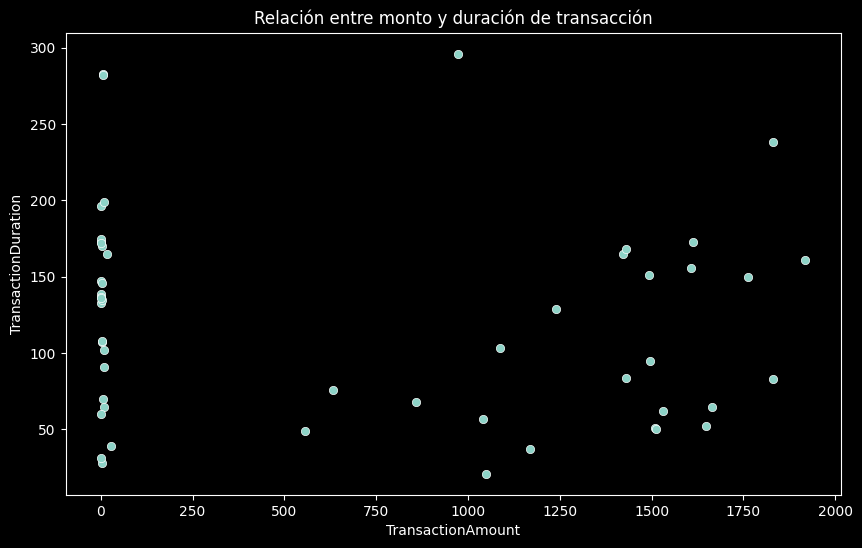

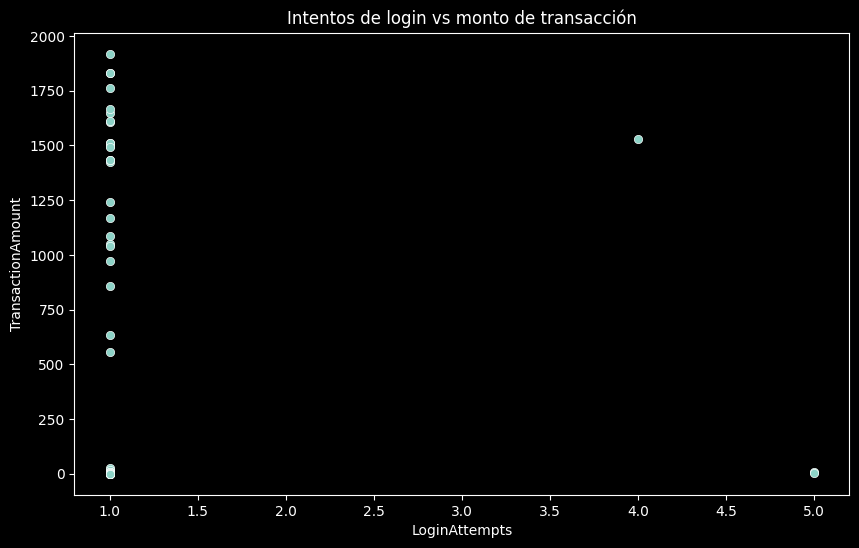

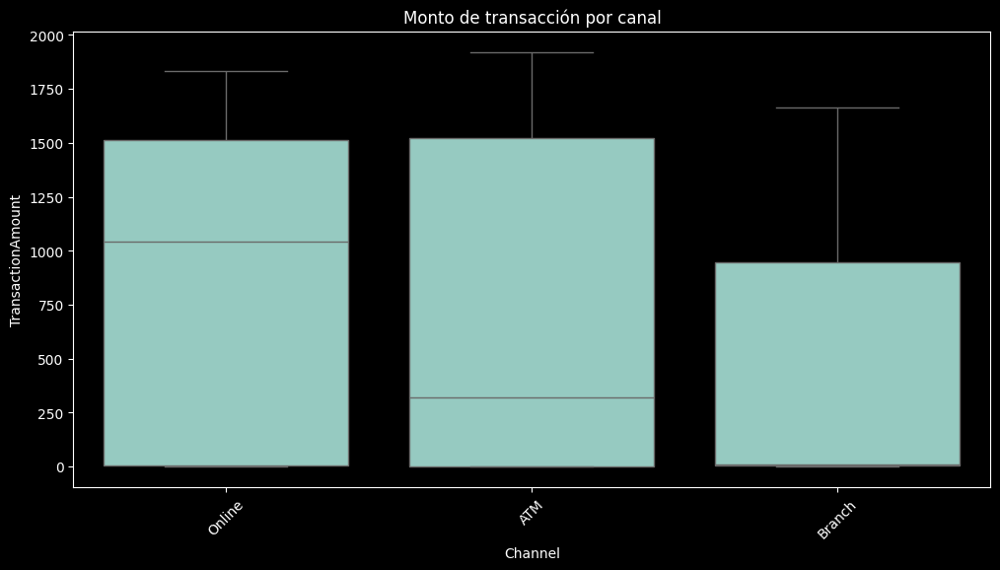

In [187]:
plt.figure(figsize=(10, 6))
sns.histplot(resultados_isolationforest_TA_VS_CA['TransactionAmount'], bins=30, kde=True)
plt.title('Distribución de monto de transacción')
plt.show()

# 2. Edad del cliente
plt.figure(figsize=(10, 6))
sns.histplot(resultados_isolationforest_TA_VS_CA['CustomerAge'], bins=20, kde=True)
plt.title('Distribución de edad del cliente')
plt.show()

# 3. Login attempts: detectar intentos inusuales
plt.figure(figsize=(10, 6))
sns.boxplot(x=resultados_isolationforest_TA_VS_CA['LoginAttempts'])
plt.title('Login Attempts: detección de outliers')
plt.show()

# 4. Duración de la transacción
plt.figure(figsize=(10, 6))
sns.boxplot(x=resultados_isolationforest_TA_VS_CA['TransactionDuration'])
plt.title('Duración de transacción: detección de valores extremos')
plt.show()

# 5. Relación entre monto y duración
plt.figure(figsize=(10, 6))
sns.scatterplot(data=resultados_isolationforest_TA_VS_CA, x='TransactionAmount', y='TransactionDuration')
plt.title('Relación entre monto y duración de transacción')
plt.show()

# 6. Comparar intentos de login vs monto de transacción
plt.figure(figsize=(10, 6))
sns.scatterplot(data=resultados_isolationforest_TA_VS_CA, x='LoginAttempts', y='TransactionAmount')
plt.title('Intentos de login vs monto de transacción')
plt.show()

# 7. Canal de transacción: ¿hay canales con montos atípicos?
plt.figure(figsize=(12, 6))
sns.boxplot(data=resultados_isolationforest_TA_VS_CA, x='Channel', y='TransactionAmount')
plt.title('Monto de transacción por canal')
plt.xticks(rotation=45)
plt.show()

##Anomalias detectadas por Isolation Forest y Kmeans

In [188]:
# Comparar fraudes detectados por Isolation Forest y KMeans
fraudes_comunes_isoforest_kmeans = pd.merge(
    resultados_isolationforest_TA_VS_CA,
    resultados_kmeans_optimizado_TA_VS_CA,
    how='inner',
    on='TransactionID'
)

print(f"Fraudes detectados por ambos modelos (Isolation Forest y KMeans): {len(fraudes_comunes_isoforest_kmeans)}")
fraudes_comunes_isoforest_kmeans.head()


Fraudes detectados por ambos modelos (Isolation Forest y KMeans): 15


,TransactionID,AccountID_x,TransactionAmount_x,TransactionDate_x,TransactionType_x,Location_x,DeviceID_x,IP Address_x,MerchantID_x,Channel_x,...,CustomerOccupation_y,TransactionDuration_y,LoginAttempts_y,AccountBalance_y,PreviousTransactionDate_y,TransactionAmount_boxcox_y,prediccion_TA_vs_AB_y,Distancia_Centroide_y,prediccion_CA_VS_TA_y,distancia_centroide_CA_VS_TA_y
0,TX000142,AC00114,1049.92,2023-10-23 16:50:33,Debit,Detroit,D000522,121.67.144.20,M052,ATM,...,Retired,21,1,2037.85,2024-11-04 08:10:34,1.835256,1,821.964577,0,19.933666
1,TX000187,AC00099,1041.88,2023-09-06 16:44:02,Debit,Jacksonville,D000208,32.240.176.64,M032,Online,...,Retired,57,1,5726.20,2024-11-04 08:06:44,1.824847,2,1097.070890,0,17.942343
2,TX000191,AC00396,1422.55,2023-07-10 17:49:18,Debit,Washington,D000569,188.124.181.12,M072,Branch,...,Retired,165,1,5674.32,2024-11-04 08:06:50,2.262707,2,1148.951618,0,18.985166
3,TX000366,AC00092,632.69,2023-09-12 16:28:38,Debit,Denver,D000455,211.97.88.141,M047,ATM,...,Retired,76,1,4363.74,2024-11-04 08:09:26,1.189917,3,145.269368,0,19.883645
4,TX000395,AC00326,6.30,2023-12-14 18:52:54,Debit,Columbus,D000539,210.160.90.52,M017,Branch,...,Retired,283,5,7697.68,2024-11-04 08:12:13,-2.058371,2,874.413014,0,19.949484


In [189]:

fraudes_comunes_isoforest_kmeans = fraudes_comunes_isoforest_kmeans.rename(columns={
    'TransactionAmount_x': 'TransactionAmount',
    'CustomerAge_x': 'CustomerAge',
    'LoginAttempts_x': 'LoginAttempts',
    'TransactionDuration_x': 'TransactionDuration',
    'Channel_x': 'Channel',
})

In [190]:
fraudes_comunes_isoforest_kmeans.describe()

,TransactionAmount,TransactionDate_x,CustomerAge,TransactionDuration,LoginAttempts,AccountBalance_x,PreviousTransactionDate_x,TransactionAmount_boxcox_x,prediccion_TA_vs_AB_x,Distancia_Centroide_x,...,CustomerAge_y,TransactionDuration_y,LoginAttempts_y,AccountBalance_y,PreviousTransactionDate_y,TransactionAmount_boxcox_y,prediccion_TA_vs_AB_y,Distancia_Centroide_y,prediccion_CA_VS_TA_y,distancia_centroide_CA_VS_TA_y
count,15.000000,15,15.000000,15.000000,15.000000,15.00000,15,15.000000,15.000000,15.000000,...,15.000000,15.000000,15.000000,15.00000,15,15.000000,15.000000,15.000000,15.0,15.000000
mean,448.734667,2023-06-24 01:14:00.533333248,79.066667,116.000000,1.266667,4803.96400,2024-11-04 08:09:27.866666752,-0.272947,2.066667,822.578501,...,79.066667,116.000000,1.266667,4803.96400,2024-11-04 08:09:27.866666752,-0.272947,2.066667,822.578501,0.0,19.004045
min,1.820000,2023-01-09 16:45:12,78.000000,21.000000,1.000000,1146.78000,2024-11-04 08:06:44,-2.397880,1.000000,69.124019,...,78.000000,21.000000,1.000000,1146.78000,2024-11-04 08:06:44,-2.397880,1.000000,69.124019,0.0,17.917811
25%,7.630000,2023-04-05 05:50:57.500000,78.000000,58.500000,1.000000,3371.02000,2024-11-04 08:07:39.500000,-1.990198,2.000000,591.625950,...,78.000000,58.500000,1.000000,3371.02000,2024-11-04 08:07:39.500000,-1.990198,2.000000,591.625950,0.0,17.969114
50%,27.070000,2023-06-26 16:04:11,79.000000,76.000000,1.000000,5571.39000,2024-11-04 08:09:54,-1.419410,2.000000,874.413014,...,79.000000,76.000000,1.000000,5571.39000,2024-11-04 08:09:54,-1.419410,2.000000,874.413014,0.0,18.946170
75%,950.590000,2023-09-09 16:36:20,80.000000,165.000000,1.000000,5741.93500,2024-11-04 08:10:25.500000,1.697578,2.500000,1170.511219,...,80.000000,165.000000,1.000000,5741.93500,2024-11-04 08:10:25.500000,1.697578,2.500000,1170.511219,0.0,19.889169
max,1422.550000,2023-12-14 18:52:54,80.000000,283.000000,5.000000,7697.68000,2024-11-04 08:12:20,2.262707,3.000000,1297.623935,...,80.000000,283.000000,5.000000,7697.68000,2024-11-04 08:12:20,2.262707,3.000000,1297.623935,0.0,19.986848
std,522.715341,NaN,0.883715,84.487531,1.032796,2053.03035,NaN,1.902970,0.703732,428.651601,...,0.883715,84.487531,1.032796,2053.03035,NaN,1.902970,0.703732,428.651601,0.0,0.871308


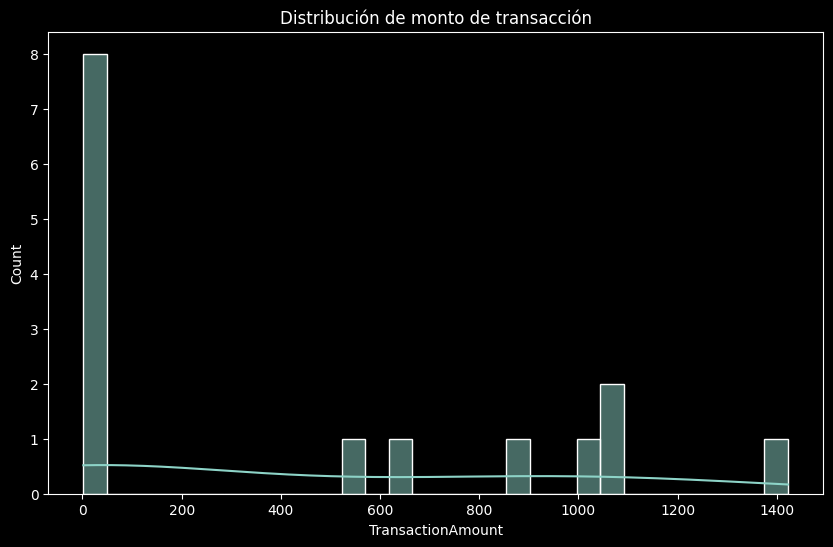

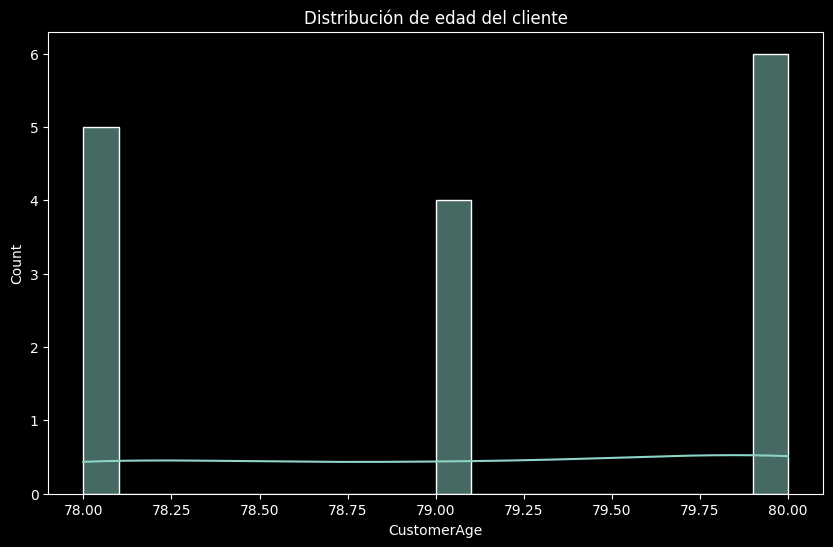

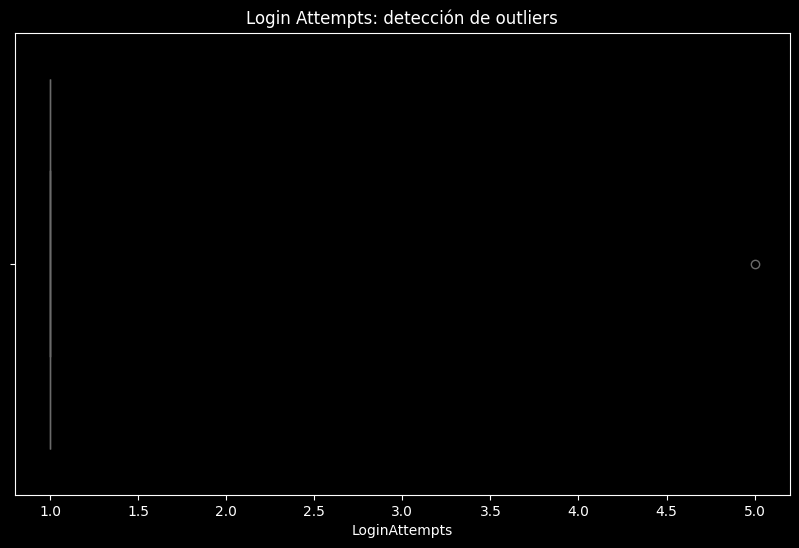

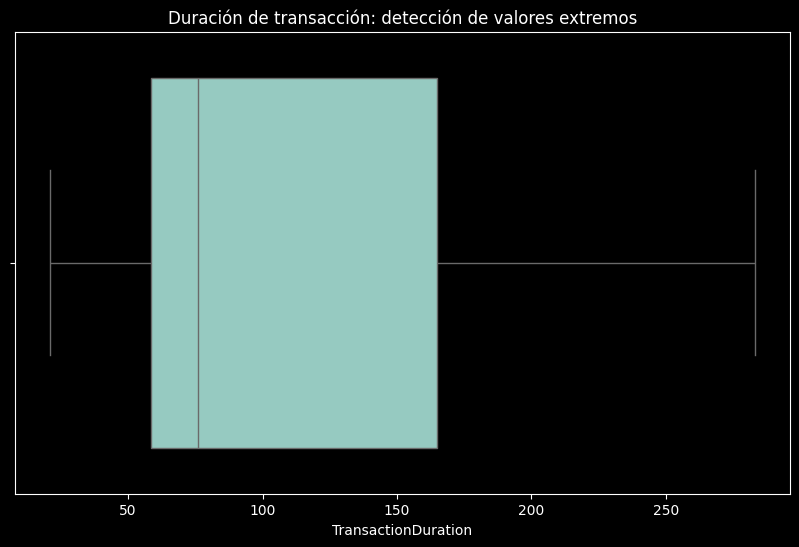

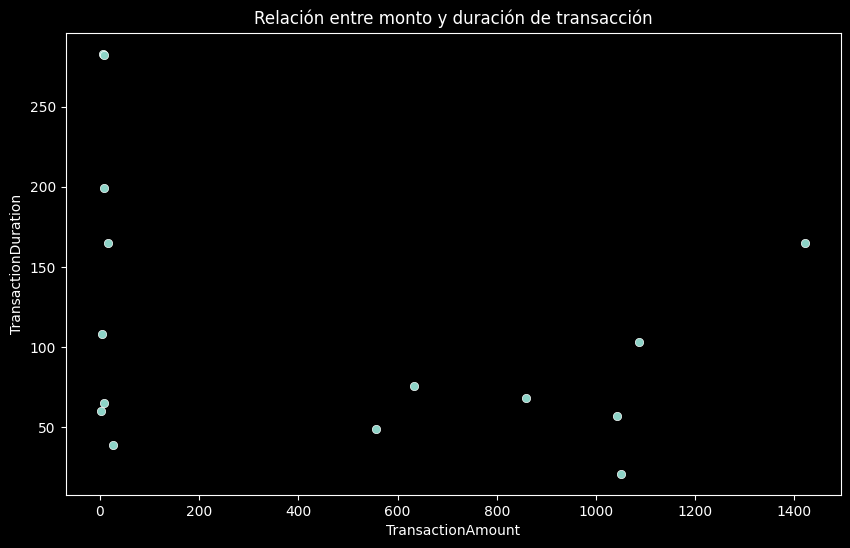

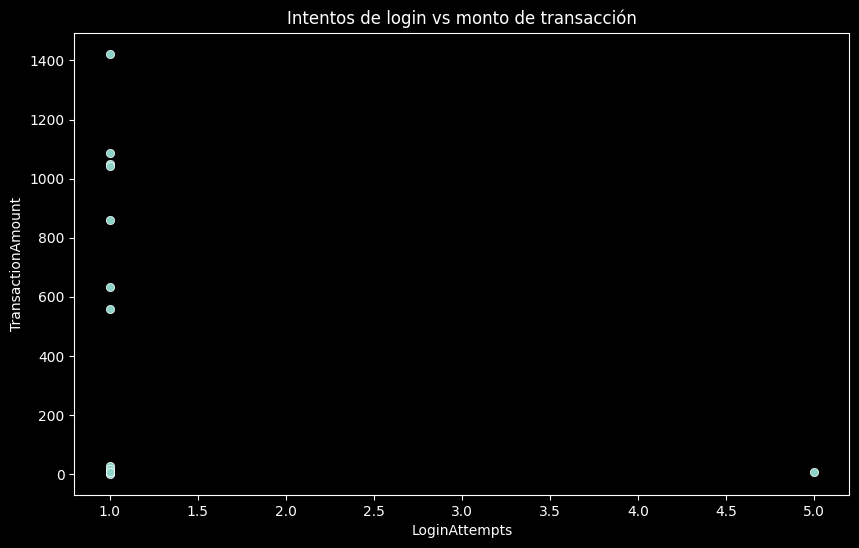

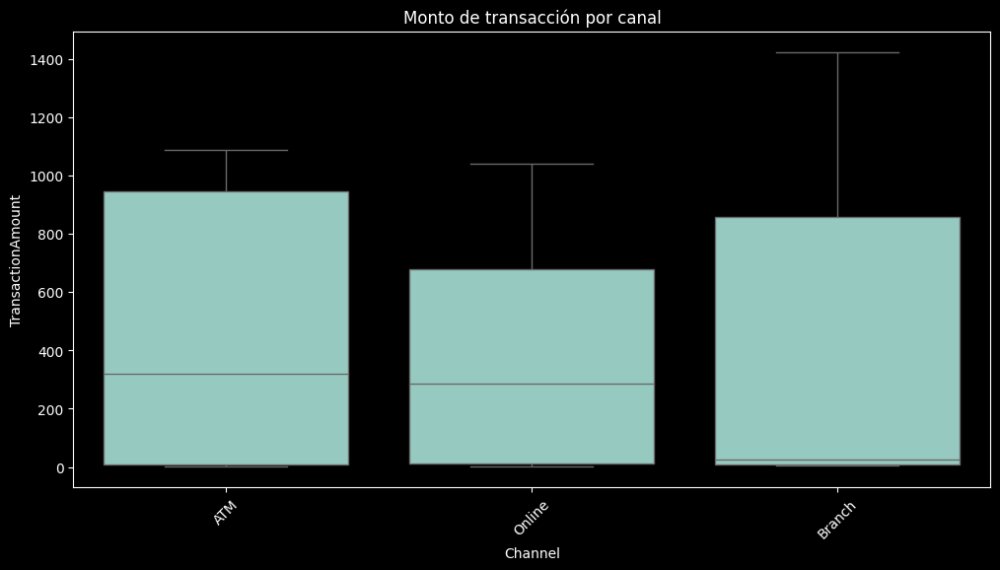

In [191]:
plt.figure(figsize=(10, 6))
sns.histplot(fraudes_comunes_isoforest_kmeans['TransactionAmount'], bins=30, kde=True)
plt.title('Distribución de monto de transacción')
plt.show()

# 2. Edad del cliente
plt.figure(figsize=(10, 6))
sns.histplot(fraudes_comunes_isoforest_kmeans['CustomerAge'], bins=20, kde=True)
plt.title('Distribución de edad del cliente')
plt.show()

# 3. Login attempts: detectar intentos inusuales
plt.figure(figsize=(10, 6))
sns.boxplot(x=fraudes_comunes_isoforest_kmeans['LoginAttempts'])
plt.title('Login Attempts: detección de outliers')
plt.show()

# 4. Duración de la transacción
plt.figure(figsize=(10, 6))
sns.boxplot(x=fraudes_comunes_isoforest_kmeans['TransactionDuration'])
plt.title('Duración de transacción: detección de valores extremos')
plt.show()

# 5. Relación entre monto y duración
plt.figure(figsize=(10, 6))
sns.scatterplot(data=fraudes_comunes_isoforest_kmeans, x='TransactionAmount', y='TransactionDuration')
plt.title('Relación entre monto y duración de transacción')
plt.show()

# 6. Comparar intentos de login vs monto de transacción
plt.figure(figsize=(10, 6))
sns.scatterplot(data=fraudes_comunes_isoforest_kmeans, x='LoginAttempts', y='TransactionAmount')
plt.title('Intentos de login vs monto de transacción')
plt.show()

# 7. Canal de transacción: ¿hay canales con montos atípicos?
plt.figure(figsize=(12, 6))
sns.boxplot(data=fraudes_comunes_isoforest_kmeans, x='Channel', y='TransactionAmount')
plt.title('Monto de transacción por canal')
plt.xticks(rotation=45)
plt.show()

##Anomalias detectadas por Isolation Forest y DBSCAN

In [192]:
# Comparar fraudes detectados por Isolation Forest y DBSCAN
fraudes_comunes_isoforest_dbscan = pd.merge(
    resultados_isolationforest_TA_VS_CA,
    resultados_dbscan_TA_VS_CA,
    how='inner',
    on='TransactionID'
)

print(f"Fraudes detectados por ambos modelos (Isolation Forest y DBSCAN): {len(fraudes_comunes_isoforest_dbscan)}")
fraudes_comunes_isoforest_dbscan.head()


Fraudes detectados por ambos modelos (Isolation Forest y DBSCAN): 26


,TransactionID,AccountID_x,TransactionAmount_x,TransactionDate_x,TransactionType_x,Location_x,DeviceID_x,IP Address_x,MerchantID_x,Channel_x,...,TransactionAmount_boxcox_y,prediccion_TA_vs_AB_y,Distancia_Centroide_y,prediccion_CA_VS_TA_y,distancia_centroide_CA_VS_TA_y,cluster_TA_AB_CA_y,DBSCAN_Cluster_TA_VS_CA_y,DBSCAN_Cluster_Etiqueta_y,DBSCAN_Cluster_TA_VS_CA_OPT_y,DBSCAN_Cluster_Etiqueta_OPT_y
0,TX000116,AC00468,2.50,2023-07-21 16:43:11,Debit,San Diego,D000673,44.73.3.217,M042,Online,...,-2.327577,0,1031.425614,0,13.352903,0,0,Normal,-1,Fraude
1,TX000142,AC00114,1049.92,2023-10-23 16:50:33,Debit,Detroit,D000522,121.67.144.20,M052,ATM,...,1.835256,1,821.964577,0,19.933666,4,0,Normal,-1,Fraude
2,TX000187,AC00099,1041.88,2023-09-06 16:44:02,Debit,Jacksonville,D000208,32.240.176.64,M032,Online,...,1.824847,2,1097.070890,0,17.942343,4,0,Normal,-1,Fraude
3,TX000191,AC00396,1422.55,2023-07-10 17:49:18,Debit,Washington,D000569,188.124.181.12,M072,Branch,...,2.262707,2,1148.951618,0,18.985166,4,-1,Fraude,-1,Fraude
4,TX000341,AC00107,1830.00,2023-03-01 16:31:58,Debit,San Antonio,D000436,62.27.235.199,M082,Online,...,2.642217,1,1019.815931,0,5.805668,4,-1,Fraude,-1,Fraude


In [193]:

fraudes_comunes_isoforest_dbscan = fraudes_comunes_isoforest_dbscan.rename(columns={
    'TransactionAmount_x': 'TransactionAmount',
    'CustomerAge_x': 'CustomerAge',
    'LoginAttempts_x': 'LoginAttempts',
    'TransactionDuration_x': 'TransactionDuration',
    'Channel_x': 'Channel',
})

In [194]:
fraudes_comunes_isoforest_dbscan.describe()

,TransactionAmount,TransactionDate_x,CustomerAge,TransactionDuration,LoginAttempts,AccountBalance_x,PreviousTransactionDate_x,TransactionAmount_boxcox_x,prediccion_TA_vs_AB_x,Distancia_Centroide_x,...,AccountBalance_y,PreviousTransactionDate_y,TransactionAmount_boxcox_y,prediccion_TA_vs_AB_y,Distancia_Centroide_y,prediccion_CA_VS_TA_y,distancia_centroide_CA_VS_TA_y,cluster_TA_AB_CA_y,DBSCAN_Cluster_TA_VS_CA_y,DBSCAN_Cluster_TA_VS_CA_OPT_y
count,26.000000,26,26.000000,26.000000,26.000000,26.000000,26,26.000000,26.000000,26.000000,...,26.000000,26,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.0
mean,569.328462,2023-08-06 01:31:31.153846016,52.884615,120.692308,1.153846,5962.711923,2024-11-04 08:09:54.307692032,-0.623492,1.653846,838.083811,...,5962.711923,2024-11-04 08:09:54.307692032,-0.623492,1.653846,838.083811,0.346154,10.800931,2.961538,-0.615385,-1.0
min,0.260000,2023-01-19 17:24:30,18.000000,21.000000,1.000000,1357.220000,2024-11-04 08:06:44,-2.629493,0.000000,99.404986,...,1357.220000,2024-11-04 08:06:44,-2.629493,0.000000,99.404986,0.000000,2.964365,0.000000,-1.000000,-1.0
25%,1.157500,2023-06-16 10:46:07,35.250000,69.500000,1.000000,2214.580000,2024-11-04 08:08:55.500000,-2.480027,1.000000,490.522432,...,2214.580000,2024-11-04 08:08:55.500000,-2.480027,1.000000,490.522432,0.000000,5.728850,1.000000,-1.000000,-1.0
50%,2.265000,2023-08-29 17:01:34,53.500000,136.500000,1.000000,5679.205000,2024-11-04 08:10:03,-2.351248,1.500000,800.396697,...,5679.205000,2024-11-04 08:10:03,-2.351248,1.500000,800.396697,0.000000,9.866218,4.000000,-1.000000,-1.0
75%,1148.170000,2023-10-20 12:27:32.750000128,72.000000,164.000000,1.000000,8393.005000,2024-11-04 08:10:58.750000128,1.957353,2.000000,1146.509128,...,8393.005000,2024-11-04 08:10:58.750000128,1.957353,2.000000,1146.509128,1.000000,15.134756,5.000000,0.000000,-1.0
max,1919.110000,2024-01-01 16:45:56,80.000000,238.000000,5.000000,13913.920000,2024-11-04 08:12:22,2.716535,4.000000,1678.685209,...,13913.920000,2024-11-04 08:12:22,2.716535,4.000000,1678.685209,1.000000,19.986848,5.000000,0.000000,-1.0
std,764.003746,NaN,20.715843,57.775960,0.784465,3943.573240,NaN,2.359011,1.198075,466.278042,...,3943.573240,NaN,2.359011,1.198075,466.278042,0.485165,5.650453,1.969381,0.496139,0.0


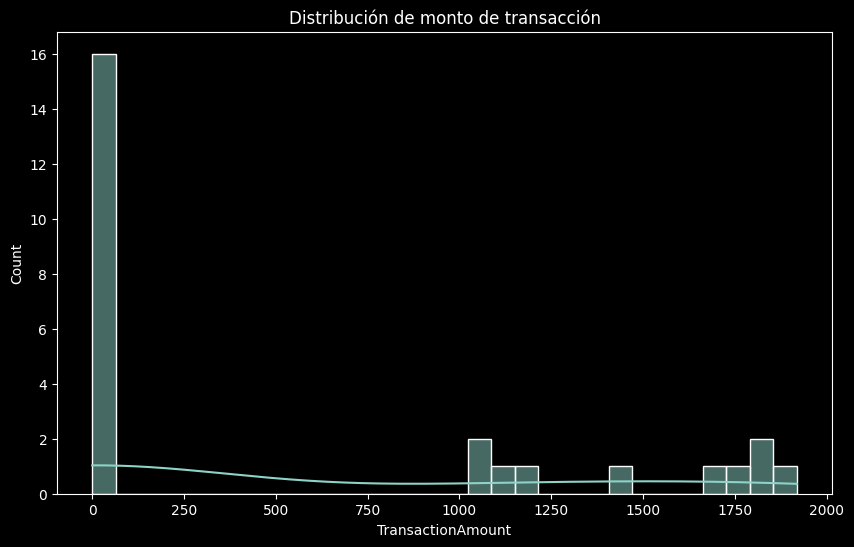

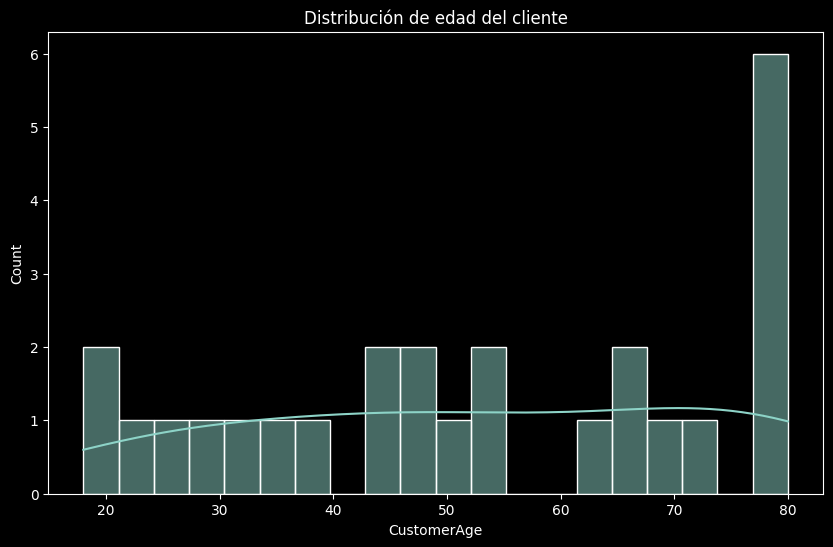

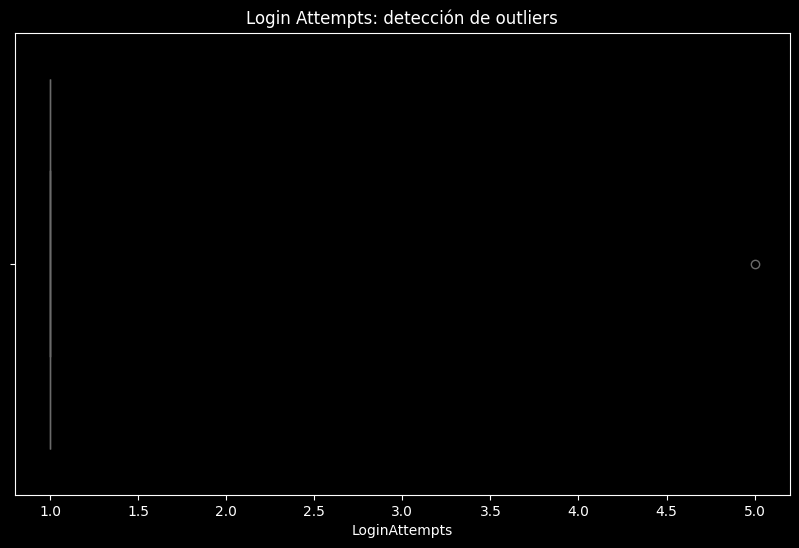

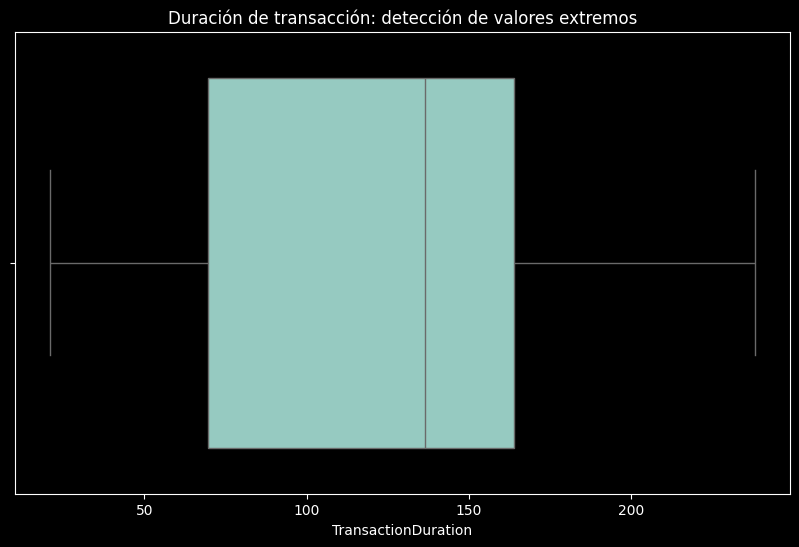

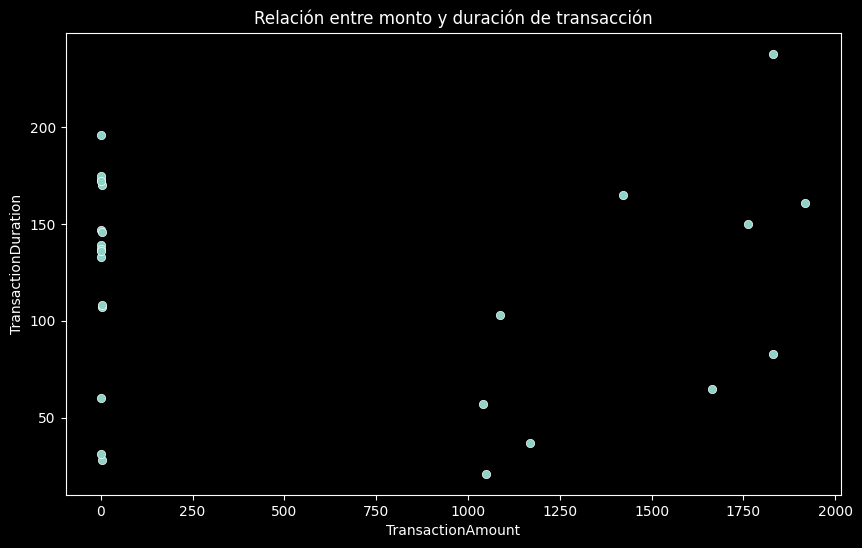

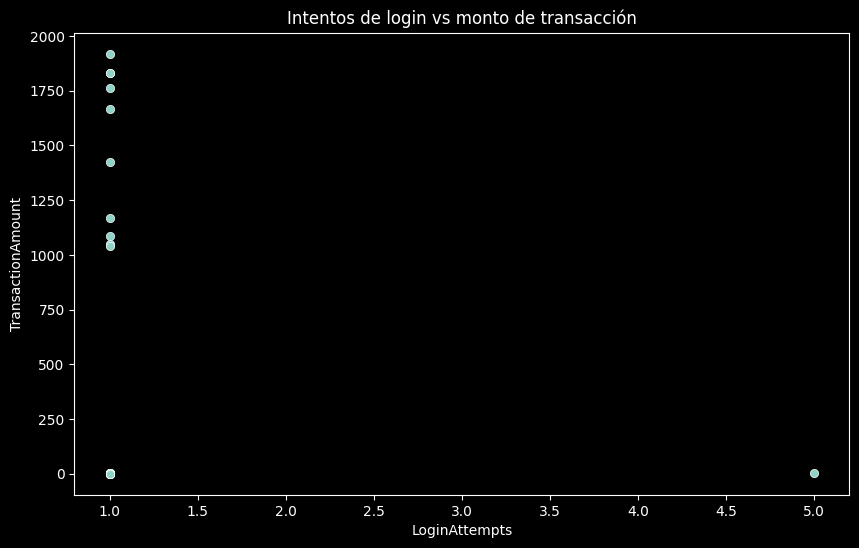

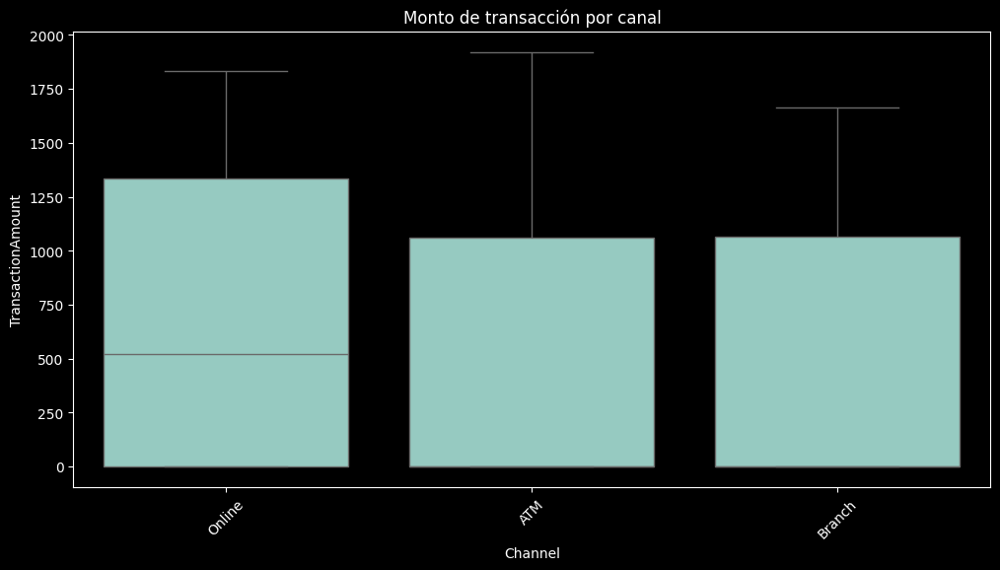

In [195]:
plt.figure(figsize=(10, 6))
sns.histplot(fraudes_comunes_isoforest_dbscan['TransactionAmount'], bins=30, kde=True)
plt.title('Distribución de monto de transacción')
plt.show()

# 2. Edad del cliente
plt.figure(figsize=(10, 6))
sns.histplot(fraudes_comunes_isoforest_dbscan['CustomerAge'], bins=20, kde=True)
plt.title('Distribución de edad del cliente')
plt.show()

# 3. Login attempts: detectar intentos inusuales
plt.figure(figsize=(10, 6))
sns.boxplot(x=fraudes_comunes_isoforest_dbscan['LoginAttempts'])
plt.title('Login Attempts: detección de outliers')
plt.show()

# 4. Duración de la transacción
plt.figure(figsize=(10, 6))
sns.boxplot(x=fraudes_comunes_isoforest_dbscan['TransactionDuration'])
plt.title('Duración de transacción: detección de valores extremos')
plt.show()

# 5. Relación entre monto y duración
plt.figure(figsize=(10, 6))
sns.scatterplot(data=fraudes_comunes_isoforest_dbscan, x='TransactionAmount', y='TransactionDuration')
plt.title('Relación entre monto y duración de transacción')
plt.show()

# 6. Comparar intentos de login vs monto de transacción
plt.figure(figsize=(10, 6))
sns.scatterplot(data=fraudes_comunes_isoforest_dbscan, x='LoginAttempts', y='TransactionAmount')
plt.title('Intentos de login vs monto de transacción')
plt.show()

# 7. Canal de transacción: ¿hay canales con montos atípicos?
plt.figure(figsize=(12, 6))
sns.boxplot(data=fraudes_comunes_isoforest_dbscan, x='Channel', y='TransactionAmount')
plt.title('Monto de transacción por canal')
plt.xticks(rotation=45)
plt.show()

##Fraudes detectados por los 3 modelos

In [196]:
# Comparar fraudes detectados por Isolation Forest, KMeans y DBSCAN
fraudes_comunes_tres_modelos = pd.merge(
    fraudes_comunes_isoforest_kmeans,  # Lo que ya tenías de IsoForest + KMeans
    resultados_dbscan_TA_VS_CA,         # Ahora también con DBSCAN
    how='inner',
    on='TransactionID'
)

print(f"Fraudes detectados por los tres modelos (Isolation Forest, KMeans y DBSCAN): {len(fraudes_comunes_tres_modelos)}")
fraudes_comunes_tres_modelos.head(6)


Fraudes detectados por los tres modelos (Isolation Forest, KMeans y DBSCAN): 6


,TransactionID,AccountID_x,TransactionAmount_x,TransactionDate_x,TransactionType_x,Location_x,DeviceID_x,IP Address_x,MerchantID_x,Channel_x,...,TransactionAmount_boxcox,prediccion_TA_vs_AB,Distancia_Centroide,prediccion_CA_VS_TA,distancia_centroide_CA_VS_TA,cluster_TA_AB_CA_y,DBSCAN_Cluster_TA_VS_CA_y,DBSCAN_Cluster_Etiqueta_y,DBSCAN_Cluster_TA_VS_CA_OPT_y,DBSCAN_Cluster_Etiqueta_OPT_y
0,TX000142,AC00114,1049.92,2023-10-23 16:50:33,Debit,Detroit,D000522,121.67.144.20,M052,ATM,...,1.835256,1,821.964577,0,19.933666,4,0,Normal,-1,Fraude
1,TX000187,AC00099,1041.88,2023-09-06 16:44:02,Debit,Jacksonville,D000208,32.240.176.64,M032,Online,...,1.824847,2,1097.070890,0,17.942343,4,0,Normal,-1,Fraude
2,TX000191,AC00396,1422.55,2023-07-10 17:49:18,Debit,Washington,D000569,188.124.181.12,M072,Branch,...,2.262707,2,1148.951618,0,18.985166,4,-1,Fraude,-1,Fraude
3,TX000614,AC00084,3.44,2023-01-19 17:24:30,Debit,Fort Worth,D000389,45.64.74.86,M004,ATM,...,-2.245719,2,738.063970,0,17.983109,5,0,Normal,-1,Fraude
4,TX001771,AC00022,1.82,2023-04-13 17:35:38,Debit,San Francisco,D000652,146.250.144.172,M009,Online,...,-2.397880,2,1251.881466,0,19.986848,5,-1,Fraude,-1,Fraude
5,TX001973,AC00480,1087.90,2023-03-27 18:06:17,Debit,Boston,D000549,112.86.148.212,M053,ATM,...,1.883629,1,1297.623935,0,17.948517,4,0,Normal,-1,Fraude


In [197]:
fraudes_comunes_tres_modelos.describe()

,TransactionAmount_x,TransactionDate_x,CustomerAge_x,TransactionDuration_x,LoginAttempts_x,AccountBalance_x,PreviousTransactionDate_x,TransactionAmount_boxcox_x,prediccion_TA_vs_AB_x,Distancia_Centroide_x,...,AccountBalance,PreviousTransactionDate,TransactionAmount_boxcox,prediccion_TA_vs_AB,Distancia_Centroide,prediccion_CA_VS_TA,distancia_centroide_CA_VS_TA,cluster_TA_AB_CA_y,DBSCAN_Cluster_TA_VS_CA_y,DBSCAN_Cluster_TA_VS_CA_OPT_y
count,6.000000,6,6.000000,6.000000,6.0,6.000000,6,6.000000,6.000000,6.000000,...,6.000000,6,6.000000,6.000000,6.000000,6.0,6.000000,6.000000,6.000000,6.0
mean,767.918333,2023-06-07 01:25:02.999999744,78.833333,85.666667,1.0,4847.433333,2024-11-04 08:09:38.333333504,0.527140,1.666667,1059.259409,...,4847.433333,2024-11-04 08:09:38.333333504,0.527140,1.666667,1059.259409,0.0,18.796608,4.333333,-0.333333,-1.0
min,1.820000,2023-01-19 17:24:30,78.000000,21.000000,1.0,2037.850000,2024-11-04 08:06:44,-2.397880,1.000000,738.063970,...,2037.850000,2024-11-04 08:06:44,-2.397880,1.000000,738.063970,0.0,17.942343,4.000000,-1.000000,-1.0
25%,263.050000,2023-03-31 23:58:37.249999872,78.000000,57.750000,1.0,3277.980000,2024-11-04 08:07:27,-1.228077,1.250000,890.741155,...,3277.980000,2024-11-04 08:07:27,-1.228077,1.250000,890.741155,0.0,17.957165,4.000000,-0.750000,-1.0
50%,1045.900000,2023-05-27 17:42:28,78.500000,81.500000,1.0,5622.855000,2024-11-04 08:09:56,1.830052,2.000000,1123.011254,...,5622.855000,2024-11-04 08:09:56,1.830052,2.000000,1123.011254,0.0,18.484137,4.000000,0.000000,-1.0
75%,1078.405000,2023-08-23 05:00:21,79.750000,106.750000,1.0,5713.230000,2024-11-04 08:11:41.500000,1.871536,2.000000,1226.149004,...,5713.230000,2024-11-04 08:11:41.500000,1.871536,2.000000,1226.149004,0.0,19.696541,4.750000,0.000000,-1.0
max,1422.550000,2023-10-23 16:50:33,80.000000,165.000000,1.0,7561.330000,2024-11-04 08:12:20,2.262707,2.000000,1297.623935,...,7561.330000,2024-11-04 08:12:20,2.262707,2.000000,1297.623935,0.0,19.986848,5.000000,0.000000,-1.0
std,609.400459,NaN,0.983192,50.508085,0.0,2130.083445,NaN,2.213231,0.516398,229.290494,...,2130.083445,NaN,2.213231,0.516398,229.290494,0.0,0.985488,0.516398,0.516398,0.0


In [198]:
df_completo[(df_completo['TransactionAmount'] > 900) & (df_completo['CustomerAge'] > 70)]


,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,...,Distancia_Centroide,prediccion_CA_VS_TA,distancia_centroide_CA_VS_TA,cluster_TA_AB_CA,DBSCAN_Cluster_TA_VS_CA,DBSCAN_Cluster_Etiqueta,DBSCAN_Cluster_TA_VS_CA_OPT,DBSCAN_Cluster_Etiqueta_OPT,IF_Anomalia,IF_Etiqueta
141,TX000142,AC00114,1049.92,2023-10-23 16:50:33,Debit,Detroit,D000522,121.67.144.20,M052,ATM,...,821.964577,0,19.933666,4,0,Normal,-1,Fraude,-1,Fraude
146,TX000147,AC00385,973.39,2023-08-30 17:23:20,Debit,Sacramento,D000292,202.194.199.70,M026,Branch,...,826.334353,0,16.938276,4,0,Normal,0,Normal,-1,Fraude
186,TX000187,AC00099,1041.88,2023-09-06 16:44:02,Debit,Jacksonville,D000208,32.240.176.64,M032,Online,...,1097.070890,0,17.942343,4,0,Normal,-1,Fraude,-1,Fraude
190,TX000191,AC00396,1422.55,2023-07-10 17:49:18,Debit,Washington,D000569,188.124.181.12,M072,Branch,...,1148.951618,0,18.985166,4,-1,Fraude,-1,Fraude,-1,Fraude
1902,TX001903,AC00336,1168.26,2023-06-12 16:25:21,Credit,Philadelphia,D000697,111.78.64.133,M005,Online,...,169.863600,0,13.002835,4,-1,Fraude,-1,Fraude,-1,Fraude
1972,TX001973,AC00480,1087.90,2023-03-27 18:06:17,Debit,Boston,D000549,112.86.148.212,M053,ATM,...,1297.623935,0,17.948517,4,0,Normal,-1,Fraude,-1,Fraude


In [199]:
fraudes_comunes_tres_modelos = fraudes_comunes_tres_modelos.rename(columns={
    'TransactionAmount_x': 'TransactionAmount',
    'CustomerAge_x': 'CustomerAge',
    'LoginAttempts_x': 'LoginAttempts',
    'TransactionDuration_x': 'TransactionDuration',
    'Channel_x': 'Channel',
})

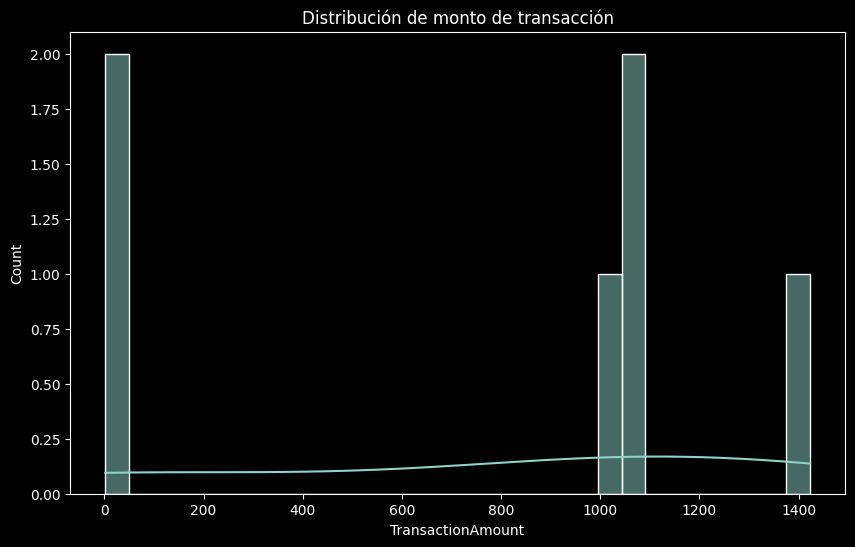

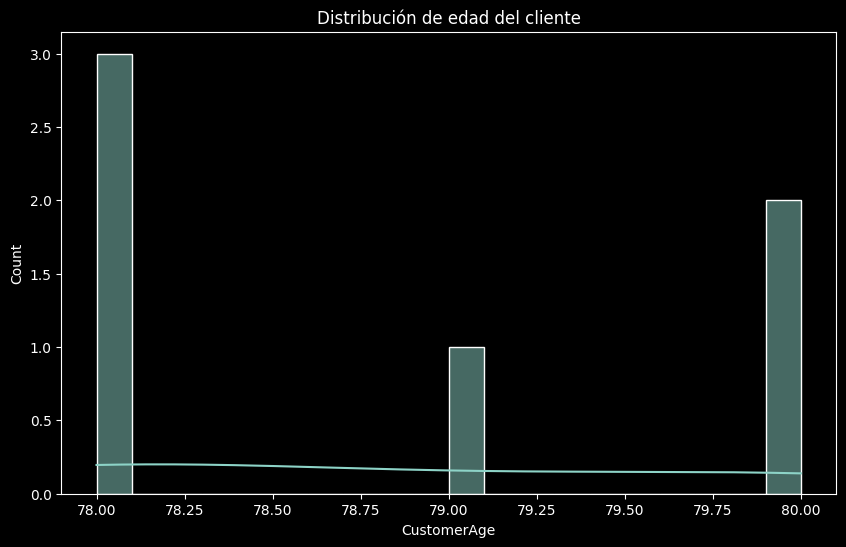

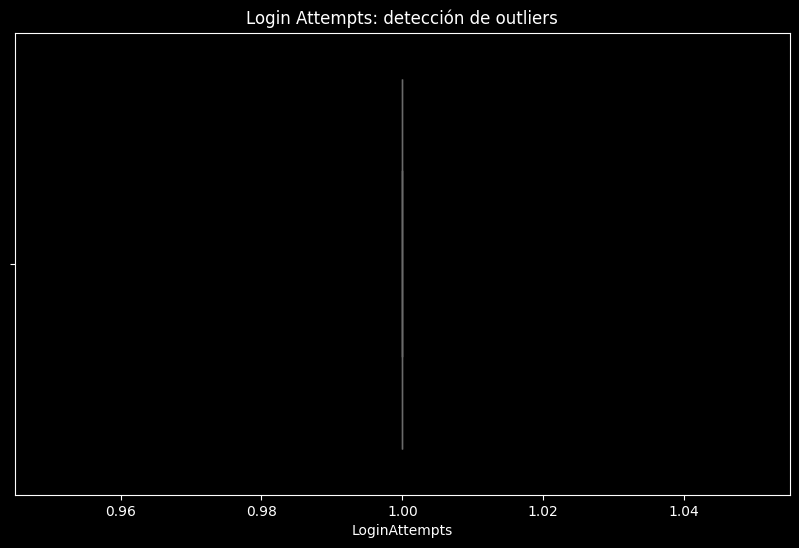

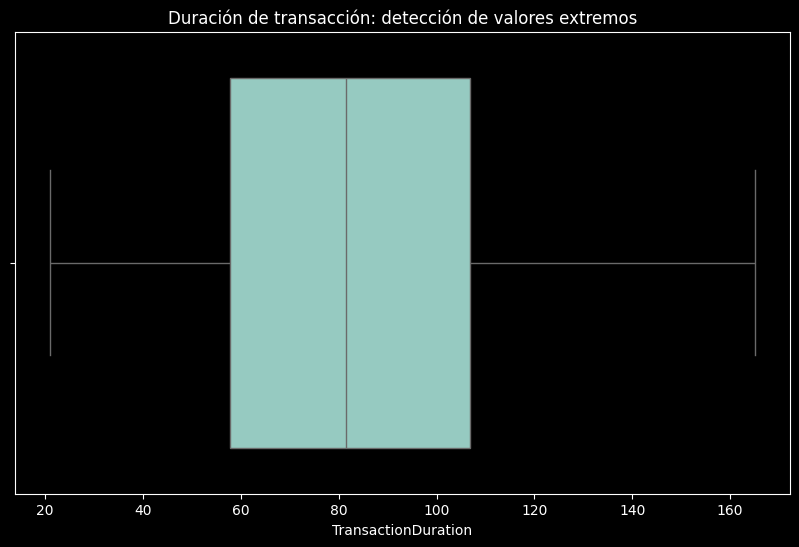

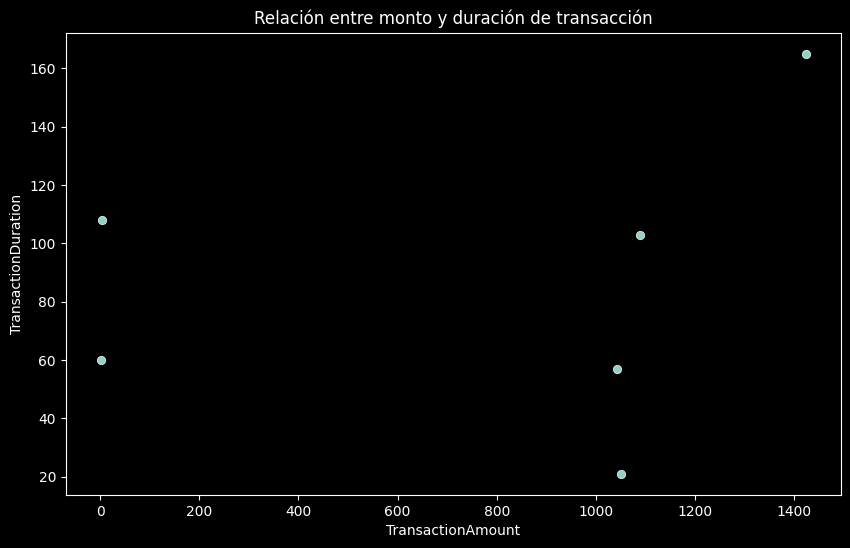

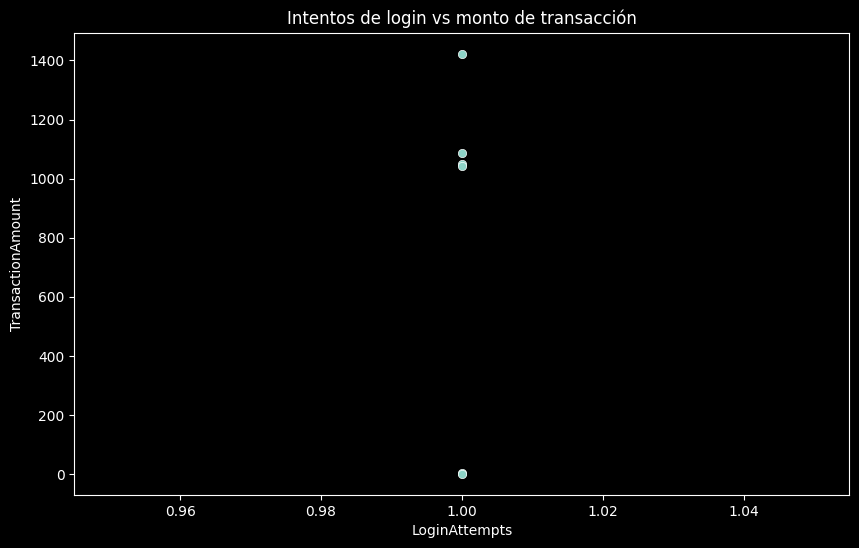

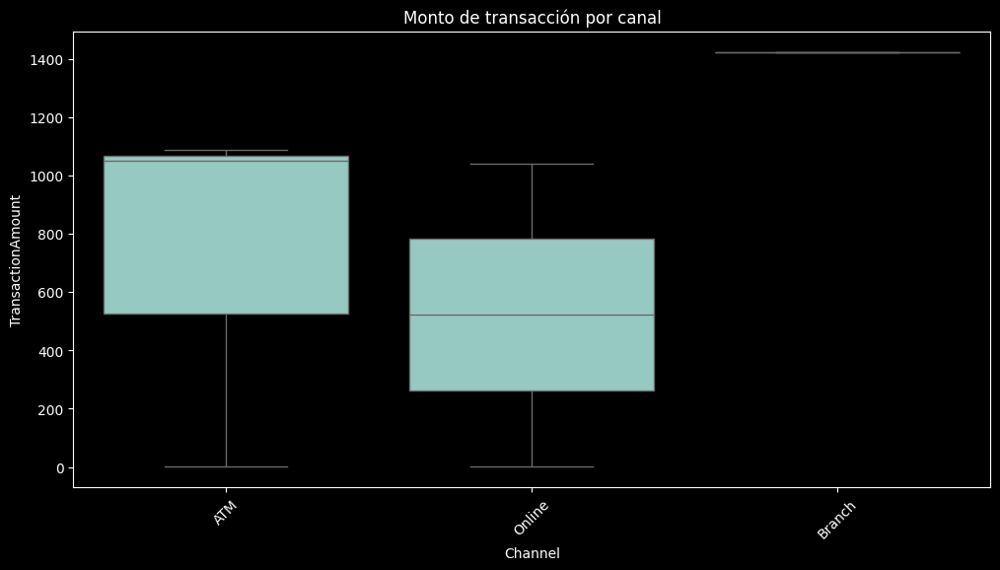

In [200]:

# 1. Distribución del monto de las transacciones
plt.figure(figsize=(10, 6))
sns.histplot(fraudes_comunes_tres_modelos['TransactionAmount'], bins=30, kde=True)
plt.title('Distribución de monto de transacción')
plt.show()

# 2. Edad del cliente
plt.figure(figsize=(10, 6))
sns.histplot(fraudes_comunes_tres_modelos['CustomerAge'], bins=20, kde=True)
plt.title('Distribución de edad del cliente')
plt.show()

# 3. Login attempts: detectar intentos inusuales
plt.figure(figsize=(10, 6))
sns.boxplot(x=fraudes_comunes_tres_modelos['LoginAttempts'])
plt.title('Login Attempts: detección de outliers')
plt.show()

# 4. Duración de la transacción
plt.figure(figsize=(10, 6))
sns.boxplot(x=fraudes_comunes_tres_modelos['TransactionDuration'])
plt.title('Duración de transacción: detección de valores extremos')
plt.show()

# 5. Relación entre monto y duración (transacciones rápidas con mucho dinero podrían ser sospechosas)
plt.figure(figsize=(10, 6))
sns.scatterplot(data=fraudes_comunes_tres_modelos, x='TransactionAmount', y='TransactionDuration')
plt.title('Relación entre monto y duración de transacción')
plt.show()

# 6. Comparar intentos de login vs monto de transacción
plt.figure(figsize=(10, 6))
sns.scatterplot(data=fraudes_comunes_tres_modelos, x='LoginAttempts', y='TransactionAmount')
plt.title('Intentos de login vs monto de transacción')
plt.show()

# 7. Canal de transacción: ¿hay canales con montos atípicos?
plt.figure(figsize=(12, 6))
sns.boxplot(data=fraudes_comunes_tres_modelos, x='Channel', y='TransactionAmount')
plt.title('Monto de transacción por canal')
plt.xticks(rotation=45)
plt.show()

#Comparativa de Anomalias detectadas por cada modelo

In [201]:
# Contar la cantidad de fraudes detectados por cada modelo
fraudes_kmeans = len(resultados_kmeans_optimizado_TA_VS_CA)
fraudes_dbscan = len(resultados_dbscan_TA_VS_CA)
fraudes_isoforest = len(resultados_isolationforest_TA_VS_CA)
fraudes_isoforest_kmeans = len(fraudes_comunes_isoforest_kmeans)
fraudes_isoforest_dbscan = len(fraudes_comunes_isoforest_dbscan)
fraudes_tres_modelos = len(fraudes_comunes_tres_modelos)

# Crear un DataFrame con los resultados
df_fraudes = pd.DataFrame({
    'Modelo': ['KMeans', 'DBSCAN', 'Isolation Forest', 'KMeans & Isolation Forest', 'Isolation Forest & DBSCAN', 'KMeans & DBSCAN', 'Todos los Modelos'],
    'Cantidad de Fraudes': [fraudes_kmeans, fraudes_dbscan, fraudes_isoforest, fraudes_isoforest_kmeans, fraudes_isoforest_dbscan, len(fraudes_comunes_isoforest_kmeans), fraudes_tres_modelos]
})

# Mostrar el cuadro
print(df_fraudes)

                      Modelo  Cantidad de Fraudes
0                     KMeans                   51
1                     DBSCAN                   47
2           Isolation Forest                   51
3  KMeans & Isolation Forest                   15
4  Isolation Forest & DBSCAN                   26
5            KMeans & DBSCAN                   15
6          Todos los Modelos                    6


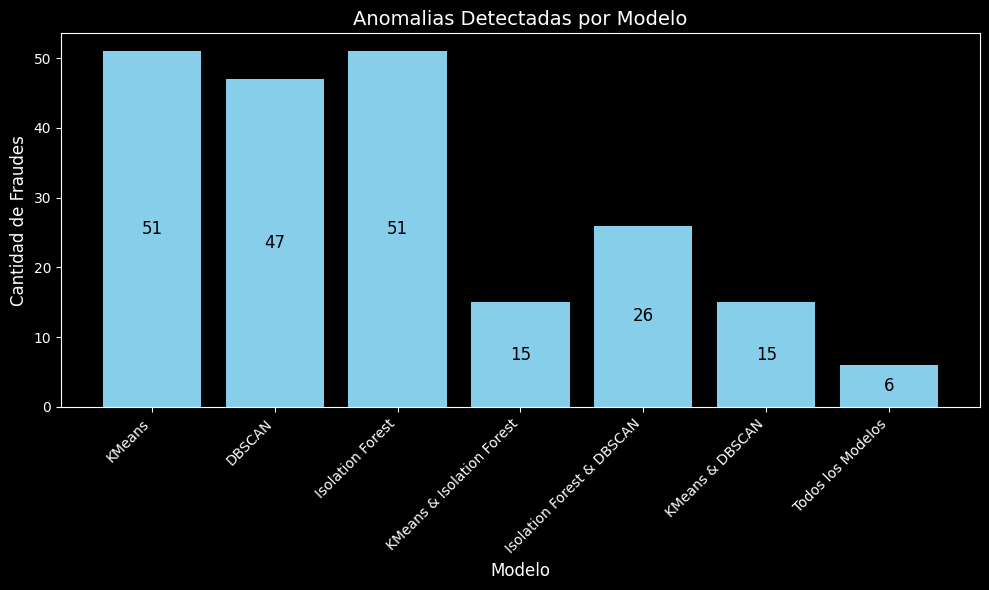

In [202]:
# Datos de fraudes detectados por cada modelo
fraudes_kmeans = len(resultados_kmeans_optimizado_TA_VS_CA)
fraudes_dbscan = len(resultados_dbscan_TA_VS_CA)
fraudes_isoforest = len(resultados_isolationforest_TA_VS_CA)
fraudes_isoforest_kmeans = len(fraudes_comunes_isoforest_kmeans)
fraudes_isoforest_dbscan = len(fraudes_comunes_isoforest_dbscan)
fraudes_tres_modelos = len(fraudes_comunes_tres_modelos)

# Crear el DataFrame con los resultados
df_fraudes = pd.DataFrame({
    'Modelo': ['KMeans', 'DBSCAN', 'Isolation Forest', 'KMeans & Isolation Forest', 'Isolation Forest & DBSCAN', 'KMeans & DBSCAN', 'Todos los Modelos'],
    'Cantidad de Fraudes': [fraudes_kmeans, fraudes_dbscan, fraudes_isoforest, fraudes_isoforest_kmeans, fraudes_isoforest_dbscan, len(fraudes_comunes_isoforest_kmeans), fraudes_tres_modelos]
})

# Crear gráfico de barras
plt.figure(figsize=(10, 6))
bars = plt.bar(df_fraudes['Modelo'], df_fraudes['Cantidad de Fraudes'], color='skyblue')

# Añadir etiquetas dentro de las barras
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval / 2,  # Colocar la etiqueta en el centro de la barra
             int(yval), ha='center', va='center', fontsize=12, color='black')

# Personalizar gráfico
plt.title('Anomalias Detectadas por Modelo', fontsize=14)
plt.xlabel('Modelo', fontsize=12)
plt.ylabel('Cantidad de Fraudes', fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Mostrar gráfico
plt.show()


#ANEXO

##PCA KMEANS

In [203]:
X = df_completo[['TransactionAmount_boxcox', 'CustomerAge', 'AccountBalance']].values

In [204]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)


In [205]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

print(f"Varianza explicada por PCA: {pca.explained_variance_ratio_.sum()*100:.2f}%")


Varianza explicada por PCA: 77.33%


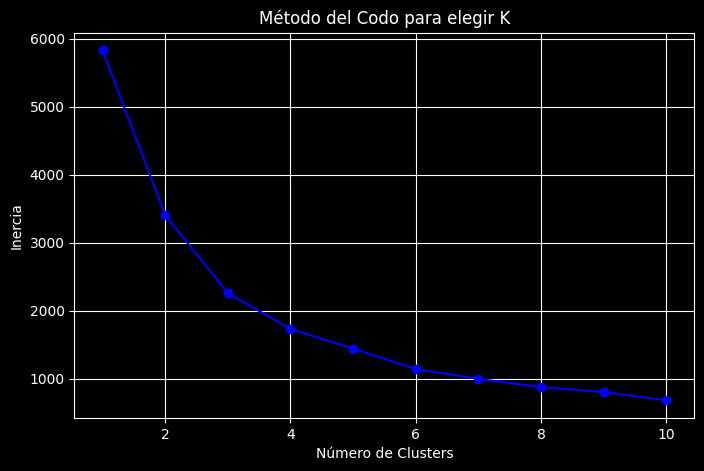

In [206]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

inertia = []
K = range(1, 11)
for k in K:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_pca)
    inertia.append(kmeans.inertia_)

plt.figure(figsize=(8, 5))
plt.plot(K, inertia, 'bo-')
plt.xlabel('Número de Clusters')
plt.ylabel('Inercia')
plt.title('Método del Codo para elegir K')
plt.grid()
plt.show()


In [207]:
kmeans = KMeans(n_clusters=6, random_state=42)
clusters = kmeans.fit_predict(X_pca)

df_completo['KMeans_PCA_Cluster'] = clusters


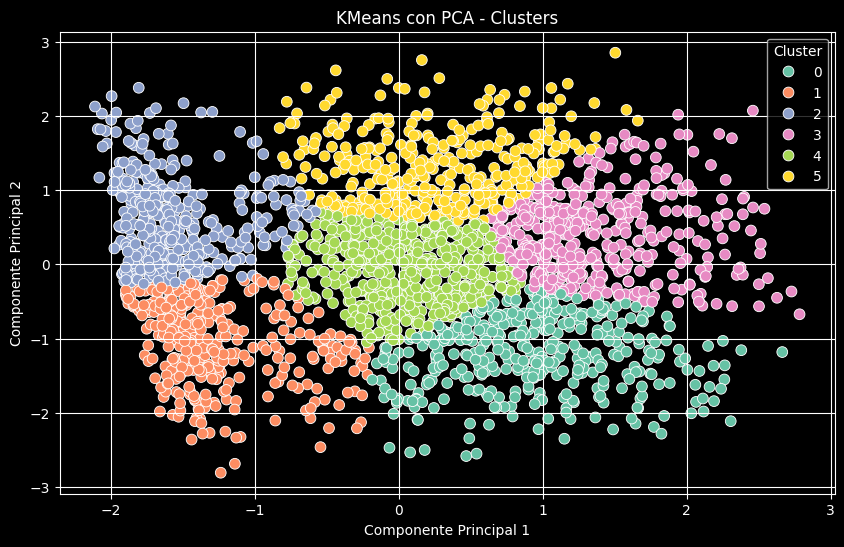

In [208]:
import seaborn as sns

plt.figure(figsize=(10, 6))
sns.scatterplot(x=X_pca[:,0], y=X_pca[:,1], hue=clusters, palette='Set2', s=60)
plt.title('KMeans con PCA - Clusters')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.legend(title='Cluster')
plt.grid(True)
plt.show()


In [209]:
from sklearn.metrics import silhouette_score

score = silhouette_score(X_pca, clusters)
print(f"Silhouette Score: {score:.4f}")


Silhouette Score: 0.3689
